# LIAR dataset - Exploratory data analysis.


## Imports


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import sys
import os
import re
import nltk
from nltk.corpus import stopwords
from nltk.util import ngrams
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

from textblob import TextBlob
from collections import Counter
from wordcloud import WordCloud
from sklearn.model_selection import train_test_split, GridSearchCV, KFold, RandomizedSearchCV, validation_curve
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC, LinearSVC
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor, plot_tree
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, RocCurveDisplay
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.naive_bayes import MultinomialNB

from sklearn.decomposition import PCA

sys.path.insert(0, r"d:\ML\Fake News Detection")
from src.data_audit import DataAudit


# Data loading

In [2]:
# os.makedirs('data', exist_ok=True)

# col_names = [
#     'id', 'label', 'statement', 'subject', 'speaker', 'job_title', 
#     'state_info', 'party_affiliation', 'barely_true', 'false', 
#     'half_true', 'mostly_true', 'pants_on_fire', 'context'
# ]

# urls = {
#     'train': 'https://raw.githubusercontent.com/tfs4/liar_dataset/master/train.tsv',
#     'valid': 'https://raw.githubusercontent.com/tfs4/liar_dataset/master/valid.tsv',
#     'test':  'https://raw.githubusercontent.com/tfs4/liar_dataset/master/test.tsv'
# }

# df_train = pd.read_csv(urls['train'], sep='\t', header=None, names=col_names)
# df_valid = pd.read_csv(urls['valid'], sep='\t', header=None, names=col_names)
# df_test  = pd.read_csv(urls['test'],  sep='\t', header=None, names=col_names)
# df = pd.concat([df_train, df_valid, df_test], ignore_index=True)

# output_path = 'data/liar_raw.tsv'
# df.to_csv(output_path, sep='\t', index=False)
#Only execute once

This would be our first look of the data.

In [3]:
PATH_TO_DATA = r"d:\ML\Fake News Detection\data\liar_raw.tsv"
data = pd.read_csv(PATH_TO_DATA, sep='\t')
data

,id,label,statement,subject,speaker,job_title,state_info,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,context
0,2635.json,false,Says the Annies List political group supports ...,abortion,dwayne-bohac,State representative,Texas,republican,0.0,1.0,0.0,0.0,0.0,a mailer
1,10540.json,half-true,When did the decline of coal start? It started...,"energy,history,job-accomplishments",scott-surovell,State delegate,Virginia,democrat,0.0,0.0,1.0,1.0,0.0,a floor speech.
2,324.json,mostly-true,"Hillary Clinton agrees with John McCain ""by vo...",foreign-policy,barack-obama,President,Illinois,democrat,70.0,71.0,160.0,163.0,9.0,Denver
3,1123.json,false,Health care reform legislation is likely to ma...,health-care,blog-posting,NaN,NaN,none,7.0,19.0,3.0,5.0,44.0,a news release
4,9028.json,half-true,The economic turnaround started at the end of ...,"economy,jobs",charlie-crist,NaN,Florida,democrat,15.0,9.0,20.0,19.0,2.0,an interview on CNN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,7334.json,half-true,Says his budget provides the highest state fun...,education,rick-scott,Governor,Florida,republican,28.0,23.0,38.0,34.0,7.0,a news conference
12787,9788.json,barely-true,Ive been here almost every day.,"civil-rights,crime,criminal-justice",jay-nixon,Governor,Missouri,democrat,2.0,0.0,0.0,1.0,0.0,"on ABC's ""This Week"""
12788,10710.json,barely-true,"In the early 1980s, Sen. Edward Kennedy secret...","bipartisanship,congress,foreign-policy,history",mackubin-thomas-owens,"senior fellow, Foreign Policy Research Institute",Rhode Island,columnist,1.0,0.0,0.0,0.0,0.0,a commentary in The Providence Journal
12789,3186.json,barely-true,Says an EPA permit languished under Strickland...,"environment,government-efficiency",john-kasich,"Governor of Ohio as of Jan. 10, 2011",Ohio,republican,9.0,8.0,10.0,18.0,3.0,a news conference


I would like to see the data types

In [4]:
data.dtypes


id                    object
label                 object
statement             object
subject               object
speaker               object
job_title             object
state_info            object
party_affiliation     object
barely_true          float64
false                float64
half_true            float64
mostly_true          float64
pants_on_fire        float64
context               object
dtype: object

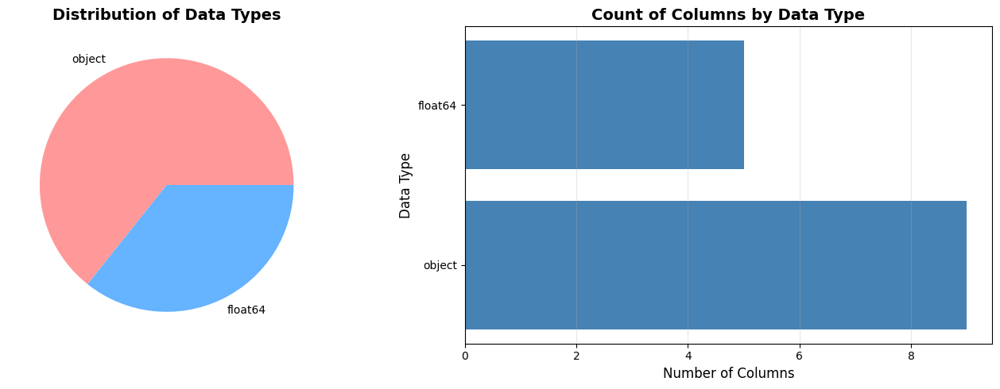

In [5]:
dtype_counts = data.dtypes.value_counts()
fig, axes = plt.subplots(1, 2, figsize=(14, 5))
colors = ['#ff9999', '#66b3ff', '#99ff99', '#ffcc99']
axes[0].pie(dtype_counts.values, labels=dtype_counts.index, colors=colors)
axes[0].set_title('Distribution of Data Types', fontsize=14, fontweight='bold')

axes[1].barh(dtype_counts.index.astype(str), dtype_counts.values, color='steelblue')
axes[1].set_xlabel('Number of Columns', fontsize=12)
axes[1].set_ylabel('Data Type', fontsize=12)
axes[1].set_title('Count of Columns by Data Type', fontsize=14, fontweight='bold')
axes[1].grid(axis='x', alpha=0.3)
plt.tight_layout()
plt.show()

Expected results, given that most of our columns are text.

We will create an initial data audit to get more information about the columns and the missing values

In [6]:
# initial_data_audit = DataAudit(data, name = "initial_data_audit.xlsx")
# initial_data_audit.create_data_audit() #no need to execute again

To start with, the id column is not benefitial for any model, because it has 100% unique rate so we should remove it.

In [7]:
data.drop(columns = ['id'], inplace = True)
data

,label,statement,subject,speaker,job_title,state_info,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,context
0,false,Says the Annies List political group supports ...,abortion,dwayne-bohac,State representative,Texas,republican,0.0,1.0,0.0,0.0,0.0,a mailer
1,half-true,When did the decline of coal start? It started...,"energy,history,job-accomplishments",scott-surovell,State delegate,Virginia,democrat,0.0,0.0,1.0,1.0,0.0,a floor speech.
2,mostly-true,"Hillary Clinton agrees with John McCain ""by vo...",foreign-policy,barack-obama,President,Illinois,democrat,70.0,71.0,160.0,163.0,9.0,Denver
3,false,Health care reform legislation is likely to ma...,health-care,blog-posting,NaN,NaN,none,7.0,19.0,3.0,5.0,44.0,a news release
4,half-true,The economic turnaround started at the end of ...,"economy,jobs",charlie-crist,NaN,Florida,democrat,15.0,9.0,20.0,19.0,2.0,an interview on CNN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,half-true,Says his budget provides the highest state fun...,education,rick-scott,Governor,Florida,republican,28.0,23.0,38.0,34.0,7.0,a news conference
12787,barely-true,Ive been here almost every day.,"civil-rights,crime,criminal-justice",jay-nixon,Governor,Missouri,democrat,2.0,0.0,0.0,1.0,0.0,"on ABC's ""This Week"""
12788,barely-true,"In the early 1980s, Sen. Edward Kennedy secret...","bipartisanship,congress,foreign-policy,history",mackubin-thomas-owens,"senior fellow, Foreign Policy Research Institute",Rhode Island,columnist,1.0,0.0,0.0,0.0,0.0,a commentary in The Providence Journal
12789,barely-true,Says an EPA permit languished under Strickland...,"environment,government-efficiency",john-kasich,"Governor of Ohio as of Jan. 10, 2011",Ohio,republican,9.0,8.0,10.0,18.0,3.0,a news conference


It would be good to see the label distribution.

Text(0.5, 1.0, 'Class Distribution')

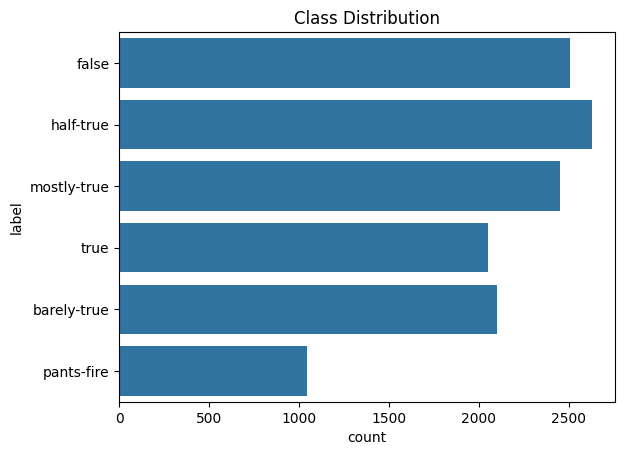

In [8]:
sns.countplot(y = 'label', data = data)
plt.title("Class Distribution")

We see relatively good distribution between different classes. Let us see missing values.

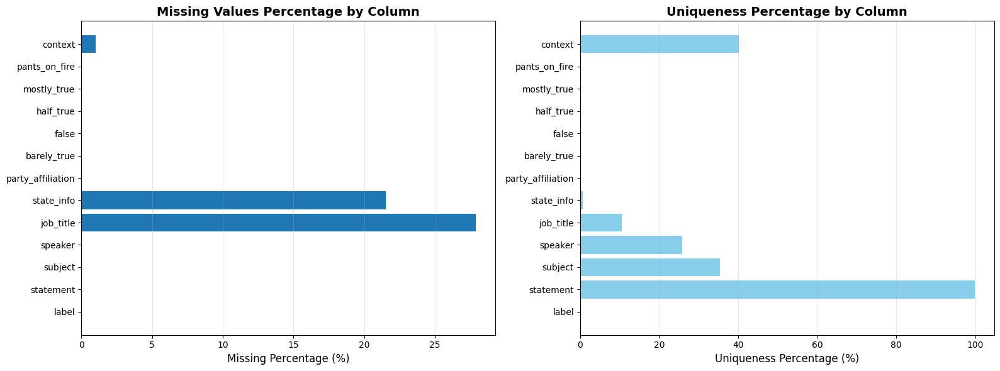

In [9]:
data_audit = DataAudit(data, name=None)  #слагаме None, защото вече е създаден
summary_df = data_audit.statistical_summary()

fig, axes = plt.subplots(1, 2, figsize=(16, 6))


axes[0].barh(summary_df.index, summary_df['missing_pct'])
axes[0].set_xlabel('Missing Percentage (%)', fontsize=12)
axes[0].set_title('Missing Values Percentage by Column', fontsize=14, fontweight='bold')
axes[0].grid(axis='x', alpha=0.3)


unique_pct = (summary_df['unique_count'] / len(data)) * 100
axes[1].barh(summary_df.index, unique_pct, color='skyblue')
axes[1].set_xlabel('Uniqueness Percentage (%)', fontsize=12)
axes[1].set_title('Uniqueness Percentage by Column', fontsize=14, fontweight='bold')
axes[1].grid(axis='x', alpha=0.3)

plt.tight_layout()
plt.show()

No missing values for the column we want to classify by. Let us encode them to show numbers

In [10]:
classes = ['pants-fire', 'false', 'barely-true', 'half-true', 'mostly-true', 'true']
label_id = {k: v for v, k in enumerate(classes)}
y = data['label'].map(label_id)
data['label'] = y
data

,label,statement,subject,speaker,job_title,state_info,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,context
0,1,Says the Annies List political group supports ...,abortion,dwayne-bohac,State representative,Texas,republican,0.0,1.0,0.0,0.0,0.0,a mailer
1,3,When did the decline of coal start? It started...,"energy,history,job-accomplishments",scott-surovell,State delegate,Virginia,democrat,0.0,0.0,1.0,1.0,0.0,a floor speech.
2,4,"Hillary Clinton agrees with John McCain ""by vo...",foreign-policy,barack-obama,President,Illinois,democrat,70.0,71.0,160.0,163.0,9.0,Denver
3,1,Health care reform legislation is likely to ma...,health-care,blog-posting,NaN,NaN,none,7.0,19.0,3.0,5.0,44.0,a news release
4,3,The economic turnaround started at the end of ...,"economy,jobs",charlie-crist,NaN,Florida,democrat,15.0,9.0,20.0,19.0,2.0,an interview on CNN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,education,rick-scott,Governor,Florida,republican,28.0,23.0,38.0,34.0,7.0,a news conference
12787,2,Ive been here almost every day.,"civil-rights,crime,criminal-justice",jay-nixon,Governor,Missouri,democrat,2.0,0.0,0.0,1.0,0.0,"on ABC's ""This Week"""
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...","bipartisanship,congress,foreign-policy,history",mackubin-thomas-owens,"senior fellow, Foreign Policy Research Institute",Rhode Island,columnist,1.0,0.0,0.0,0.0,0.0,a commentary in The Providence Journal
12789,2,Says an EPA permit languished under Strickland...,"environment,government-efficiency",john-kasich,"Governor of Ohio as of Jan. 10, 2011",Ohio,republican,9.0,8.0,10.0,18.0,3.0,a news conference


## Analyzing columns

We will start with the subject column, as we want to keep analyzing statements for last, as it could be the column we could get the most information from.

The uniqeness is expected, we should analyze how to deal with the missing values, however


In [11]:
subjects_list = (
    data['subject']
    .fillna('')
    .astype(str)
    .str.lower()
    .str.split(',')
    .apply(lambda xs: [x.strip() for x in xs if x.strip()]) 
)

data['n_subjects'] = subjects_list.apply(len)

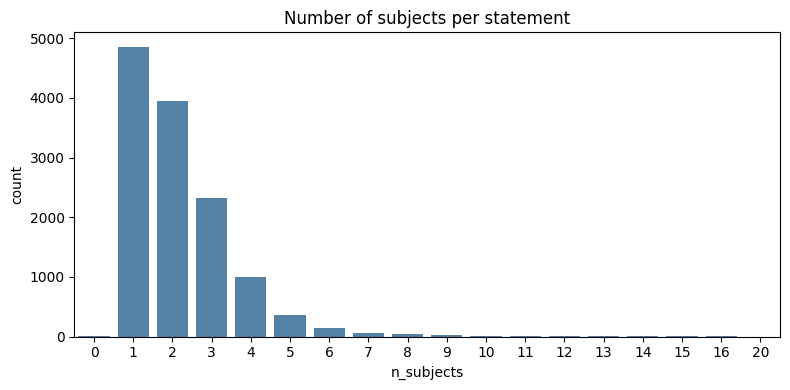

In [12]:
plt.figure(figsize=(8, 4))
sns.countplot(x='n_subjects', data=data, color='steelblue')
plt.title("Number of subjects per statement")
plt.xlabel("n_subjects")
plt.ylabel("count")
plt.tight_layout()
plt.show()

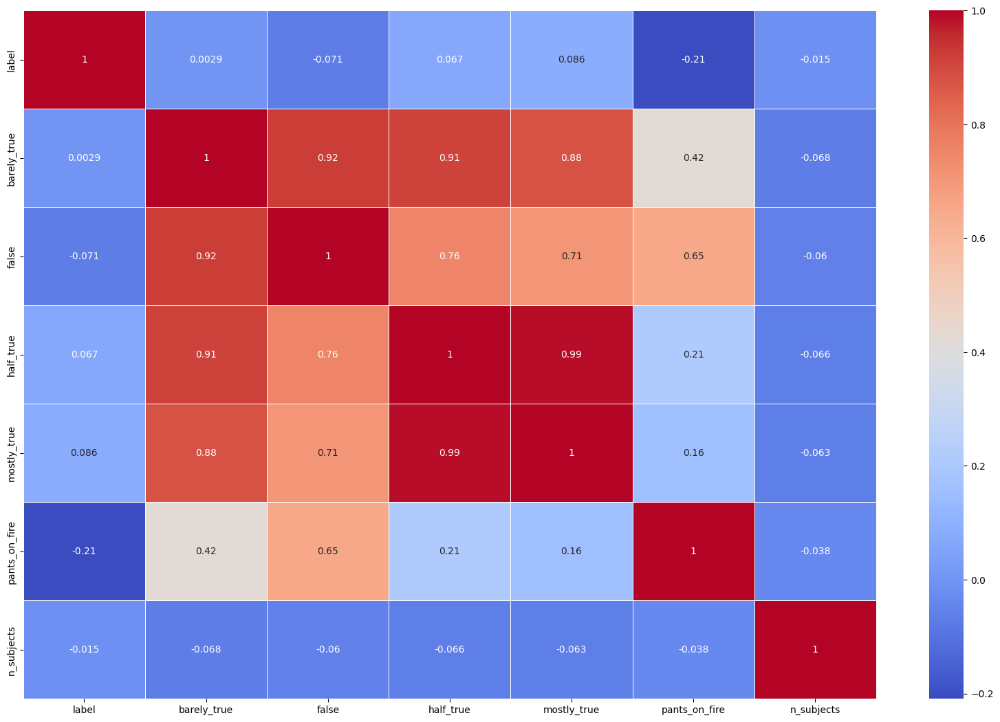

In [13]:
numeric_columns = data.select_dtypes(include=np.number).columns.tolist()
temp_data = pd.DataFrame(data[numeric_columns])
corr = temp_data.corr()
plt.figure(figsize=(20, 13))
sns.heatmap(corr, annot=True, cmap="coolwarm", linewidths=0.5)
plt.show()

we see here that the pants_on_fire column only has good correlation with label, however the other columns do not. The initial numerical columns that show the credit history, however seem to have a good correlation with themselves. Let us try a model to see feature importances.

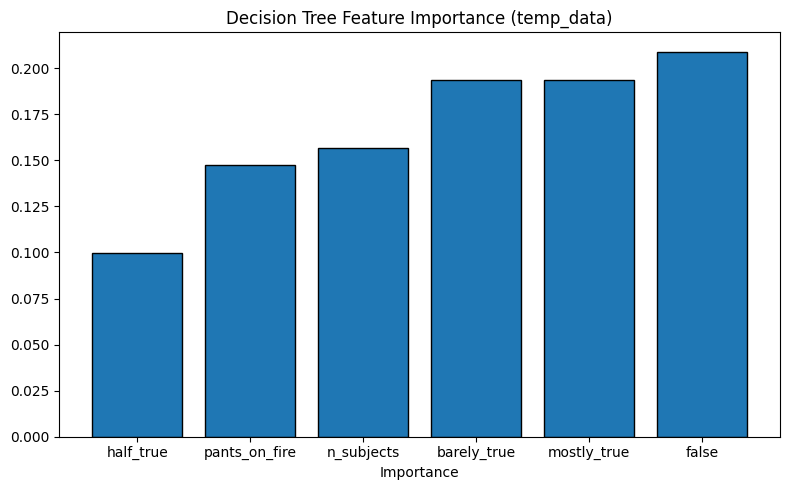

In [14]:
temp_data = pd.DataFrame(data[numeric_columns])
temp_data.dropna(inplace=True)
X = temp_data.drop(columns=['label'])
y = temp_data['label']
tree = DecisionTreeClassifier(random_state=42)
tree.fit(X, y)
imp = pd.Series(tree.feature_importances_, index=X.columns).sort_values(ascending=True)
plt.figure(figsize=(8, 5))
plt.bar(imp.index, imp.values, edgecolor='black')
plt.title('Decision Tree Feature Importance (temp_data)')
plt.xlabel('Importance')
plt.tight_layout()
plt.show()

We see that n_subjects has not the best, but relatively good importance, so we should maybe leave this column as it is

In [15]:
subjects_list

data['subject'] = data['subject'].fillna('Unknown')
unique_subjects = {}
for row in data['subject']:
    for subject in row.split(','):
        loc = subject.strip()
        if loc not in unique_subjects:
            unique_subjects[loc] = 0
        unique_subjects[loc] += 1
sorted_subjects = dict(sorted(unique_subjects.items(), key=lambda item: item[1], reverse=True))

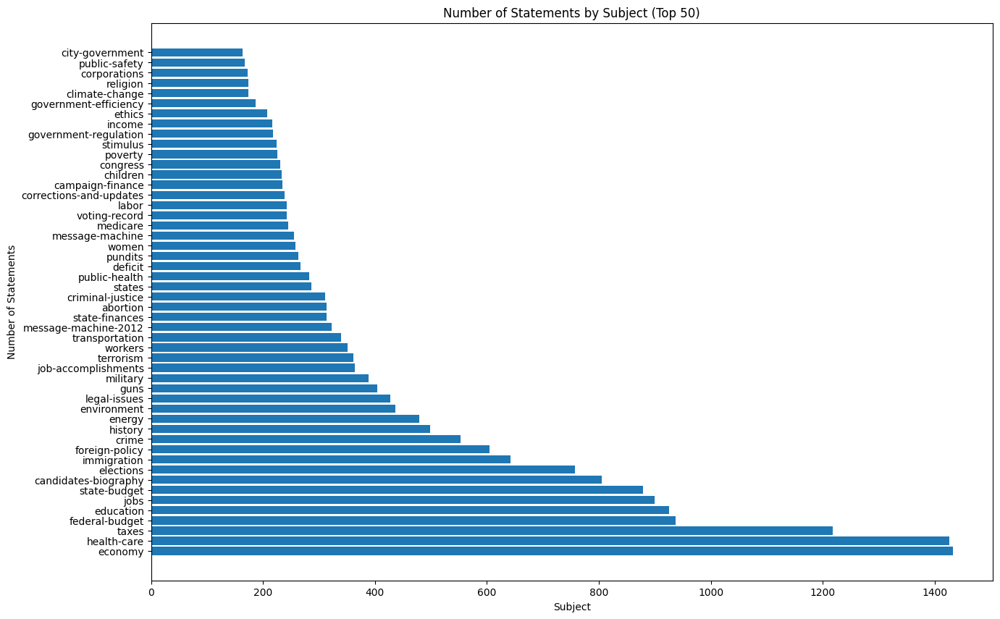

In [16]:
sorted_subjects = dict(list(sorted_subjects.items())[:50])
plt.figure(figsize=(15, 10))
subjects = list(sorted_subjects.keys())
counts = list(sorted_subjects.values())
plt.barh(sorted_subjects.keys(), sorted_subjects.values())
plt.xlabel('Subject')
plt.ylabel('Number of Statements')
plt.title('Number of Statements by Subject (Top 50)')
plt.show()

We see that 3 of the topics hold more statements than the others, let us try what happens if we use this column.

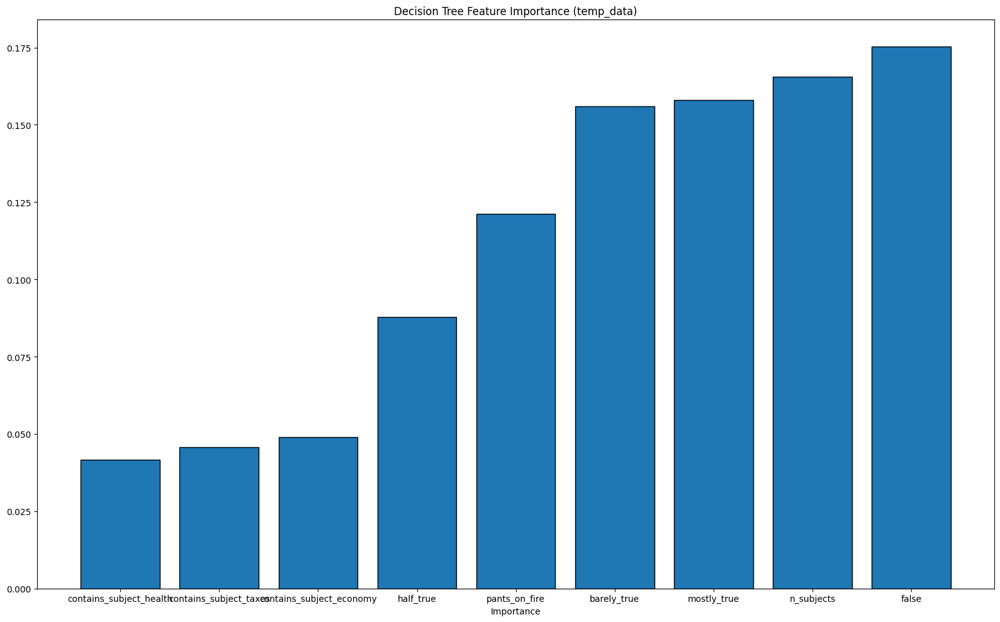

In [17]:
temp_data = pd.DataFrame(data[numeric_columns])
temp_data.dropna(inplace=True)
temp_data['contains_subject_economy'] = data['subject'].apply(lambda x: 1 if 'economy' in x.lower() else 0)
temp_data['contains_subject_health'] = data['subject'].apply(lambda x: 1 if 'health' in x.lower() else 0)
temp_data['contains_subject_taxes'] = data['subject'].apply(lambda x: 1 if 'taxes' in x.lower() else 0)
X = temp_data.drop(columns=['label'])
y = temp_data['label']
tree = DecisionTreeClassifier(random_state=42)
tree.fit(X, y)
imp = pd.Series(tree.feature_importances_, index=X.columns).sort_values(ascending=True)
plt.figure(figsize=(16, 10))
plt.bar(imp.index, imp.values, edgecolor='black')
plt.title('Decision Tree Feature Importance (temp_data)')
plt.xlabel('Importance')
plt.tight_layout()
plt.show()

Not really successful, the new columns does not contribute enough. We will try another approach, the most common words in different labeled rows.

In [18]:
def count_word_frequencies(series):
    word_counts = series.str.lower().str.split(',').explode().value_counts()
    
    return word_counts

In [19]:
subjects_0 = data[data['label'] == 0]['subject']
subjects_0
word_counts_0 = count_word_frequencies(subjects_0)
word_counts_0

subject
health-care             150
candidates-biography     95
taxes                    83
elections                75
economy                  73
                       ... 
pensions                  1
10-news-tampa-bay         1
baseball                  1
gambling                  1
abc-news-week             1
Name: count, Length: 131, dtype: int64

In [20]:
def plot_bar_chart_for_most_common_words(word_frequencies, label):
    most_common = word_frequencies.head(10)
    plt.figure(figsize=(10, 6))
    sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')
    plt.title(f'Top 10 Most Common Words in Subjects for Label {label}')
    plt.xlabel('Frequency')
    plt.ylabel('Words')
    plt.tight_layout()
    plt.show()

    

In [21]:
def create_word_cloud(word_counter, label):
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_counter)

    plt.figure(figsize=(10, 5))
    plt.title(f"Word Cloud for {label}", size = 22, color = "brown")
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')

    plt.show()

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


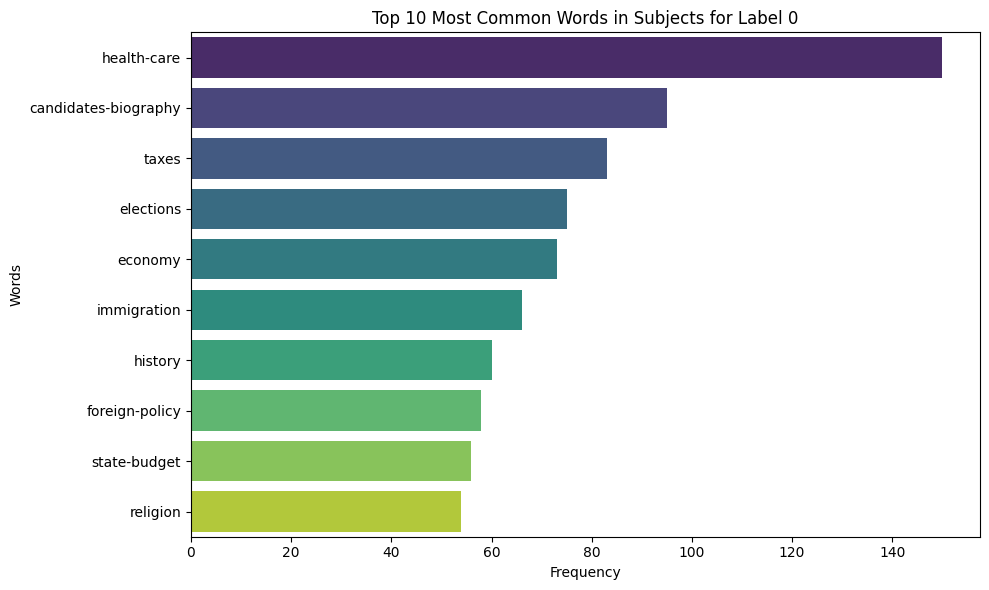

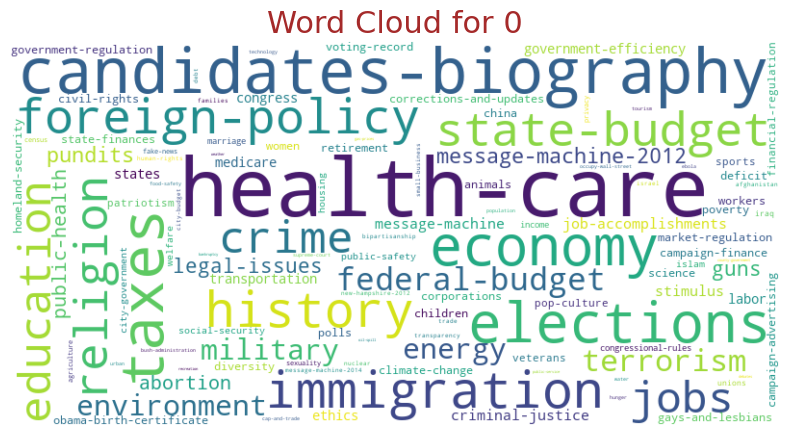

In [22]:
plot_bar_chart_for_most_common_words(word_counts_0, label=0)
create_word_cloud(word_counts_0, label=0)

We see some new columns, Let us try some of them.

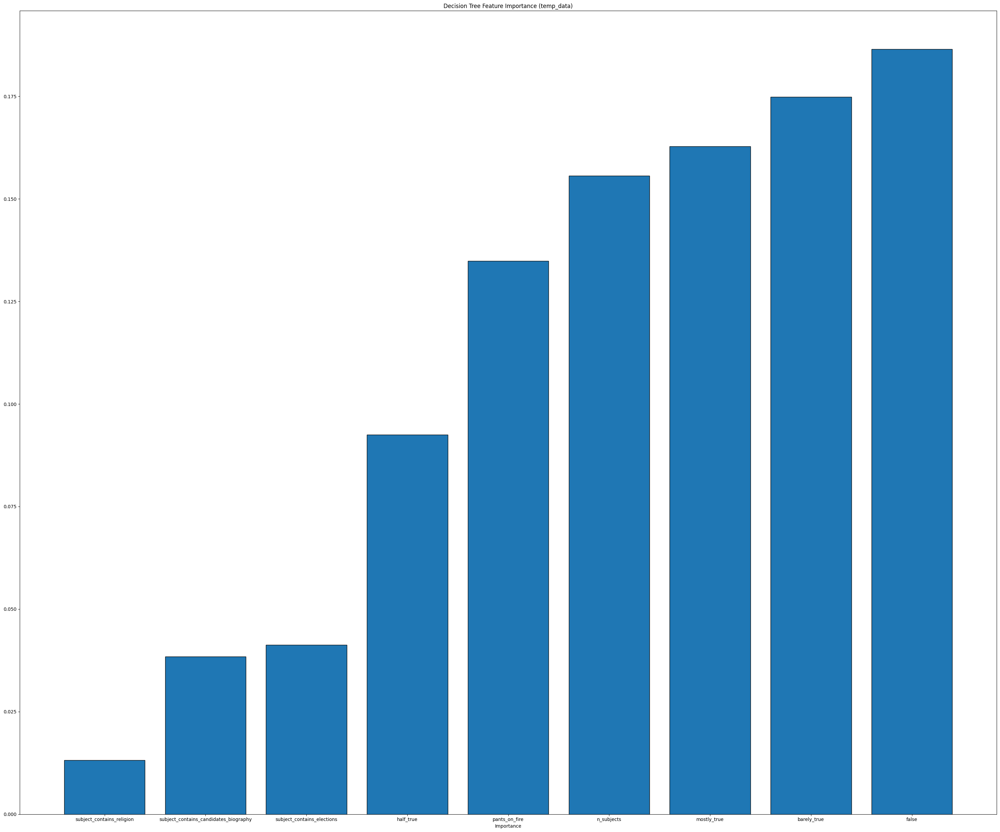

In [23]:
temp_data = pd.DataFrame(data[numeric_columns])
temp_data.dropna(inplace=True)
temp_data['subject_contains_candidates_biography'] = data['subject'].apply(lambda x: 1 if 'candidates-biography' in x.lower() else 0)
temp_data['subject_contains_elections'] = data['subject'].apply(lambda x: 1 if 'elections' in x.lower() else 0)
temp_data['subject_contains_religion'] = data['subject'].apply(lambda x: 1 if 'religion' in x.lower() else 0)
X = temp_data.drop(columns=['label'])
y = temp_data['label']
tree = DecisionTreeClassifier(random_state=42)
tree.fit(X, y)
imp = pd.Series(tree.feature_importances_, index=X.columns).sort_values(ascending=True)
plt.figure(figsize=(30, 25))
plt.bar(imp.index, imp.values, edgecolor='black')
plt.title('Decision Tree Feature Importance (temp_data)')
plt.xlabel('Importance')
plt.tight_layout()
plt.show()

They contribute, but not enough, let us see the other labels

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


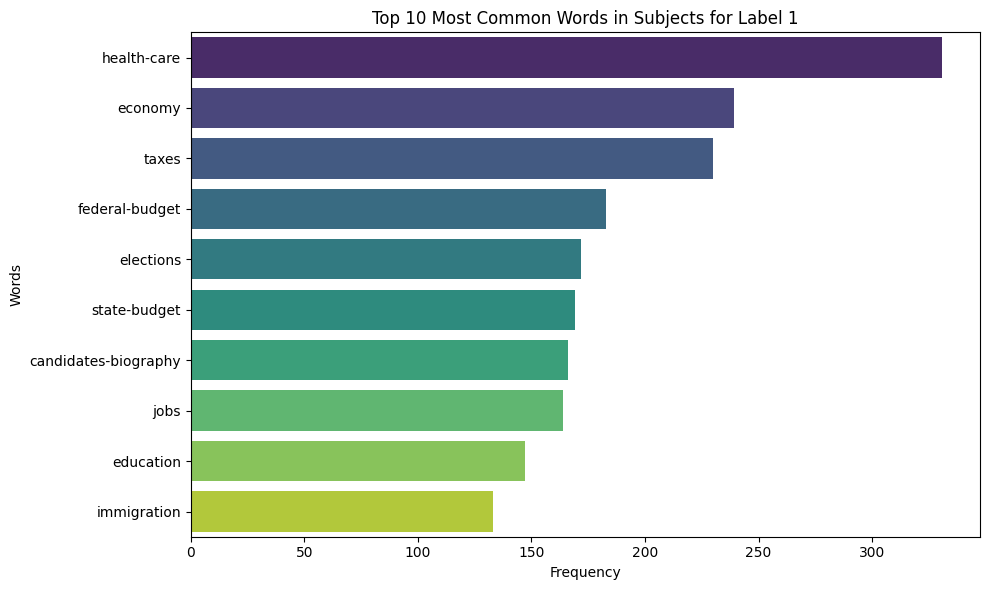

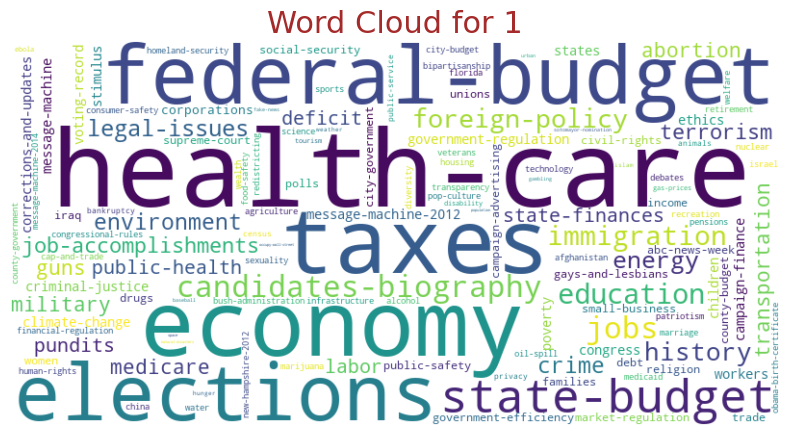

In [24]:
subjects_1 = data[data['label'] == 1]['subject']
word_counts_1 = count_word_frequencies(subjects_1)
word_counts_1
plot_bar_chart_for_most_common_words(word_counts_1, label=1)
create_word_cloud(word_counts_1, label=1)

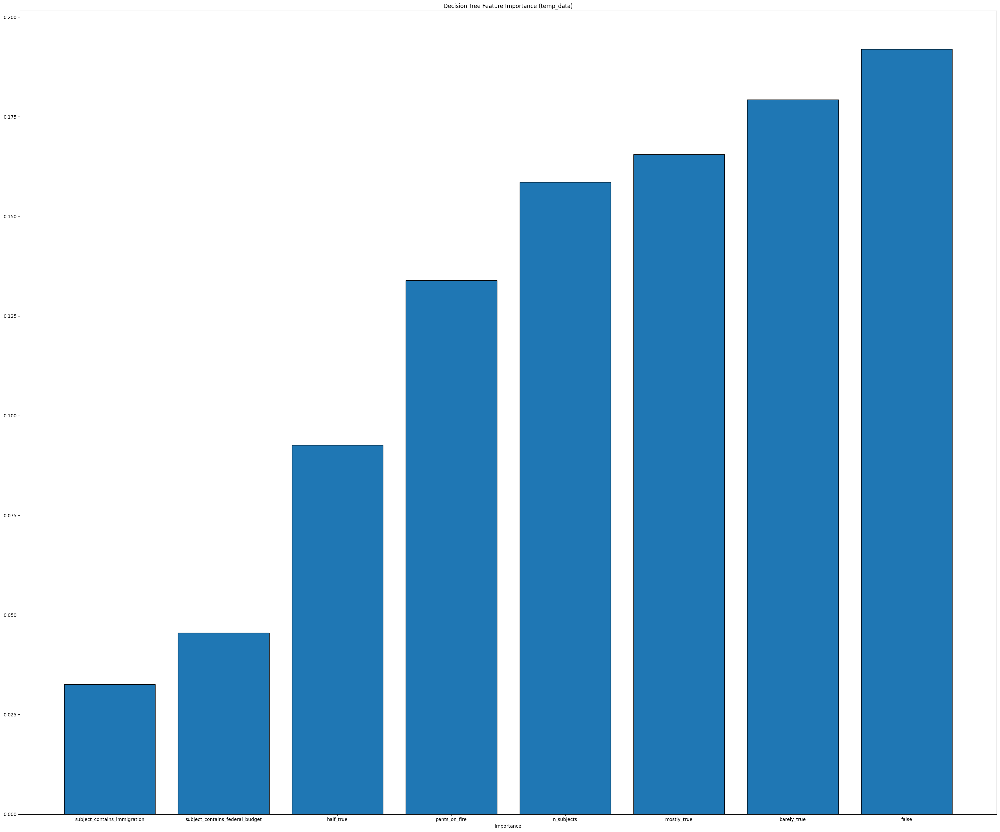

In [25]:
temp_data = pd.DataFrame(data[numeric_columns])
temp_data.dropna(inplace=True)
temp_data['subject_contains_immigration'] = data['subject'].apply(lambda x: 1 if 'immigration' in x.lower() else 0)
temp_data['subject_contains_federal_budget'] = data['subject'].apply(lambda x: 1 if 'federal-budget' in x.lower() else 0)
X = temp_data.drop(columns=['label'])
y = temp_data['label']
tree = DecisionTreeClassifier(random_state=42)
tree.fit(X, y)
imp = pd.Series(tree.feature_importances_, index=X.columns).sort_values(ascending=True)
plt.figure(figsize=(30, 25))
plt.bar(imp.index, imp.values, edgecolor='black')
plt.title('Decision Tree Feature Importance (temp_data)')
plt.xlabel('Importance')
plt.tight_layout()
plt.show()

Again, not enough contribution, but we will see the other labels before we make conclusions

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


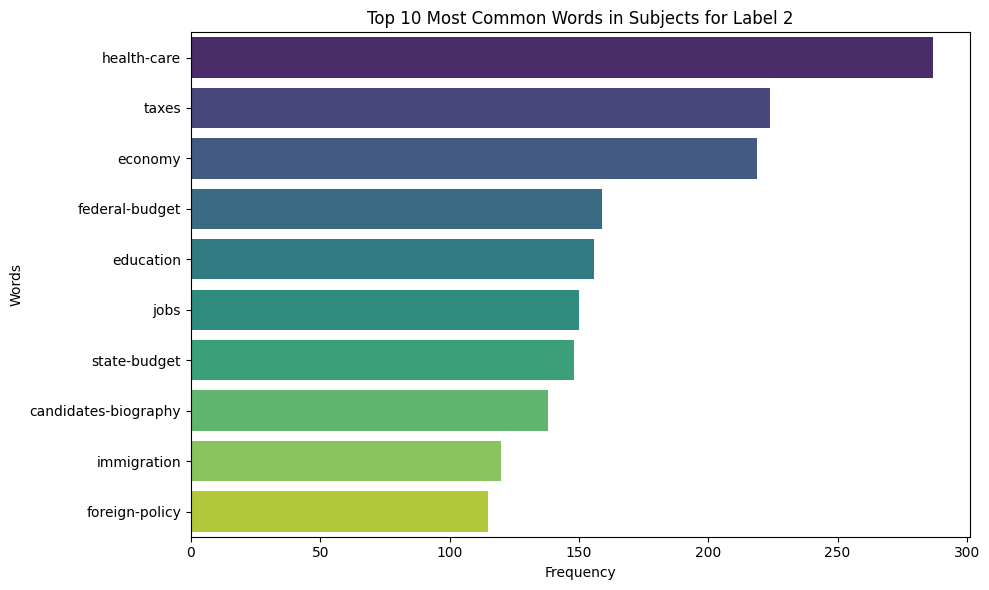

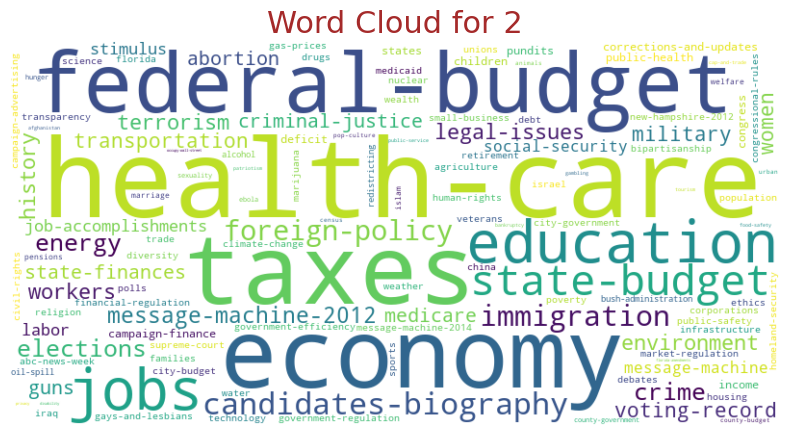

In [26]:
subjects_2 = data[data['label'] ==2]['subject']
word_counts_2 = count_word_frequencies(subjects_2)
word_counts_2
plot_bar_chart_for_most_common_words(word_counts_2, label=2)
create_word_cloud(word_counts_2, label=2)

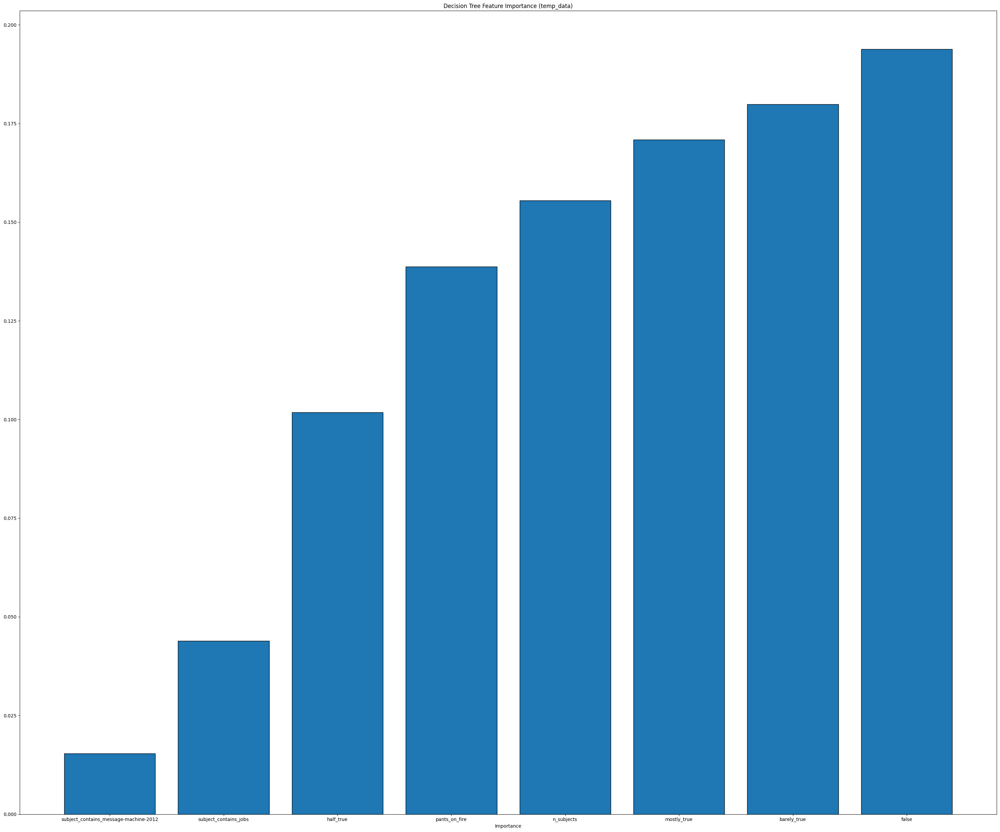

In [27]:
temp_data = pd.DataFrame(data[numeric_columns])
temp_data.dropna(inplace=True)
temp_data['subject_contains_jobs'] = data['subject'].apply(lambda x: 1 if 'jobs' in x.lower() else 0)
temp_data['subject_contains_message-machine-2012'] = data['subject'].apply(lambda x: 1 if 'message-machine-2012' in x.lower() else 0)
X = temp_data.drop(columns=['label'])
y = temp_data['label']
tree = DecisionTreeClassifier(random_state=42)
tree.fit(X, y)
imp = pd.Series(tree.feature_importances_, index=X.columns).sort_values(ascending=True)
plt.figure(figsize=(30, 25))
plt.bar(imp.index, imp.values, edgecolor='black')
plt.title('Decision Tree Feature Importance (temp_data)')
plt.xlabel('Importance')
plt.tight_layout()
plt.show()

Jobs has significantly higher importance, let us see the others

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


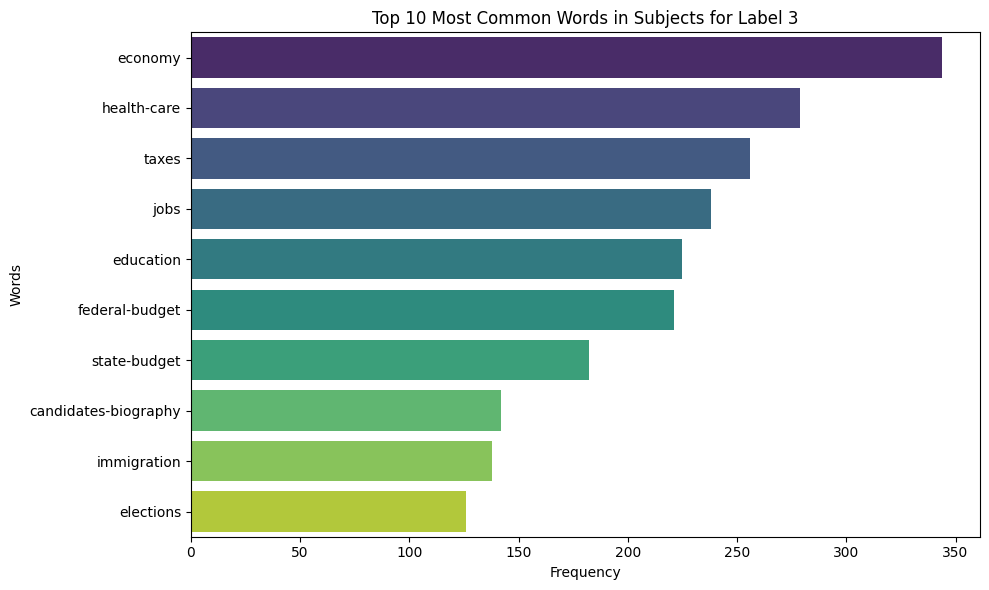

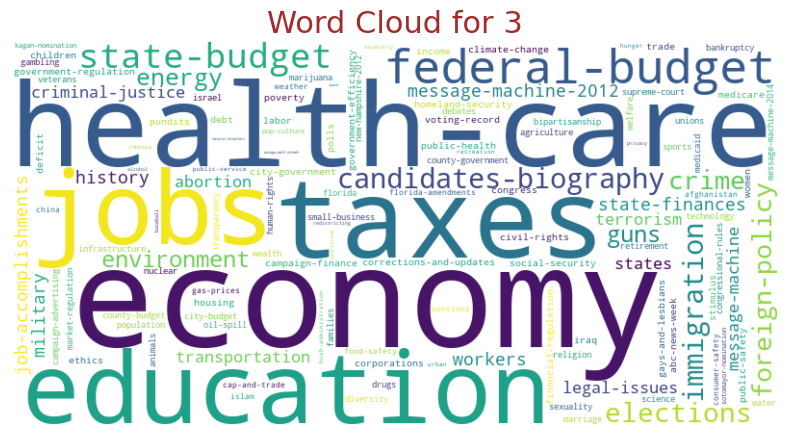

In [28]:
subjects_3 = data[data['label'] ==3]['subject']
word_counts_3 = count_word_frequencies(subjects_3)
word_counts_3
plot_bar_chart_for_most_common_words(word_counts_3, label=3)
create_word_cloud(word_counts_3, label=3)

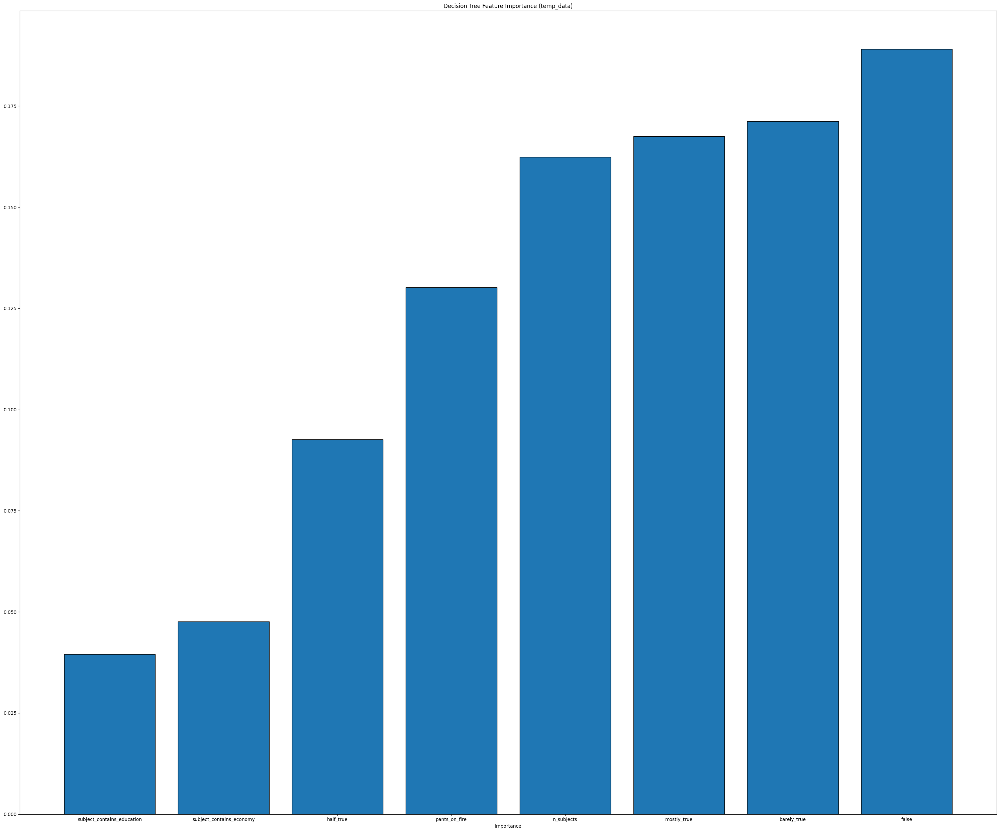

In [29]:
temp_data = pd.DataFrame(data[numeric_columns])
temp_data.dropna(inplace=True)
temp_data['subject_contains_education'] = data['subject'].apply(lambda x: 1 if 'education' in x.lower() else 0)
temp_data['subject_contains_economy'] = data['subject'].apply(lambda x: 1 if 'economy' in x.lower() else 0)
X = temp_data.drop(columns=['label'])
y = temp_data['label']
tree = DecisionTreeClassifier(random_state=42)
tree.fit(X, y)
imp = pd.Series(tree.feature_importances_, index=X.columns).sort_values(ascending=True)
plt.figure(figsize=(30, 25))
plt.bar(imp.index, imp.values, edgecolor='black')
plt.title('Decision Tree Feature Importance (temp_data)')
plt.xlabel('Importance')
plt.tight_layout()
plt.show()

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


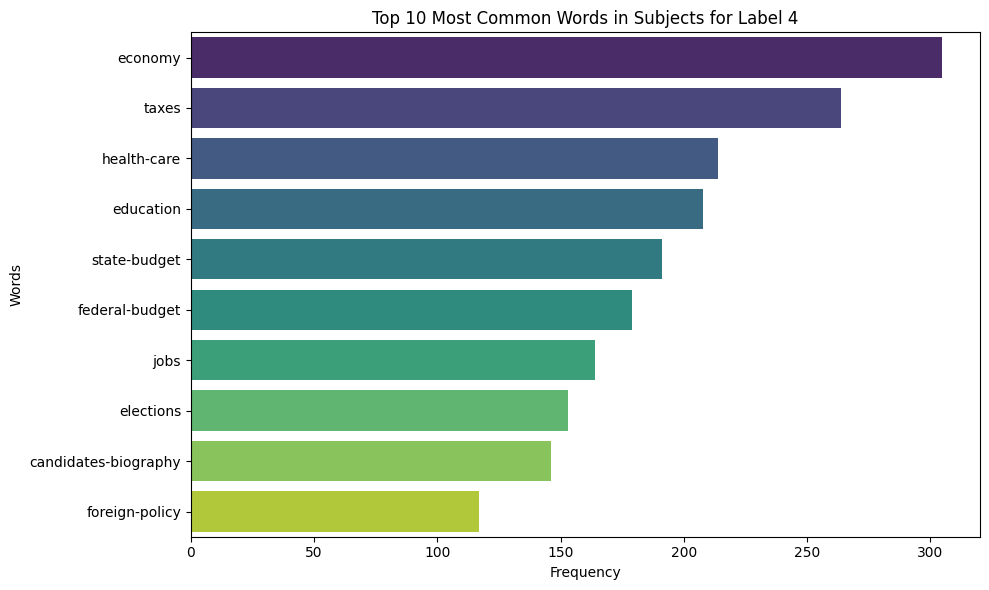

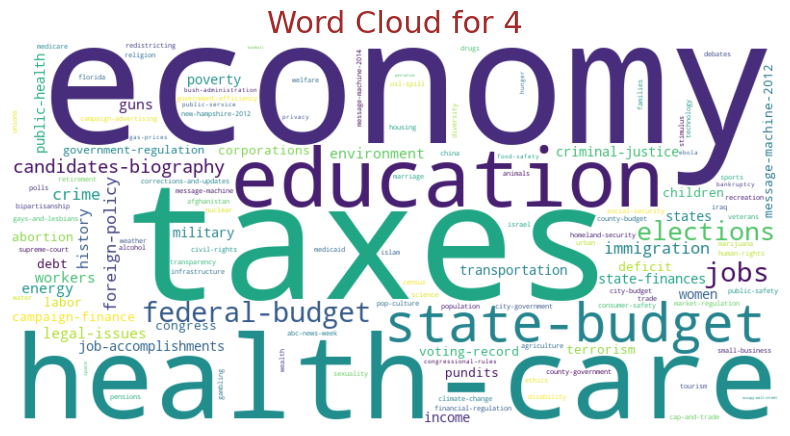

In [30]:
subjects_4 = data[data['label'] ==4]['subject']
word_counts_4 = count_word_frequencies(subjects_4)
word_counts_4
plot_bar_chart_for_most_common_words(word_counts_4, label=4)
create_word_cloud(word_counts_4, label=4)

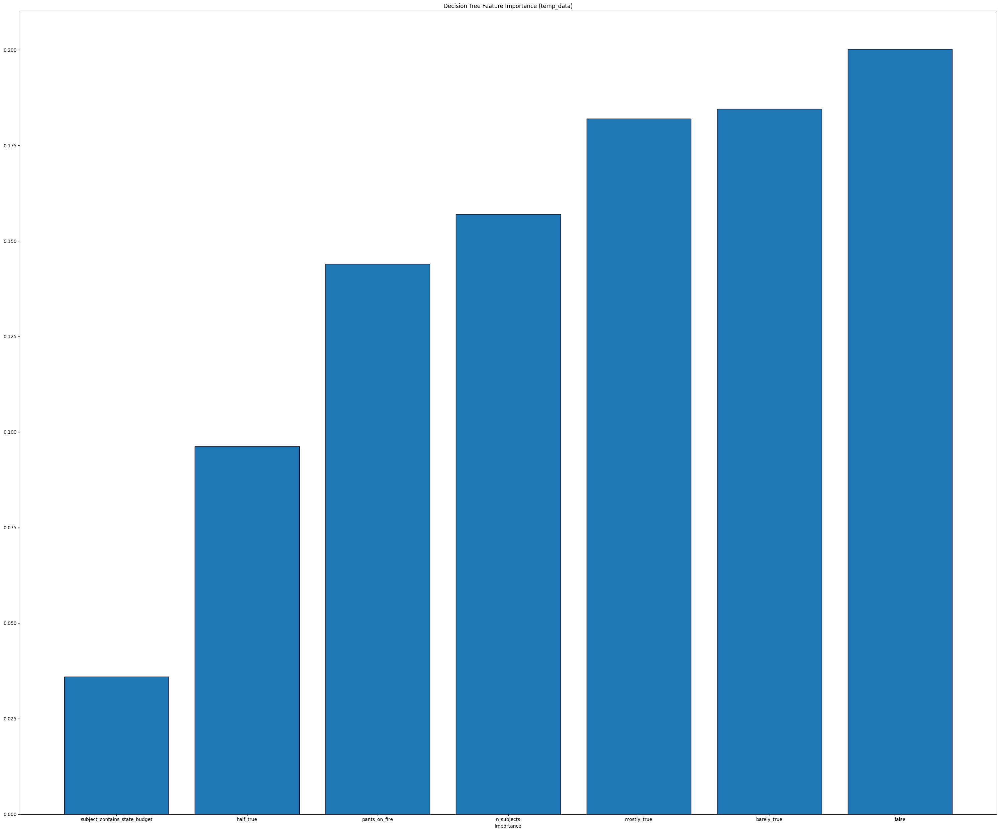

In [31]:
temp_data = pd.DataFrame(data[numeric_columns])
temp_data.dropna(inplace=True)
temp_data['subject_contains_state_budget'] = data['subject'].apply(lambda x: 1 if 'state-budget' in x.lower() else 0)
X = temp_data.drop(columns=['label'])
y = temp_data['label']
tree = DecisionTreeClassifier(random_state=42)
tree.fit(X, y)
imp = pd.Series(tree.feature_importances_, index=X.columns).sort_values(ascending=True)
plt.figure(figsize=(30, 25))
plt.bar(imp.index, imp.values, edgecolor='black')
plt.title('Decision Tree Feature Importance (temp_data)')
plt.xlabel('Importance')
plt.tight_layout()
plt.show()

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


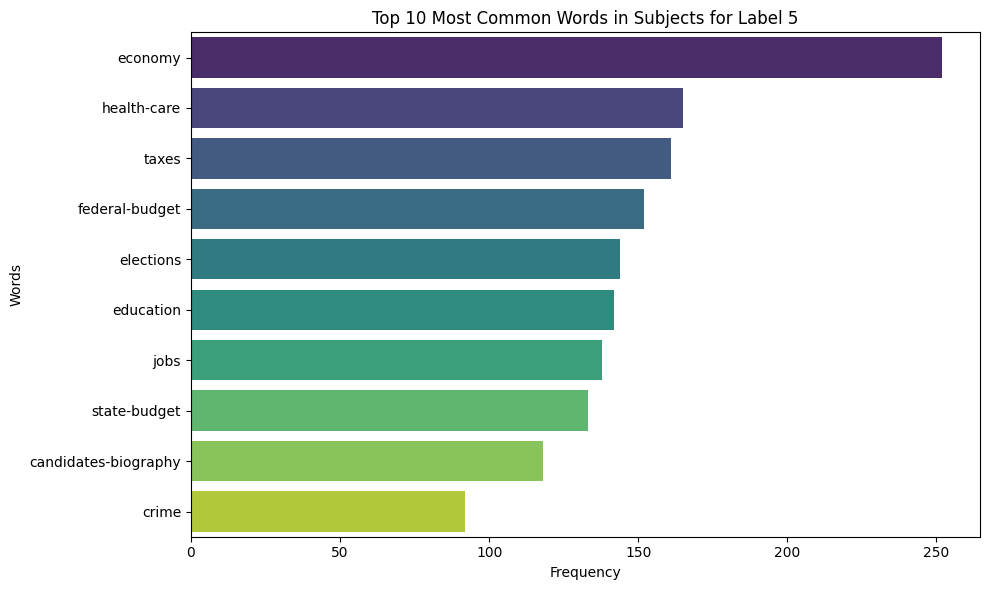

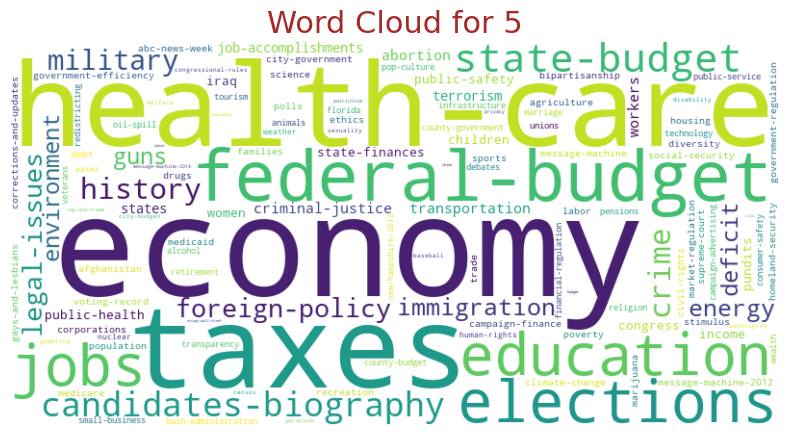

In [32]:
subjects_5 = data[data['label'] ==5]['subject']
word_counts_5 = count_word_frequencies(subjects_5)
word_counts_5
plot_bar_chart_for_most_common_words(word_counts_5, label=5)
create_word_cloud(word_counts_5, label=5)

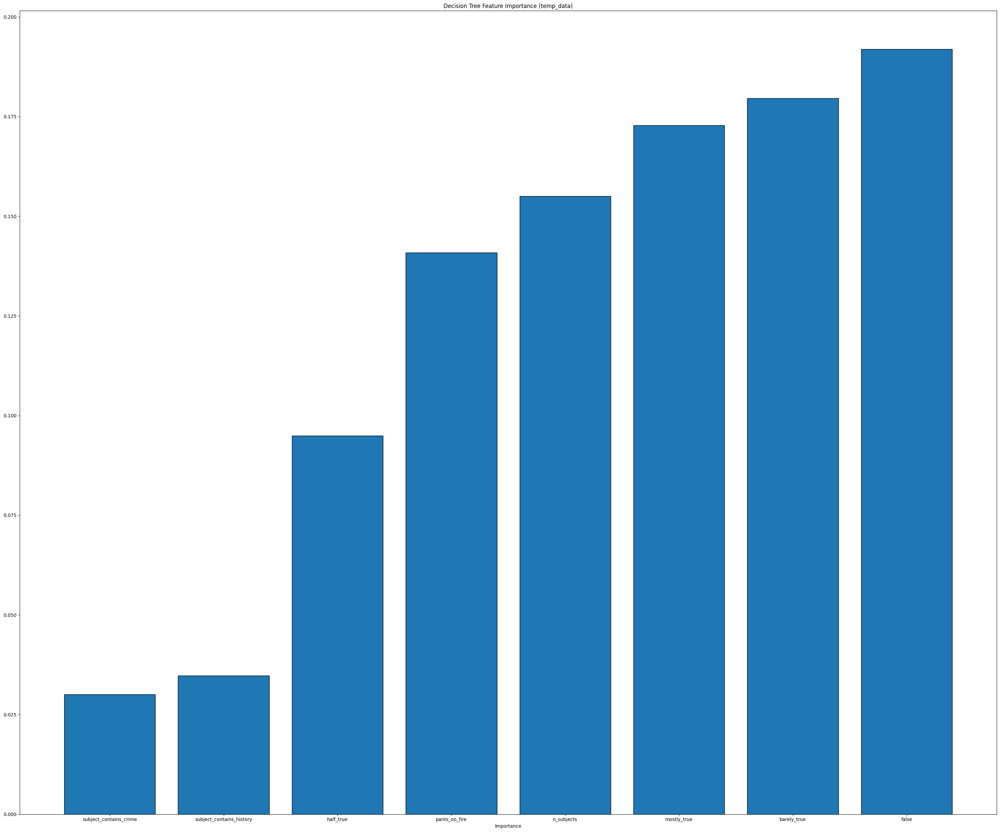

In [33]:
temp_data = pd.DataFrame(data[numeric_columns])
temp_data.dropna(inplace=True)
temp_data['subject_contains_crime'] = data['subject'].apply(lambda x: 1 if 'crime' in x.lower() else 0)
temp_data['subject_contains_history'] = data['subject'].apply(lambda x: 1 if 'history' in x.lower() else 0)
X = temp_data.drop(columns=['label'])
y = temp_data['label']
tree = DecisionTreeClassifier(random_state=42)
tree.fit(X, y)
imp = pd.Series(tree.feature_importances_, index=X.columns).sort_values(ascending=True)
plt.figure(figsize=(30, 25))
plt.bar(imp.index, imp.values, edgecolor='black')
plt.title('Decision Tree Feature Importance (temp_data)')
plt.xlabel('Importance')
plt.tight_layout()
plt.show()

As we see, these columns seem to not contribute enough(adding colums for each job), so it may be better to only stick with n_subjects as new column as it seems to contribute much more and it will replace the subject column

In [34]:
data.drop(columns=['subject'], inplace=True)
data

,label,statement,speaker,job_title,state_info,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,context,n_subjects
0,1,Says the Annies List political group supports ...,dwayne-bohac,State representative,Texas,republican,0.0,1.0,0.0,0.0,0.0,a mailer,1
1,3,When did the decline of coal start? It started...,scott-surovell,State delegate,Virginia,democrat,0.0,0.0,1.0,1.0,0.0,a floor speech.,3
2,4,"Hillary Clinton agrees with John McCain ""by vo...",barack-obama,President,Illinois,democrat,70.0,71.0,160.0,163.0,9.0,Denver,1
3,1,Health care reform legislation is likely to ma...,blog-posting,NaN,NaN,none,7.0,19.0,3.0,5.0,44.0,a news release,1
4,3,The economic turnaround started at the end of ...,charlie-crist,NaN,Florida,democrat,15.0,9.0,20.0,19.0,2.0,an interview on CNN,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,rick-scott,Governor,Florida,republican,28.0,23.0,38.0,34.0,7.0,a news conference,1
12787,2,Ive been here almost every day.,jay-nixon,Governor,Missouri,democrat,2.0,0.0,0.0,1.0,0.0,"on ABC's ""This Week""",3
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...",mackubin-thomas-owens,"senior fellow, Foreign Policy Research Institute",Rhode Island,columnist,1.0,0.0,0.0,0.0,0.0,a commentary in The Providence Journal,4
12789,2,Says an EPA permit languished under Strickland...,john-kasich,"Governor of Ohio as of Jan. 10, 2011",Ohio,republican,9.0,8.0,10.0,18.0,3.0,a news conference,2


Now we will continue with analyzing the speaker column

We can see from the data audit that all names are separated by -, there doesnt seem to be a lot of stopwords or words that can be removed. We can compare different categories that include of how rare given speaker is as well its name length.

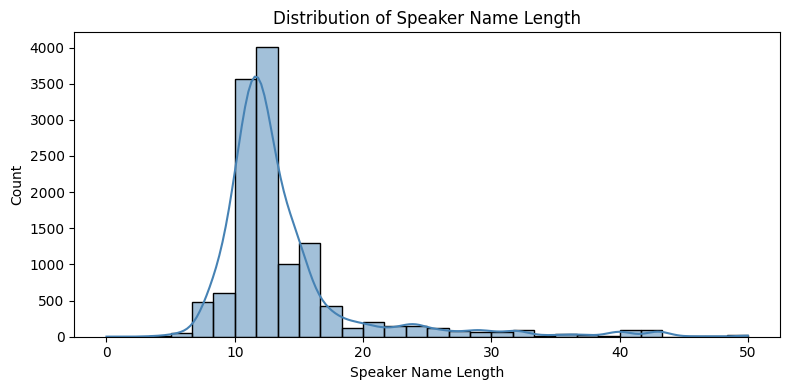

In [35]:
data['speaker_length'] = data['speaker'].fillna('').astype(str).apply(len)
plt.figure(figsize=(8, 4))
sns.histplot(data['speaker_length'], bins=30, kde=True, color='steelblue')
plt.title("Distribution of Speaker Name Length")
plt.xlabel("Speaker Name Length")
plt.ylabel("Count")
plt.tight_layout()

It is not evenly distributed so we can can see if there is correlation.

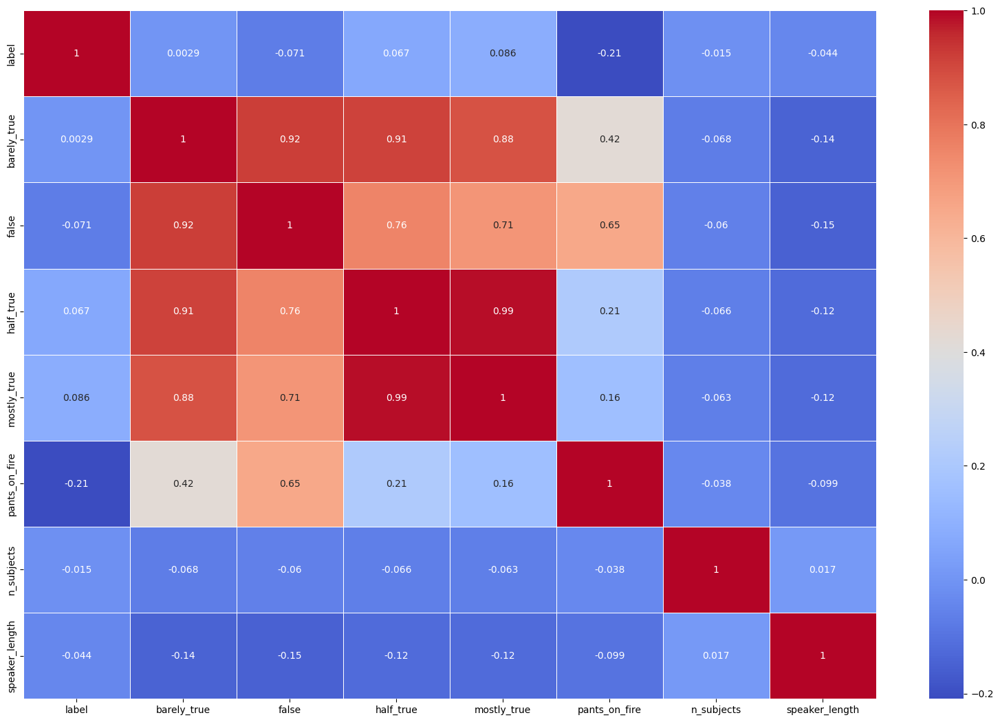

In [36]:
numeric_columns = data.select_dtypes(include=np.number).columns.tolist()
corr_df = data[numeric_columns].corr()
plt.figure(figsize=(20, 13))
sns.heatmap(corr_df, annot=True, cmap="coolwarm", linewidths=0.5)
plt.show()

Not a really high correlation, let us see a scatterplot.

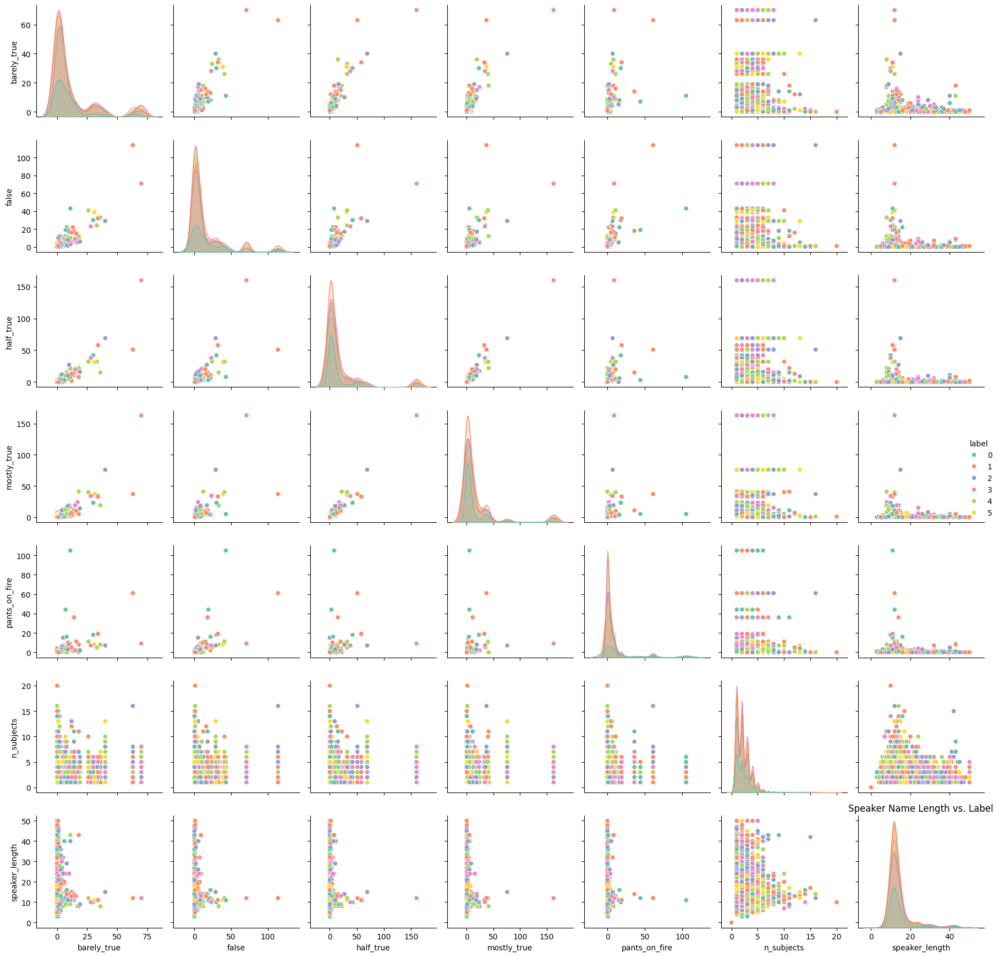

In [37]:
sns.pairplot(data[numeric_columns], hue='label', palette='Set2')
plt.title("Speaker Name Length vs. Label")
plt.xlabel("Speaker Name Length")
plt.ylabel("Label")
plt.tight_layout()

The data doesnt look really separable but we will try with decision tree importances

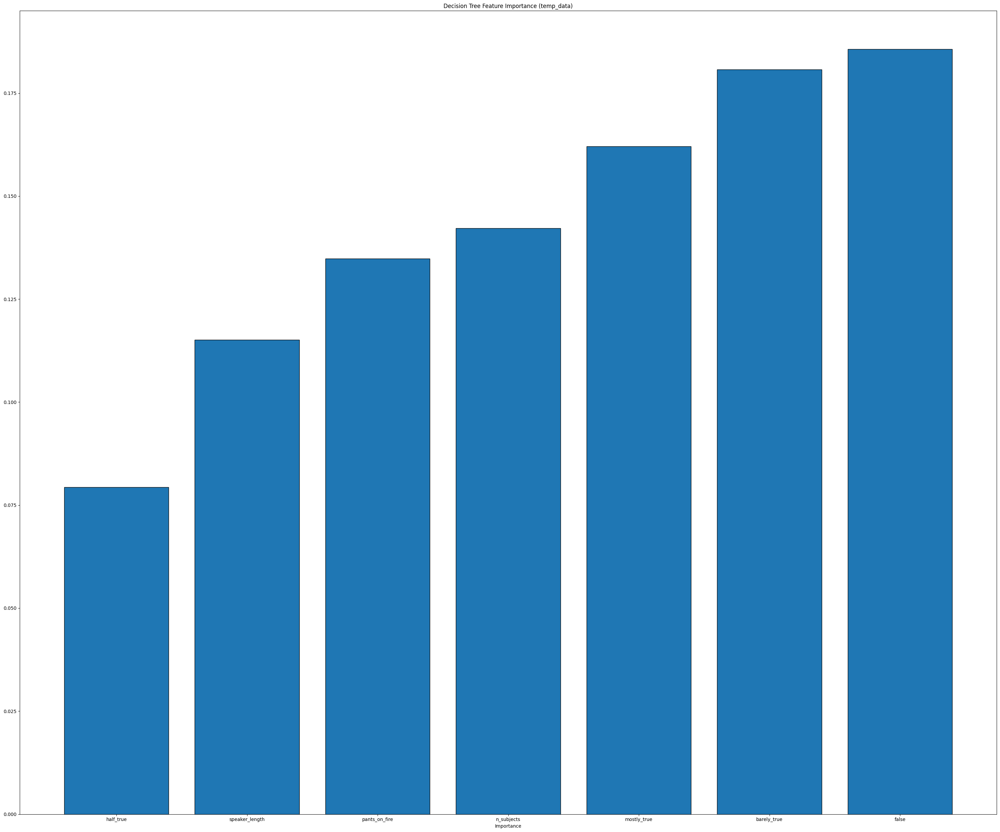

In [38]:
temp_data = pd.DataFrame(data[numeric_columns])
temp_data.dropna(inplace=True)
X = temp_data.drop(columns=['label'])
y = temp_data['label']
tree = DecisionTreeClassifier(random_state=42, max_depth=15)
tree.fit(X, y)
imp = pd.Series(tree.feature_importances_, index=X.columns).sort_values(ascending=True)
plt.figure(figsize=(30, 25))
plt.bar(imp.index, imp.values, edgecolor='black')
plt.title('Decision Tree Feature Importance (temp_data)')
plt.xlabel('Importance')
plt.tight_layout()
plt.show()

We see it has a relatively good importance so we will leave it for now.

Now we will see the number of appearences of each speaker in the document

In [39]:
speaker_counter = data['speaker'].fillna('Unknown').str.lower().value_counts()


Text(0.5, 1.0, 'Number of Statements by Speaker')

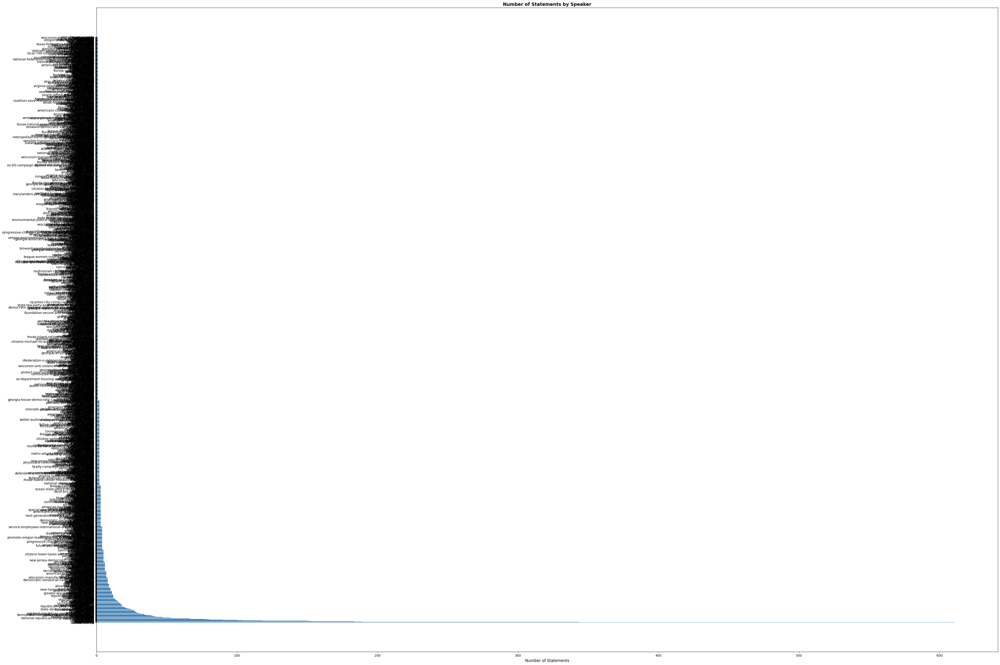

In [40]:
plt.figure(figsize=(50, 36))
plt.barh(speaker_counter.index, speaker_counter.values, color='steelblue')
plt.xlabel('Number of Statements', fontsize=12)
plt.title('Number of Statements by Speaker', fontsize=14, fontweight='bold')

In [41]:

speaker_counter = data["speaker"].fillna("Unknown").str.lower().value_counts()

speaker_counter_sorted = speaker_counter.sort_values(ascending=False)

n = len(speaker_counter_sorted)
cut1 = n // 3
cut2 = 2 * n // 3

high_speakers = speaker_counter_sorted.index[:cut1]
medium_speakers = speaker_counter_sorted.index[cut1:cut2]
low_speakers = speaker_counter_sorted.index[cut2:]

speaker_to_cat = pd.Series(index=speaker_counter_sorted.index, data="low", dtype="object")
speaker_to_cat.loc[medium_speakers] = "medium"
speaker_to_cat.loc[high_speakers] = "high"

data["speaker_frequency_category"] = data["speaker"].fillna("Unknown").str.lower().map(speaker_to_cat)

speaker_counter_sorted.head(10)
data

,label,statement,speaker,job_title,state_info,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,context,n_subjects,speaker_length,speaker_frequency_category
0,1,Says the Annies List political group supports ...,dwayne-bohac,State representative,Texas,republican,0.0,1.0,0.0,0.0,0.0,a mailer,1,12,medium
1,3,When did the decline of coal start? It started...,scott-surovell,State delegate,Virginia,democrat,0.0,0.0,1.0,1.0,0.0,a floor speech.,3,14,medium
2,4,"Hillary Clinton agrees with John McCain ""by vo...",barack-obama,President,Illinois,democrat,70.0,71.0,160.0,163.0,9.0,Denver,1,12,high
3,1,Health care reform legislation is likely to ma...,blog-posting,NaN,NaN,none,7.0,19.0,3.0,5.0,44.0,a news release,1,12,high
4,3,The economic turnaround started at the end of ...,charlie-crist,NaN,Florida,democrat,15.0,9.0,20.0,19.0,2.0,an interview on CNN,2,13,high
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,rick-scott,Governor,Florida,republican,28.0,23.0,38.0,34.0,7.0,a news conference,1,10,high
12787,2,Ive been here almost every day.,jay-nixon,Governor,Missouri,democrat,2.0,0.0,0.0,1.0,0.0,"on ABC's ""This Week""",3,9,high
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...",mackubin-thomas-owens,"senior fellow, Foreign Policy Research Institute",Rhode Island,columnist,1.0,0.0,0.0,0.0,0.0,a commentary in The Providence Journal,4,21,medium
12789,2,Says an EPA permit languished under Strickland...,john-kasich,"Governor of Ohio as of Jan. 10, 2011",Ohio,republican,9.0,8.0,10.0,18.0,3.0,a news conference,2,11,high


Let us see how much labels each of the categores has

In [42]:
cats = ["low", "medium", "high"]
labels = sorted(data["label"].dropna().unique()) 

def plot_bar_chart_for_category(data, column_name, cats):
    for cat in cats:
        subset = data.loc[data[column_name] == cat, "label"]
        counts = subset.value_counts().reindex(labels, fill_value=0).sort_index()

        plt.figure(figsize=(8, 5))
        plt.bar([str(l) for l in labels], counts.values, color="steelblue", edgecolor="black")
        plt.title(f"Label distribution for category: {cat}")
        plt.xlabel("Label")
        plt.ylabel("Count")
        plt.grid(axis="y", alpha=0.25)
        plt.tight_layout()
        plt.show()





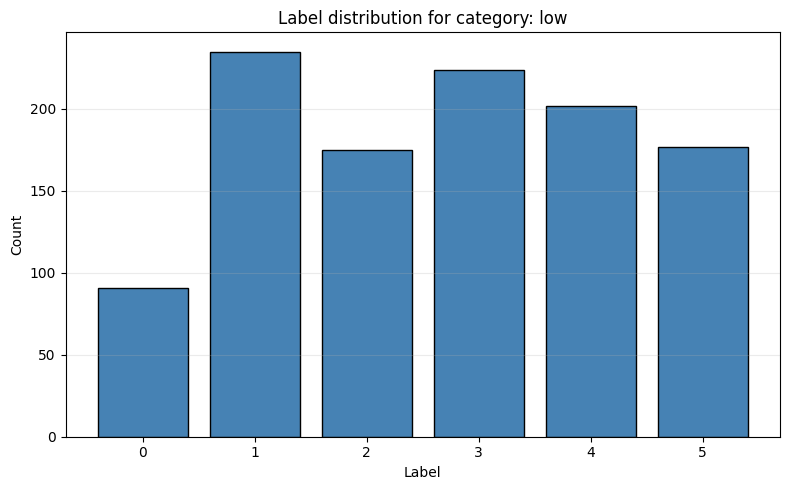

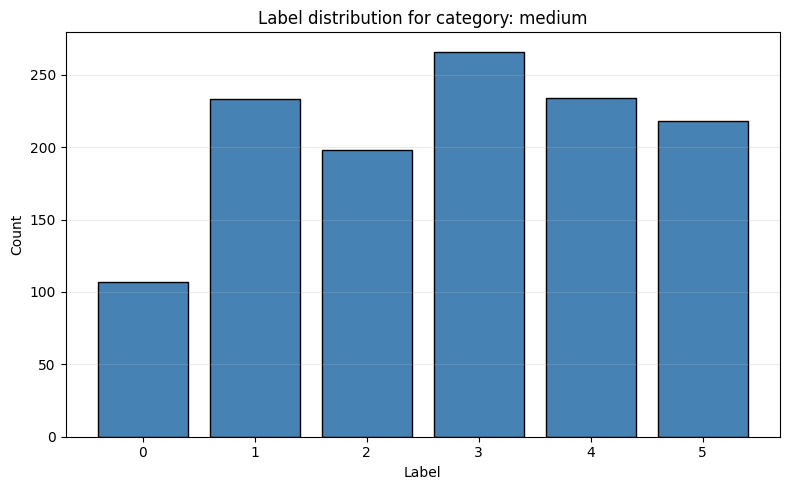

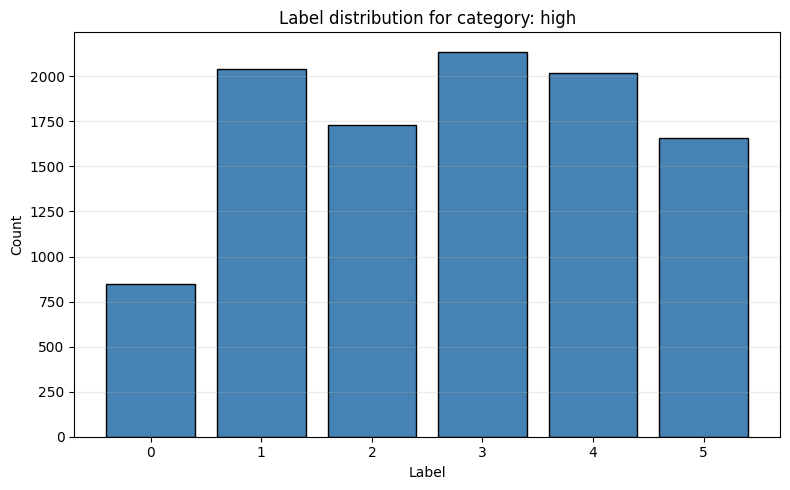

In [43]:
plot_bar_chart_for_category(data, column_name = "speaker_frequency_category", cats=cats)

We could see really small difference between the distribution of the 3 categories. We will also try a model to see this column importance

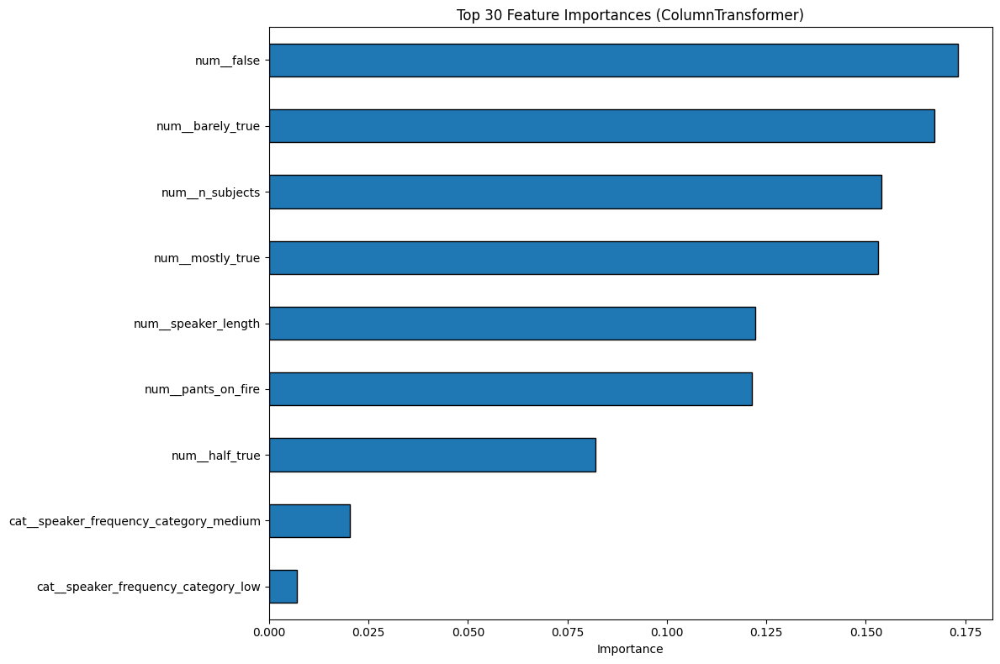

In [44]:

num_cols = data.select_dtypes(include=np.number).columns.tolist()
num_cols = [c for c in num_cols if c != "label"]
cat_cols = ["speaker_frequency_category"]

used_cols = num_cols + cat_cols + ["label"]
temp_data = data[used_cols].dropna()

X = temp_data[num_cols + cat_cols]
y = temp_data["label"]

preprocess = ColumnTransformer(
    transformers=[
        ("num", "passthrough", num_cols),
        ("cat", OneHotEncoder(handle_unknown="ignore", drop="first"), cat_cols),
    ],
    remainder="drop",
)

model = Pipeline(steps=[
    ("preprocess", preprocess),
    ("clf", DecisionTreeClassifier(random_state=42, max_depth=20)),
])

model.fit(X, y)

clf = model.named_steps["clf"]
pre = model.named_steps["preprocess"]

feature_names = pre.get_feature_names_out()

importances = clf.feature_importances_
imp = pd.Series(importances, index=feature_names).sort_values(ascending=False)

plt.figure(figsize=(12, 8))
imp.head(30).sort_values().plot(kind="barh", edgecolor="black")
plt.title("Top 30 Feature Importances (ColumnTransformer)")
plt.xlabel("Importance")
plt.tight_layout()
plt.show()

These categories seem irrelevant,maybe it is better only if we remain with the speaker length column. We are not looking to add true column because it would lead to data leakage. in training models

In [45]:
data.drop(columns = ['speaker'], inplace = True)
data

,label,statement,job_title,state_info,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,context,n_subjects,speaker_length,speaker_frequency_category
0,1,Says the Annies List political group supports ...,State representative,Texas,republican,0.0,1.0,0.0,0.0,0.0,a mailer,1,12,medium
1,3,When did the decline of coal start? It started...,State delegate,Virginia,democrat,0.0,0.0,1.0,1.0,0.0,a floor speech.,3,14,medium
2,4,"Hillary Clinton agrees with John McCain ""by vo...",President,Illinois,democrat,70.0,71.0,160.0,163.0,9.0,Denver,1,12,high
3,1,Health care reform legislation is likely to ma...,NaN,NaN,none,7.0,19.0,3.0,5.0,44.0,a news release,1,12,high
4,3,The economic turnaround started at the end of ...,NaN,Florida,democrat,15.0,9.0,20.0,19.0,2.0,an interview on CNN,2,13,high
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,Governor,Florida,republican,28.0,23.0,38.0,34.0,7.0,a news conference,1,10,high
12787,2,Ive been here almost every day.,Governor,Missouri,democrat,2.0,0.0,0.0,1.0,0.0,"on ABC's ""This Week""",3,9,high
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...","senior fellow, Foreign Policy Research Institute",Rhode Island,columnist,1.0,0.0,0.0,0.0,0.0,a commentary in The Providence Journal,4,21,medium
12789,2,Says an EPA permit languished under Strickland...,"Governor of Ohio as of Jan. 10, 2011",Ohio,republican,9.0,8.0,10.0,18.0,3.0,a news conference,2,11,high


In [46]:
data.drop(columns=['speaker_frequency_category'], inplace=True)
data

,label,statement,job_title,state_info,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,context,n_subjects,speaker_length
0,1,Says the Annies List political group supports ...,State representative,Texas,republican,0.0,1.0,0.0,0.0,0.0,a mailer,1,12
1,3,When did the decline of coal start? It started...,State delegate,Virginia,democrat,0.0,0.0,1.0,1.0,0.0,a floor speech.,3,14
2,4,"Hillary Clinton agrees with John McCain ""by vo...",President,Illinois,democrat,70.0,71.0,160.0,163.0,9.0,Denver,1,12
3,1,Health care reform legislation is likely to ma...,NaN,NaN,none,7.0,19.0,3.0,5.0,44.0,a news release,1,12
4,3,The economic turnaround started at the end of ...,NaN,Florida,democrat,15.0,9.0,20.0,19.0,2.0,an interview on CNN,2,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,Governor,Florida,republican,28.0,23.0,38.0,34.0,7.0,a news conference,1,10
12787,2,Ive been here almost every day.,Governor,Missouri,democrat,2.0,0.0,0.0,1.0,0.0,"on ABC's ""This Week""",3,9
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...","senior fellow, Foreign Policy Research Institute",Rhode Island,columnist,1.0,0.0,0.0,0.0,0.0,a commentary in The Providence Journal,4,21
12789,2,Says an EPA permit languished under Strickland...,"Governor of Ohio as of Jan. 10, 2011",Ohio,republican,9.0,8.0,10.0,18.0,3.0,a news conference,2,11


We will now analyze the job_title column. Firtly we will see the text length

In [47]:
data['job_title_length'] = data['job_title'].fillna('').astype(str).apply(len)

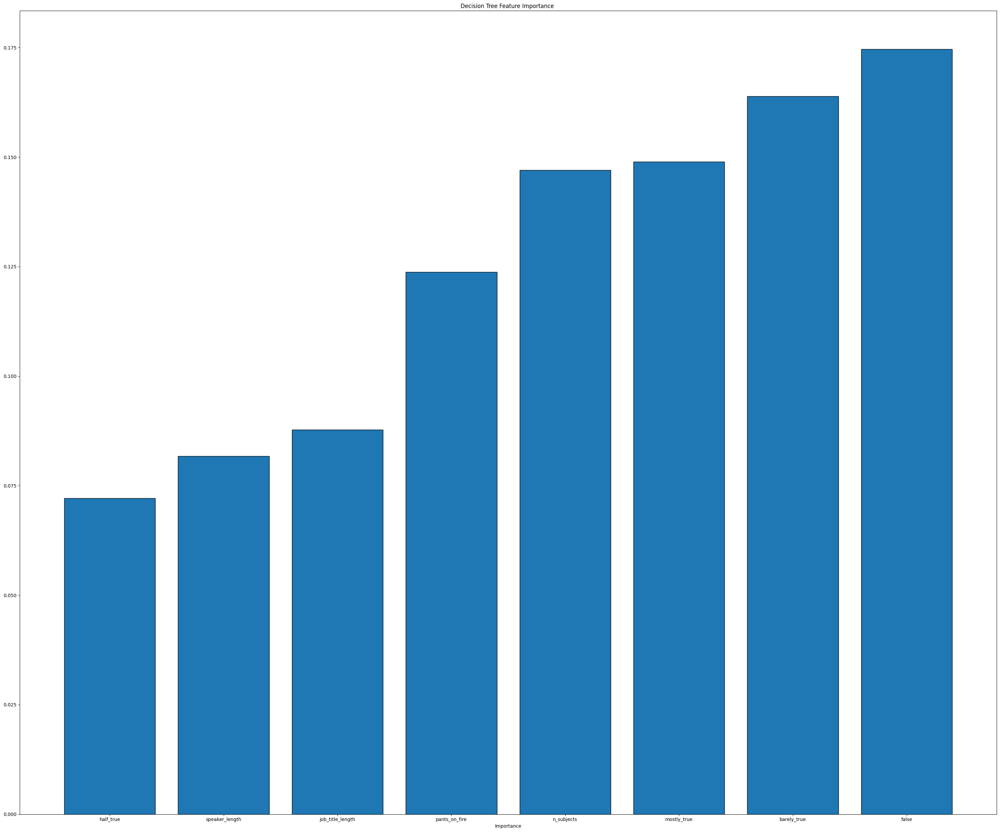

In [48]:
numeric_columns = data.select_dtypes(include=np.number).columns.tolist()
temp_data = pd.DataFrame(data[numeric_columns])
temp_data.dropna(inplace=True)
X = temp_data.drop(columns=['label'])
y = temp_data['label']
tree = DecisionTreeClassifier(random_state=42, max_depth=15)
tree.fit(X, y)
imp = pd.Series(tree.feature_importances_, index=X.columns).sort_values(ascending=True)
plt.figure(figsize=(30, 25))
plt.bar(imp.index, imp.values, edgecolor='black')
plt.title('Decision Tree Feature Importance ')
plt.xlabel('Importance')
plt.tight_layout()
plt.show()

Not a bad importance, however we will try with removing the missing values.

In [49]:
data['job_title_length'] = data['job_title'].dropna().astype(str).apply(len)

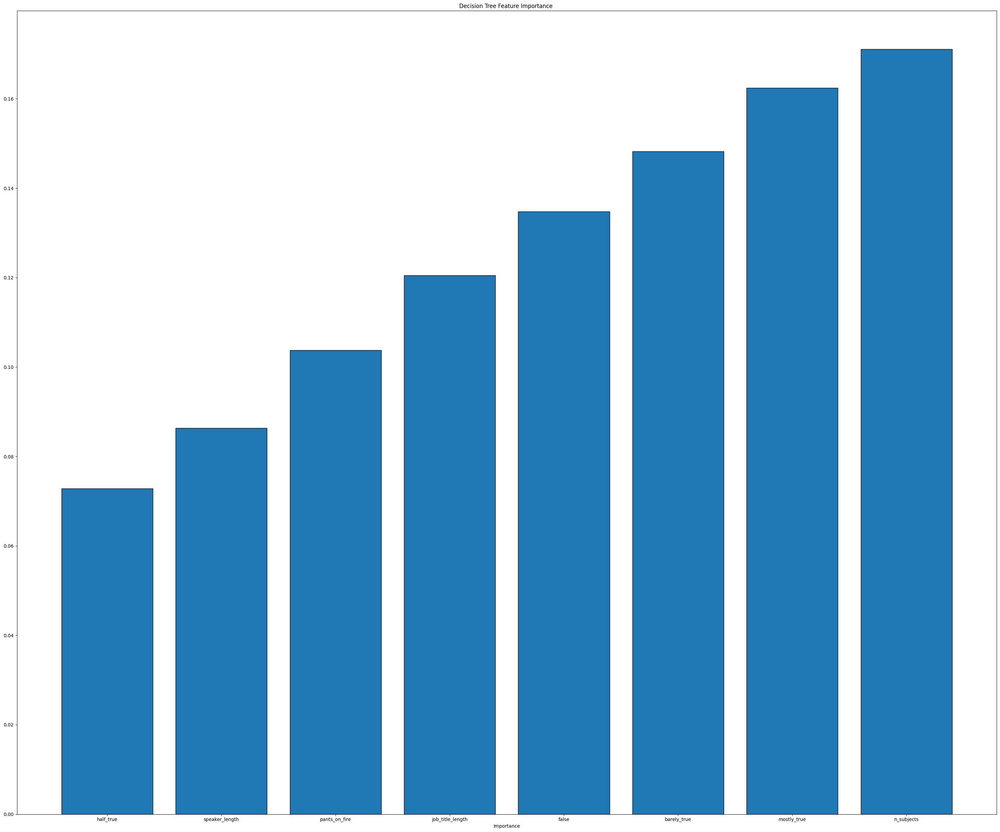

In [50]:
def plot_tree_feature_importance(data):    
    numeric_columns = data.select_dtypes(include=np.number).columns.tolist()
    temp_data = pd.DataFrame(data[numeric_columns])
    temp_data.dropna(inplace=True)
    X = temp_data.drop(columns=['label'])
    y = temp_data['label']
    tree = DecisionTreeClassifier(random_state=42, max_depth=15)
    tree.fit(X, y)
    imp = pd.Series(tree.feature_importances_, index=X.columns).sort_values(ascending=True)
    plt.figure(figsize=(30, 25))
    plt.bar(imp.index, imp.values, edgecolor='black')
    plt.title('Decision Tree Feature Importance ')
    plt.xlabel('Importance')
    plt.tight_layout()
    plt.show()
plot_tree_feature_importance(data)

We will leave this column for now. Let us see if missing values are really missing or the people just dont have a job.

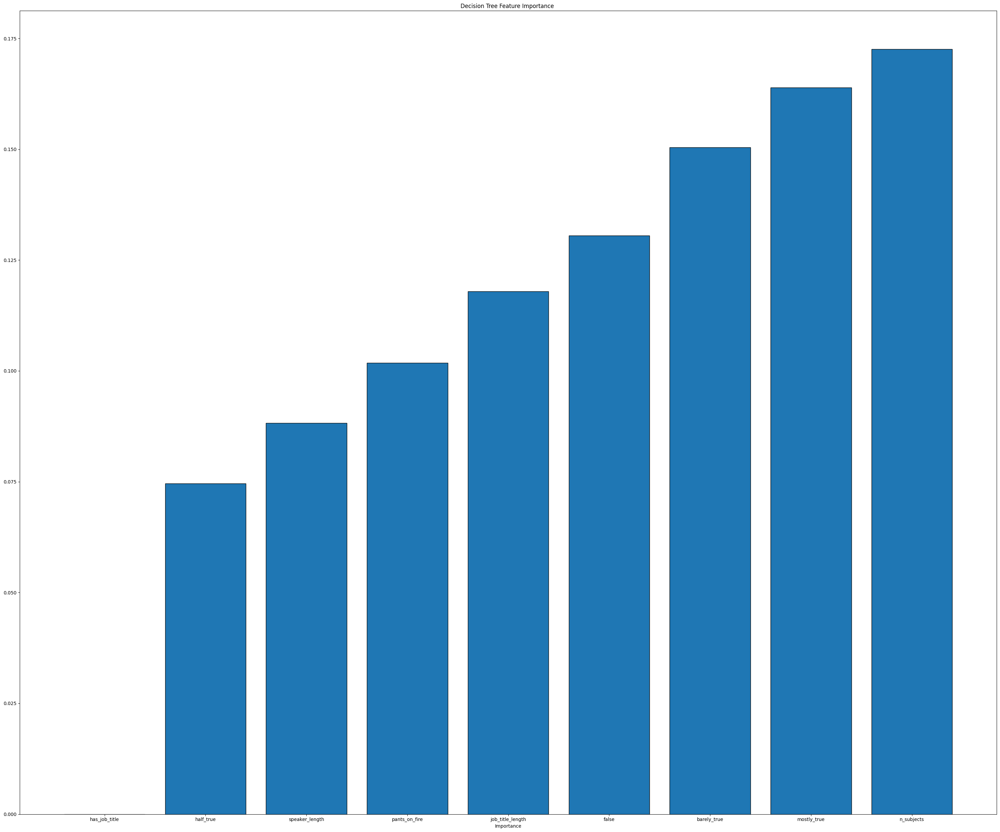

,label,statement,job_title,state_info,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,context,n_subjects,speaker_length,job_title_length,has_job_title
0,1,Says the Annies List political group supports ...,State representative,Texas,republican,0.0,1.0,0.0,0.0,0.0,a mailer,1,12,20.0,1
1,3,When did the decline of coal start? It started...,State delegate,Virginia,democrat,0.0,0.0,1.0,1.0,0.0,a floor speech.,3,14,14.0,1
2,4,"Hillary Clinton agrees with John McCain ""by vo...",President,Illinois,democrat,70.0,71.0,160.0,163.0,9.0,Denver,1,12,9.0,1
3,1,Health care reform legislation is likely to ma...,NaN,NaN,none,7.0,19.0,3.0,5.0,44.0,a news release,1,12,NaN,0
4,3,The economic turnaround started at the end of ...,NaN,Florida,democrat,15.0,9.0,20.0,19.0,2.0,an interview on CNN,2,13,NaN,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,Governor,Florida,republican,28.0,23.0,38.0,34.0,7.0,a news conference,1,10,8.0,1
12787,2,Ive been here almost every day.,Governor,Missouri,democrat,2.0,0.0,0.0,1.0,0.0,"on ABC's ""This Week""",3,9,8.0,1
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...","senior fellow, Foreign Policy Research Institute",Rhode Island,columnist,1.0,0.0,0.0,0.0,0.0,a commentary in The Providence Journal,4,21,48.0,1
12789,2,Says an EPA permit languished under Strickland...,"Governor of Ohio as of Jan. 10, 2011",Ohio,republican,9.0,8.0,10.0,18.0,3.0,a news conference,2,11,36.0,1


In [51]:
data['has_job_title'] = data['job_title'].notna().astype(int)
plot_tree_feature_importance(data)
data

It doesnt look like this.

Maybe we should see the most frequent words in job titles.

In [52]:
def count_word_frequencies(series):
    tokens = (
        series.fillna("")
              .astype(str)
              .str.lower()
              .str.split(r"[,\s]+")
              .explode()
              .str.strip()
    )
    tokens = tokens[tokens.ne("")] 
    return tokens.value_counts()

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


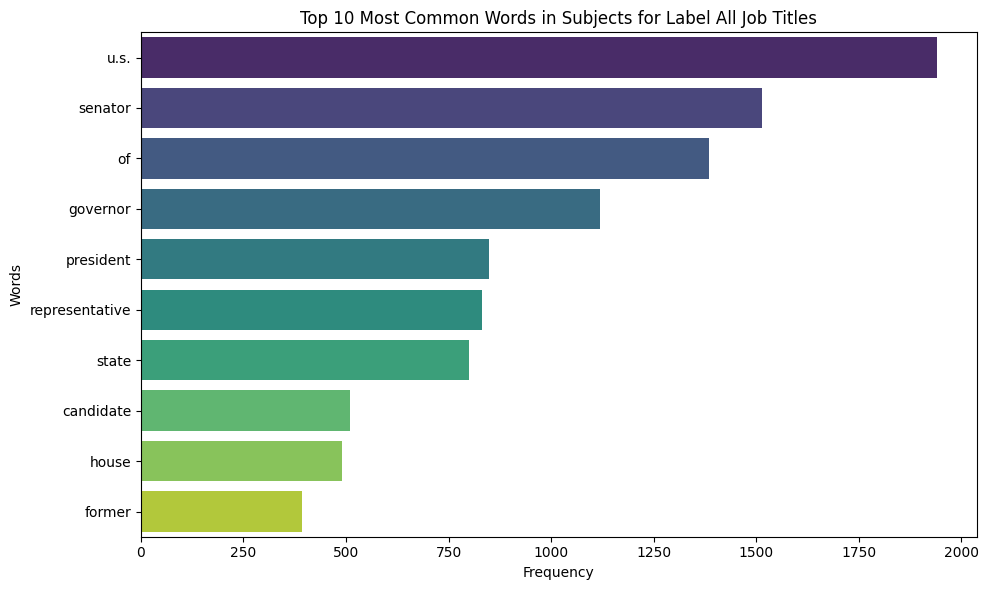

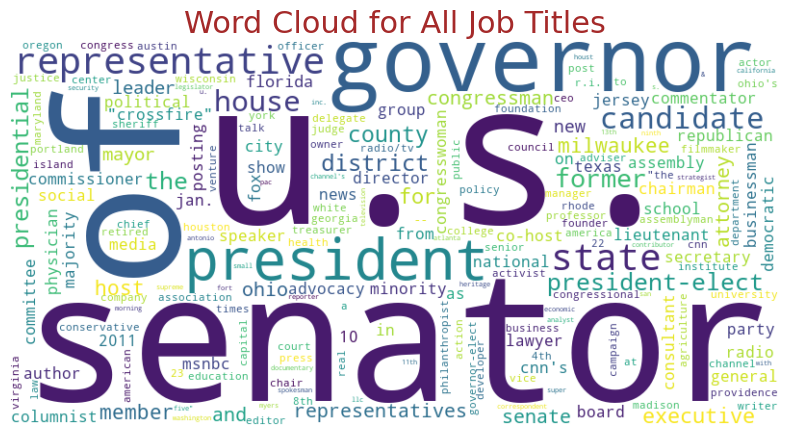

In [53]:
frequencies = count_word_frequencies(data['job_title'].fillna(''))
plot_bar_chart_for_most_common_words(frequencies, label='All Job Titles')
create_word_cloud(frequencies, label='All Job Titles')

Very expectedly, words like us, senator, governor are among the most frequent, also there are not really a lot of stopwords(only of appears in the barplot). I would like to try if removing stopwords would give as a better model compared to not removing them.

In [54]:
temp_data = data.dropna(subset=['job_title'])
X = temp_data["job_title"].astype(str)
y = temp_data["label"]

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

configs = [
    ("word_1_2_no_stop", dict(analyzer="word", ngram_range=(1, 2), stop_words=None, min_df=2)),
    ("word_1_2_stop",    dict(analyzer="word", ngram_range=(1, 2), stop_words="english", min_df=2)),
]

for name, args in configs:
    pipe = Pipeline([
        ("tfidf", TfidfVectorizer(lowercase=True, **args)),
        ("clf", MultinomialNB(alpha=1.0))
    ])
    pipe.fit(X_train, y_train)
    pred = pipe.predict(X_test)
    print(name, "F1=", f1_score(y_test, pred, average="macro"))
    

word_1_2_no_stop F1= 0.194420048769274
word_1_2_stop F1= 0.19848395564504173


We see that using 2 words combinations might give best results to this columns. As the column is not long enough, there might be not so many columns to enginner from this column, but we may at least try normal counter vectorizer.

In [55]:
temp_data = data.dropna(subset=['job_title'])
X = temp_data["job_title"].astype(str)
y = temp_data["label"]

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

configs = [
    ("word_1_2_no_stop", dict(analyzer="word", ngram_range=(1, 2), stop_words=None, min_df=2)),
    ("word_1_2_stop",    dict(analyzer="word", ngram_range=(1, 2), stop_words="english", min_df=2)),
]

for name, args in configs:
    pipe = Pipeline([
        ("tfidf", CountVectorizer(lowercase=True, **args)),
        ("clf", MultinomialNB(alpha=1.0))
    ])
    pipe.fit(X_train, y_train)
    pred = pipe.predict(X_test)
    print(name, "F1=", f1_score(y_test, pred, average="macro"))


word_1_2_no_stop F1= 0.19452431153037122
word_1_2_stop F1= 0.19296341859123703


A little lower, so what may be best is the TfIdf vectorizer. So we leave the job_title column and continue with analyzing state_info column.

In [56]:
data.drop(columns=['has_job_title'], inplace=True)

In [57]:
data

,label,statement,job_title,state_info,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,context,n_subjects,speaker_length,job_title_length
0,1,Says the Annies List political group supports ...,State representative,Texas,republican,0.0,1.0,0.0,0.0,0.0,a mailer,1,12,20.0
1,3,When did the decline of coal start? It started...,State delegate,Virginia,democrat,0.0,0.0,1.0,1.0,0.0,a floor speech.,3,14,14.0
2,4,"Hillary Clinton agrees with John McCain ""by vo...",President,Illinois,democrat,70.0,71.0,160.0,163.0,9.0,Denver,1,12,9.0
3,1,Health care reform legislation is likely to ma...,NaN,NaN,none,7.0,19.0,3.0,5.0,44.0,a news release,1,12,NaN
4,3,The economic turnaround started at the end of ...,NaN,Florida,democrat,15.0,9.0,20.0,19.0,2.0,an interview on CNN,2,13,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,Governor,Florida,republican,28.0,23.0,38.0,34.0,7.0,a news conference,1,10,8.0
12787,2,Ive been here almost every day.,Governor,Missouri,democrat,2.0,0.0,0.0,1.0,0.0,"on ABC's ""This Week""",3,9,8.0
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...","senior fellow, Foreign Policy Research Institute",Rhode Island,columnist,1.0,0.0,0.0,0.0,0.0,a commentary in The Providence Journal,4,21,48.0
12789,2,Says an EPA permit languished under Strickland...,"Governor of Ohio as of Jan. 10, 2011",Ohio,republican,9.0,8.0,10.0,18.0,3.0,a news conference,2,11,36.0


We will now analyze the party_affiliation column

From the data audit we can see that none, republican and democrat make most of the data samples so we should replacing others with identical name, let say other.

In [58]:
temp_data = data.dropna(subset=['party_affiliation'])
keywords = ['republican', 'democrat', 'none']
def map_party(x):
    s = str(x).lower().strip()
    for k in keywords:
        if k in s:
            return k
    return 'other'
temp_data['party_affiliation'] = temp_data['party_affiliation'].apply(map_party)
temp_data['party_affiliation'].value_counts()


C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1001093681.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp_data['party_affiliation'] = temp_data['party_affiliation'].apply(map_party)


party_affiliation
republican    5665
democrat      4138
none          2181
other          805
Name: count, dtype: int64

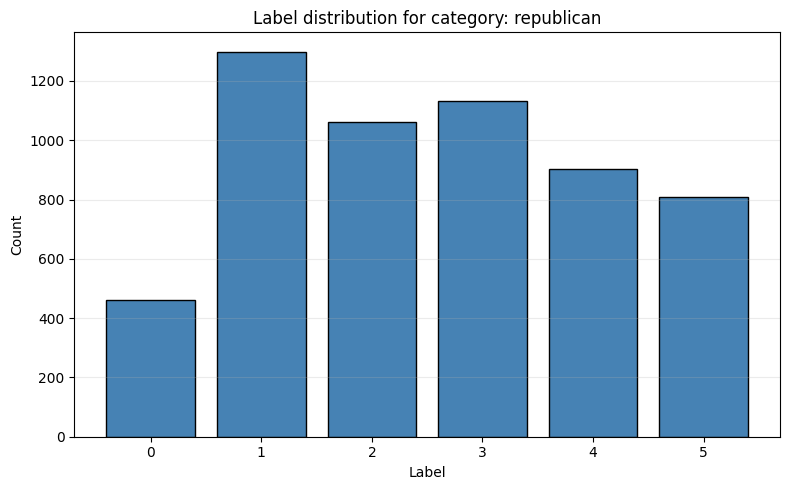

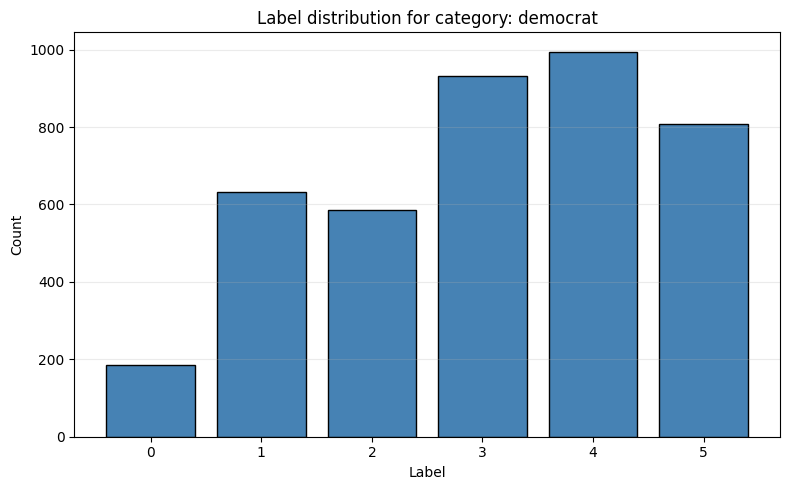

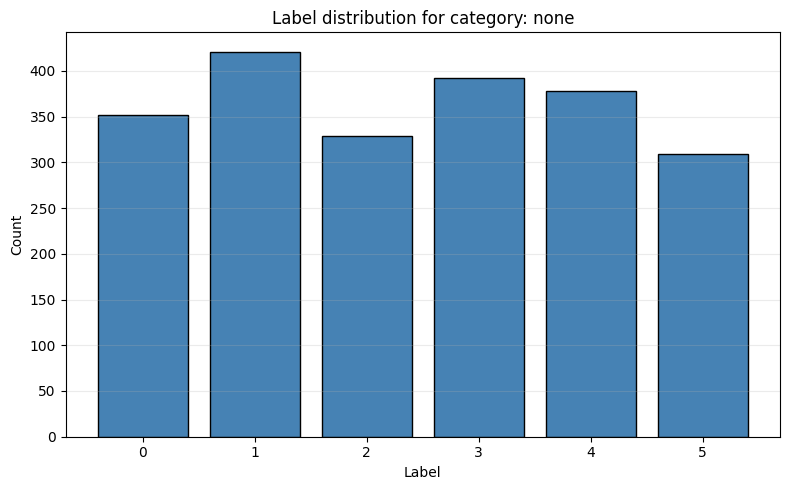

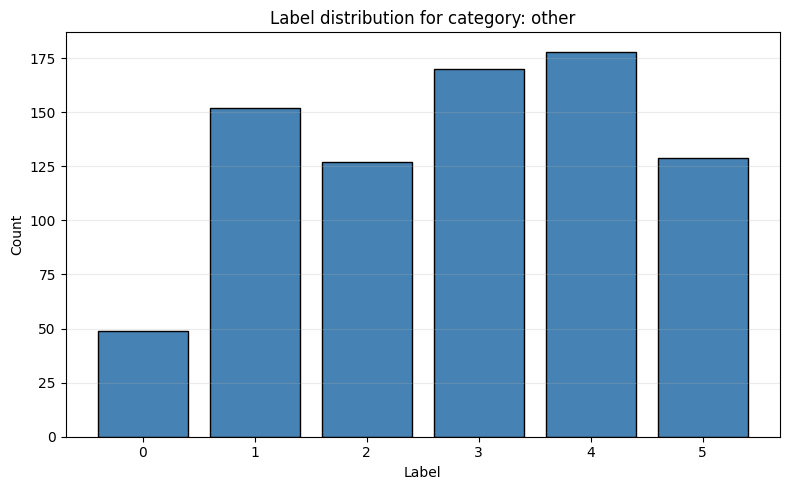

In [59]:
cats = temp_data['party_affiliation'].value_counts().index.tolist()
plot_bar_chart_for_category(temp_data, column_name = "party_affiliation", cats=cats)

We see interesting distribution between these, definetely not defined correlation, but looks to be informative

In [60]:
def plot_tree_feature_importance_non_numeric(data, non_numeric_col):
    num_cols = data.select_dtypes(include=np.number).columns.tolist()
    num_cols = [c for c in num_cols if c != "label"]
    cat_cols = [non_numeric_col]

    used_cols = num_cols + cat_cols + ["label"]
    temp_data = data[used_cols].dropna()

    X = temp_data[num_cols + cat_cols]
    y = temp_data["label"]

    preprocess = ColumnTransformer(
        transformers=[
            ("num", "passthrough", num_cols),
            ("cat", OneHotEncoder(handle_unknown="ignore", drop="first"), cat_cols),
        ],
        remainder="drop",
    )

    model = Pipeline(steps=[
        ("preprocess", preprocess),
        ("clf", DecisionTreeClassifier(random_state=42, max_depth=20)),
    ])

    model.fit(X, y)

    clf = model.named_steps["clf"]
    pre = model.named_steps["preprocess"]

    feature_names = pre.get_feature_names_out()

    importances = clf.feature_importances_
    imp = pd.Series(importances, index=feature_names).sort_values(ascending=False)

    plt.figure(figsize=(12, 8))
    imp.head(30).sort_values().plot(kind="barh", edgecolor="black")
    plt.title("Top 30 Feature Importances (ColumnTransformer)")
    plt.xlabel("Importance")
    plt.tight_layout()
    plt.show()


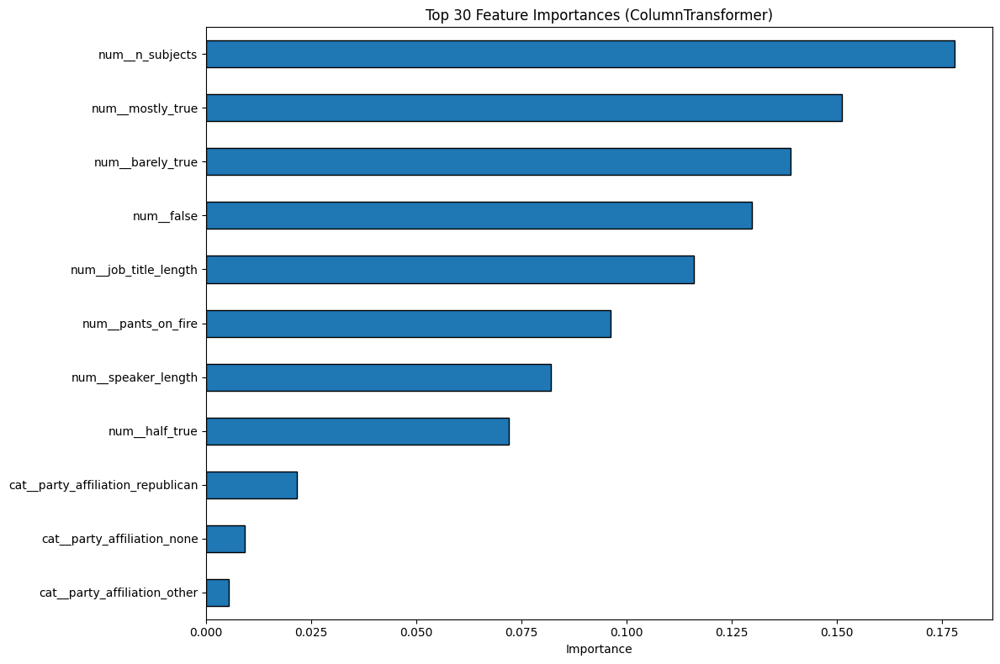

In [61]:
plot_tree_feature_importance_non_numeric(temp_data, 'party_affiliation')

Let us also compare test results in one model.

In [62]:
numerical_columns = data.select_dtypes(include=np.number).columns.tolist()
columns = numerical_columns + ['party_affiliation','job_title']
vectorizer = CountVectorizer(lowercase=True, ngram_range=(1, 2), stop_words="english", min_df=2)
preprocess = ColumnTransformer(
    transformers=[
        ('job_title', vectorizer, 'job_title'),
        ('party', OneHotEncoder(handle_unknown='ignore', drop='first'), ['party_affiliation']),
    ],
    remainder='drop',
)

In [63]:
# numerical_columns = data.select_dtypes(include=np.number).columns.tolist()
# columns = numerical_columns + ['party_affiliation','job_title']
# X_train, X_test, y_train, y_test = train_test_split(
#     temp_data[columns], temp_data['label'], test_size=0.2
# )
# temp_data.dropna(inplace=True)
# pipe = Pipeline([
#         ("preprocess", preprocess),
#         ("clf", MultinomialNB(alpha=1.0))
#     ])
# pipe.fit(X_train, y_train)
# pred = pipe.predict(X_test)
# print(name, "F1=", f1_score(y_test, pred, average="macro"))

In [64]:
# numerical_columns = data.select_dtypes(include=np.number).columns.tolist()
# preprocess = ColumnTransformer(
#     transformers=[
#         ('job_title', vectorizer, 'job_title'),
#     ],
#     remainder='drop',
# )
# columns = numerical_columns + ['job_title']
# X_train, X_test, y_train, y_test = train_test_split(
#     temp_data[columns], temp_data['label'], test_size=0.2
# )
# temp_data.dropna(inplace=True)
# pipe = Pipeline([
#         ("preprocess", preprocess),
#         ("clf", MultinomialNB(alpha=1.0))
#     ])
# pipe.fit(X_train, y_train)
# pred = pipe.predict(X_test)
# print(name, "F1=", f1_score(y_test, pred, average="weighted"))

We achieve lower f1 score, so the column will remain this way.

We will now see the state_info column

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\2265435923.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp_data['state_info'] = temp_data['state_info'].map(lambda x: x.strip().lower() if pd.notna(x) else '')


Text(0.5, 0, 'Number of Statements')

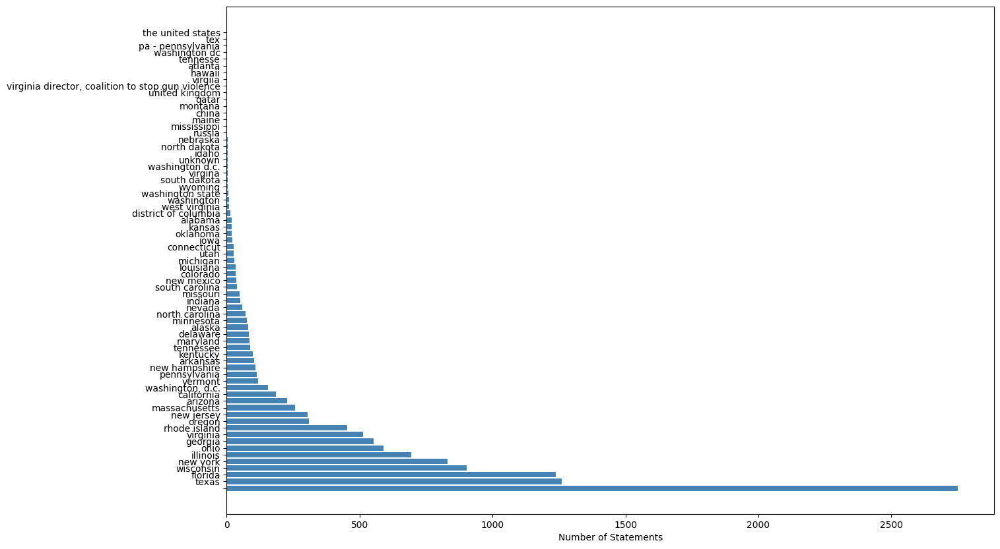

In [65]:
temp_data['state_info'] = temp_data['state_info'].map(lambda x: x.strip().lower() if pd.notna(x) else '')
unique_state_info = temp_data['state_info'].value_counts()
plt.figure(figsize=(15, 10))
plt.barh(unique_state_info.index, unique_state_info.values, color='steelblue')
plt.xlabel('Number of Statements')

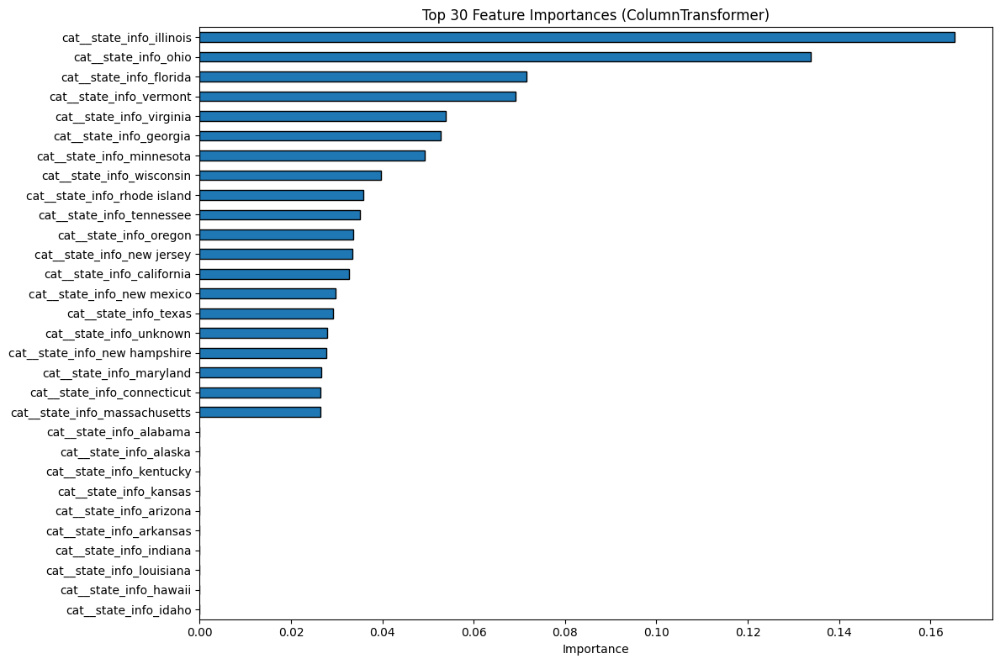

In [66]:
plot_tree_feature_importance_non_numeric(temp_data[['state_info', 'label']], 'state_info')

Let us first see which identical states are in different names

In [67]:
unique_state_info.index

Index(['', 'texas', 'florida', 'wisconsin', 'new york', 'illinois', 'ohio',
       'georgia', 'virginia', 'rhode island', 'oregon', 'new jersey',
       'massachusetts', 'arizona', 'california', 'washington, d.c.', 'vermont',
       'pennsylvania', 'new hampshire', 'arkansas', 'kentucky', 'tennessee',
       'maryland', 'delaware', 'alaska', 'minnesota', 'north carolina',
       'nevada', 'indiana', 'missouri', 'south carolina', 'new mexico',
       'colorado', 'louisiana', 'michigan', 'utah', 'connecticut', 'iowa',
       'oklahoma', 'kansas', 'alabama', 'district of columbia',
       'west virginia', 'washington', 'washington state', 'wyoming',
       'south dakota', 'virgina', 'washington d.c.', 'unknown', 'idaho',
       'north dakota', 'nebraska', 'russia', 'mississippi', 'maine', 'china',
       'montana', 'qatar', 'united kingdom',
       'virginia director, coalition to stop gun violence', 'virgiia',
       'hawaii', 'atlanta', 'tennesse', 'washington dc', 'pa - pennsylvania',


Firstly, let us map to washington all categories that contain washington

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1021248973.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp_data['state_info'] = temp_data['state_info'].apply(lambda x: 'washington' if 'washington' in x else x)


Index(['', 'texas', 'florida', 'wisconsin', 'new york', 'illinois', 'ohio',
       'georgia', 'virginia', 'rhode island', 'oregon', 'new jersey',
       'massachusetts', 'arizona', 'california', 'washington', 'vermont',
       'pennsylvania', 'new hampshire', 'arkansas', 'kentucky', 'tennessee',
       'maryland', 'delaware', 'alaska', 'minnesota', 'north carolina',
       'nevada', 'indiana', 'missouri', 'south carolina', 'new mexico',
       'colorado', 'louisiana', 'michigan', 'connecticut', 'utah', 'iowa',
       'oklahoma', 'kansas', 'alabama', 'district of columbia',
       'west virginia', 'wyoming', 'south dakota', 'nebraska', 'unknown',
       'north dakota', 'virgina', 'idaho', 'russia', 'mississippi', 'maine',
       'qatar', 'united kingdom', 'china', 'montana',
       'virginia director, coalition to stop gun violence', 'virgiia',
       'hawaii', 'atlanta', 'tennesse', 'pa - pennsylvania', 'tex',
       'the united states'],
      dtype='object', name='state_info')

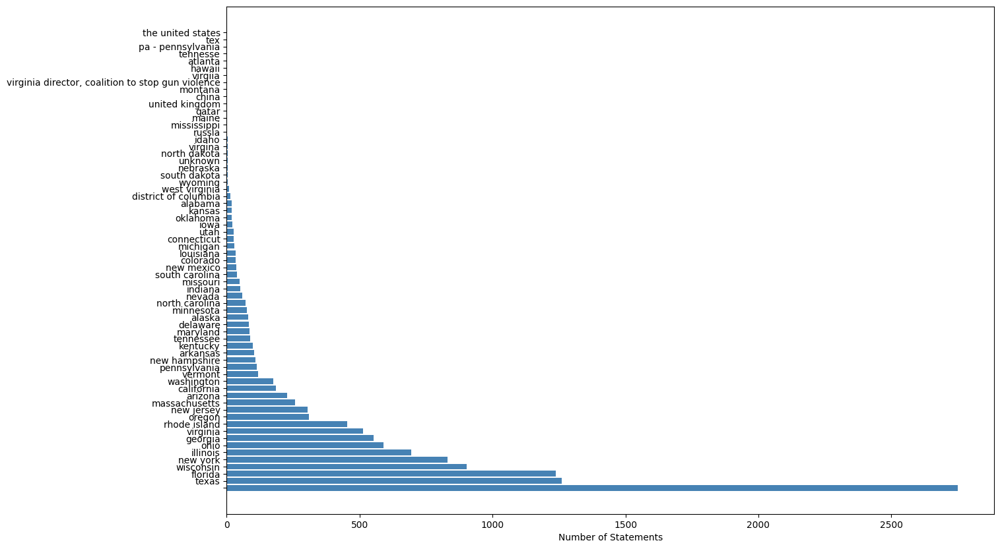

In [68]:
temp_data['state_info'] = temp_data['state_info'].apply(lambda x: 'washington' if 'washington' in x else x)
unique_state_info = temp_data['state_info'].value_counts()
plt.figure(figsize=(15, 10))
plt.barh(unique_state_info.index, unique_state_info.values, color='steelblue')
plt.xlabel('Number of Statements')
unique_state_info.index


In [69]:
top6_states = data['state_info'].value_counts().head(6).index.str.lower().tolist()

def categorize_state_info(x):
    if pd.isna(x) or str(x).strip() == "":
        return 'other'

    target = str(x).strip().lower()
    for state in top6_states:
        if state in target:
            return state
            
    return 'other'

temp_data['state_category'] = temp_data['state_info'].apply(categorize_state_info)

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1687138364.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp_data['state_category'] = temp_data['state_info'].apply(categorize_state_info)


it can be seen that there are some text errors and some states that are not states at all. There are some countries. I would like to check what is the label if 1 or 2 misplaced states.

In [70]:
print(temp_data[temp_data['state_info'] == 'tex']['label'])
print(temp_data[temp_data['state_info'] == 'tennesse']['label'])
print(temp_data[temp_data['state_info'] == 'virgiia']['label'])
print(temp_data[temp_data['state_info'] == 'pa - pennsylvania']['label'])


8723    1
Name: label, dtype: int64
7118    2
Name: label, dtype: int64
6022    5
Name: label, dtype: int64
8396    5
Name: label, dtype: int64


We see that strange and mispelled names do not necessary lead to false news.

In [71]:
valid_states = [
    'alabama', 'alaska', 'arizona', 'arkansas', 'california', 'colorado', 
    'connecticut', 'delaware', 'florida', 'georgia', 'hawaii', 'idaho', 
    'illinois', 'indiana', 'iowa', 'kansas', 'kentucky', 'louisiana', 
    'maine', 'maryland', 'massachusetts', 'michigan', 'minnesota', 
    'mississippi', 'missouri', 'montana', 'nebraska', 'nevada', 
    'new hampshire', 'new jersey', 'new mexico', 'new york', 
    'north carolina', 'north dakota', 'ohio', 'oklahoma', 'oregon', 
    'pennsylvania', 'rhode island', 'south carolina', 'south dakota', 
    'tennessee', 'texas', 'utah', 'vermont', 'virginia', 'washington', 
    'west virginia', 'wisconsin', 'wyoming', 'district of columbia'
]

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\2560666198.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp_data['is_state'] = temp_data['state_info'].apply(lambda x: 1 if x in valid_states else 0)


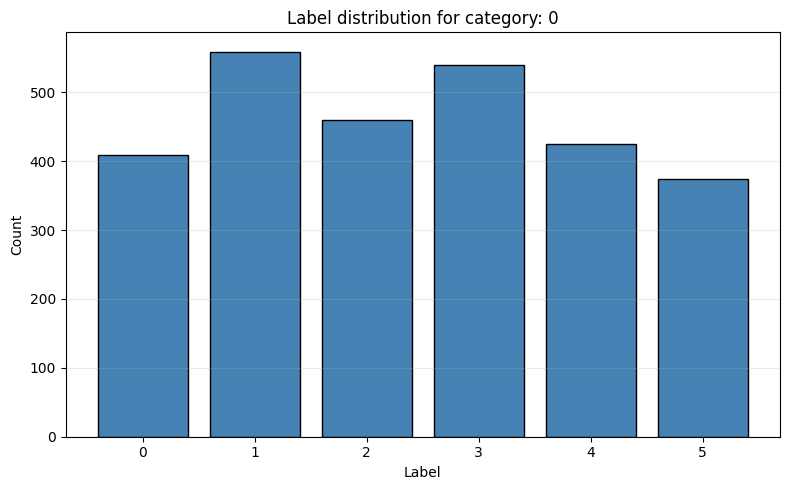

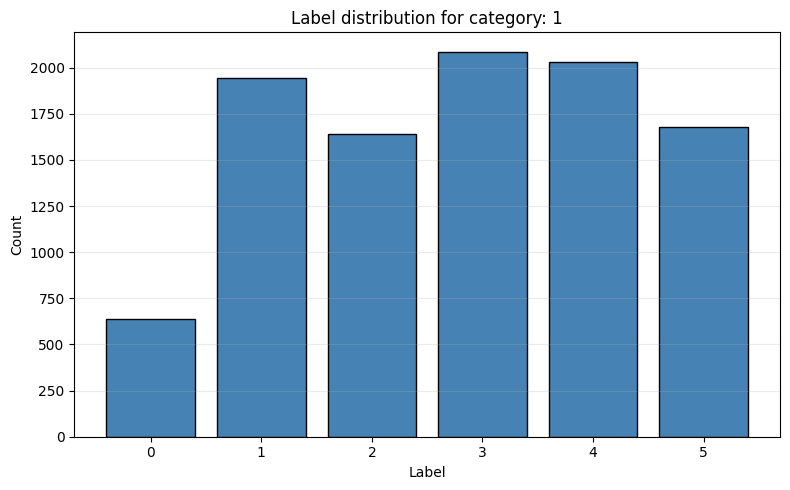

In [72]:
temp_data['is_state'] = temp_data['state_info'].apply(lambda x: 1 if x in valid_states else 0)
plot_bar_chart_for_category(temp_data, column_name = "is_state", cats=[0, 1])

We see that it could be benefitial for our model, because the distribution seems to be different this way. We will see the importances using decision tree.

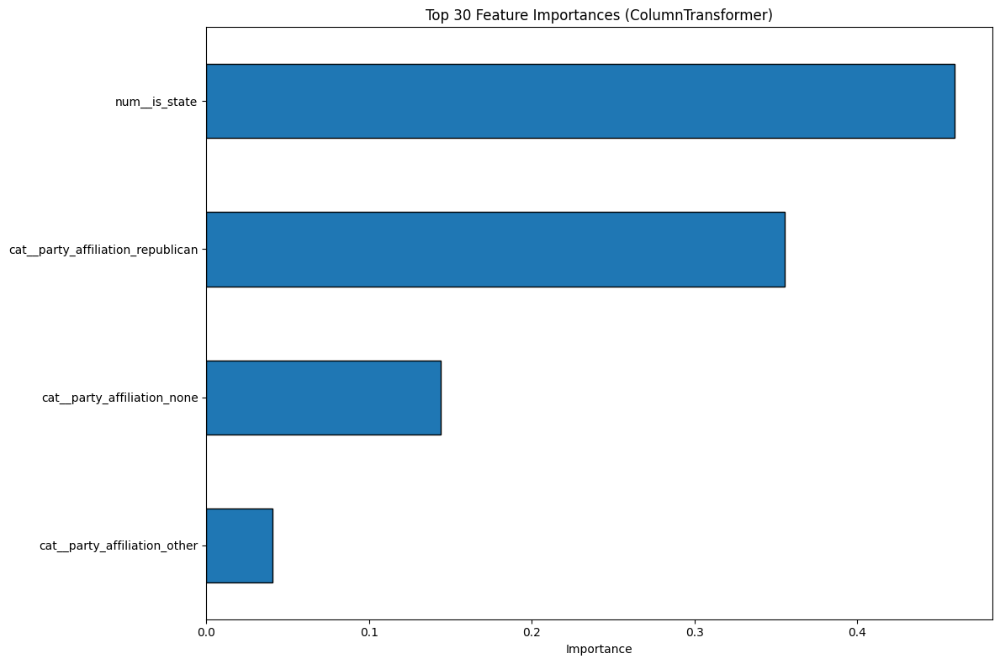

In [73]:
plot_tree_feature_importance_non_numeric(temp_data[['party_affiliation', 'is_state', 'label']], 'party_affiliation')

In [74]:
# numerical_columns = data.select_dtypes(include=np.number).columns.tolist()
# preprocess = ColumnTransformer(
#     transformers=[
#         ('job_title', vectorizer, 'job_title'),
#     ],
#     remainder='drop',
# )
# columns = numerical_columns + ['job_title']
# X_train, X_test, y_train, y_test = train_test_split(
#     temp_data[columns], temp_data['label'], test_size=0.2
# )
# temp_data.dropna(inplace=True)
# pipe = Pipeline([
#         ("preprocess", preprocess),
#         ("clf", DecisionTreeClassifier(random_state=42, max_depth=20))
#     ])
# pipe.fit(X_train, y_train)
# pred = pipe.predict(X_test)
# print(name, "F1=", f1_score(y_test, pred, average="weighted"))
# temp_data

In [75]:
X_train, X_test, y_train, y_test = train_test_split(
    temp_data[['is_state']], temp_data['label'], test_size=0.2
)
temp_data.dropna(inplace=True)
pipe = Pipeline([
        ("clf", MultinomialNB(alpha=1.0))
    ])
pipe.fit(X_train, y_train)
pred = pipe.predict(X_test)
print(name, "F1=", f1_score(y_test, pred, average="weighted"))
temp_data

word_1_2_stop F1= 0.07787208355243425


C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\2695437368.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp_data.dropna(inplace=True)


,label,statement,job_title,state_info,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,context,n_subjects,speaker_length,job_title_length,state_category,is_state
0,1,Says the Annies List political group supports ...,State representative,texas,republican,0.0,1.0,0.0,0.0,0.0,a mailer,1,12,20.0,texas,1
1,3,When did the decline of coal start? It started...,State delegate,virginia,democrat,0.0,0.0,1.0,1.0,0.0,a floor speech.,3,14,14.0,other,1
2,4,"Hillary Clinton agrees with John McCain ""by vo...",President,illinois,democrat,70.0,71.0,160.0,163.0,9.0,Denver,1,12,9.0,illinois,1
5,5,The Chicago Bears have had more starting quart...,Wisconsin Assembly speaker,wisconsin,republican,0.0,3.0,2.0,5.0,1.0,a an online opinion-piece,1,9,26.0,wisconsin,1
7,3,I'm the only person on this stage who has work...,President,illinois,democrat,70.0,71.0,160.0,163.0,9.0,"a Democratic debate in Philadelphia, Pa.",1,12,9.0,illinois,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12783,2,We came out of the White House not only dead b...,Presidential candidate,new york,democrat,40.0,29.0,69.0,76.0,7.0,an interview on ABC,2,15,22.0,new york,1
12786,3,Says his budget provides the highest state fun...,Governor,florida,republican,28.0,23.0,38.0,34.0,7.0,a news conference,1,10,8.0,florida,1
12787,2,Ive been here almost every day.,Governor,missouri,democrat,2.0,0.0,0.0,1.0,0.0,"on ABC's ""This Week""",3,9,8.0,other,1
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...","senior fellow, Foreign Policy Research Institute",rhode island,other,1.0,0.0,0.0,0.0,0.0,a commentary in The Providence Journal,4,21,48.0,other,1


It gives us information but let us try combine it with other feature. As we saw earlier, illinois and ohio make most of the feature importance, so let us see them.

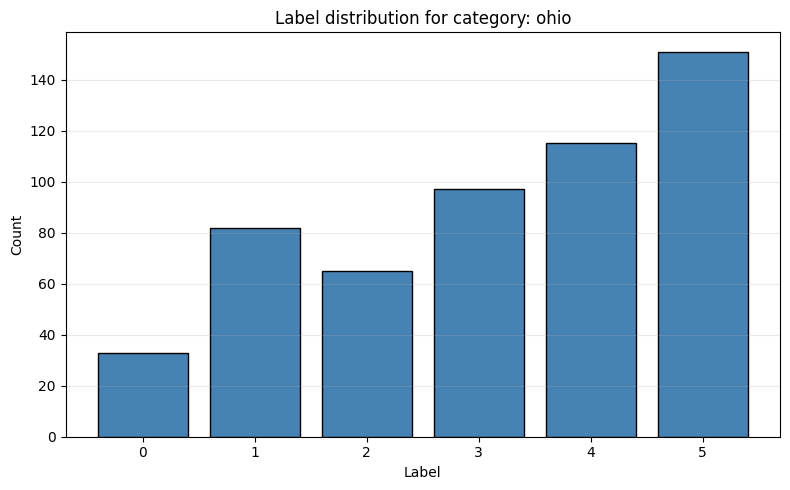

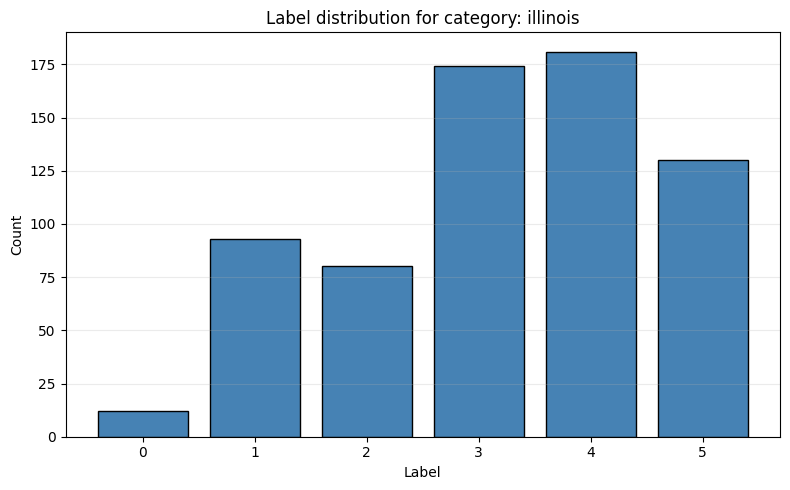

In [76]:
plot_bar_chart_for_category(temp_data, column_name = "state_info", cats=['ohio', 'illinois'])

Ohio gives us a lot of true news as it seems while illinois reduces the pants-fire false news. Maybe we should try using only the first 6 states as they look to bring the most of the information.

In [77]:
temp_data['state_category'] = temp_data['state_info'].apply(categorize_state_info)
temp_data

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1458442586.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp_data['state_category'] = temp_data['state_info'].apply(categorize_state_info)


,label,statement,job_title,state_info,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,context,n_subjects,speaker_length,job_title_length,state_category,is_state
0,1,Says the Annies List political group supports ...,State representative,texas,republican,0.0,1.0,0.0,0.0,0.0,a mailer,1,12,20.0,texas,1
1,3,When did the decline of coal start? It started...,State delegate,virginia,democrat,0.0,0.0,1.0,1.0,0.0,a floor speech.,3,14,14.0,other,1
2,4,"Hillary Clinton agrees with John McCain ""by vo...",President,illinois,democrat,70.0,71.0,160.0,163.0,9.0,Denver,1,12,9.0,illinois,1
5,5,The Chicago Bears have had more starting quart...,Wisconsin Assembly speaker,wisconsin,republican,0.0,3.0,2.0,5.0,1.0,a an online opinion-piece,1,9,26.0,wisconsin,1
7,3,I'm the only person on this stage who has work...,President,illinois,democrat,70.0,71.0,160.0,163.0,9.0,"a Democratic debate in Philadelphia, Pa.",1,12,9.0,illinois,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12783,2,We came out of the White House not only dead b...,Presidential candidate,new york,democrat,40.0,29.0,69.0,76.0,7.0,an interview on ABC,2,15,22.0,new york,1
12786,3,Says his budget provides the highest state fun...,Governor,florida,republican,28.0,23.0,38.0,34.0,7.0,a news conference,1,10,8.0,florida,1
12787,2,Ive been here almost every day.,Governor,missouri,democrat,2.0,0.0,0.0,1.0,0.0,"on ABC's ""This Week""",3,9,8.0,other,1
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...","senior fellow, Foreign Policy Research Institute",rhode island,other,1.0,0.0,0.0,0.0,0.0,a commentary in The Providence Journal,4,21,48.0,other,1


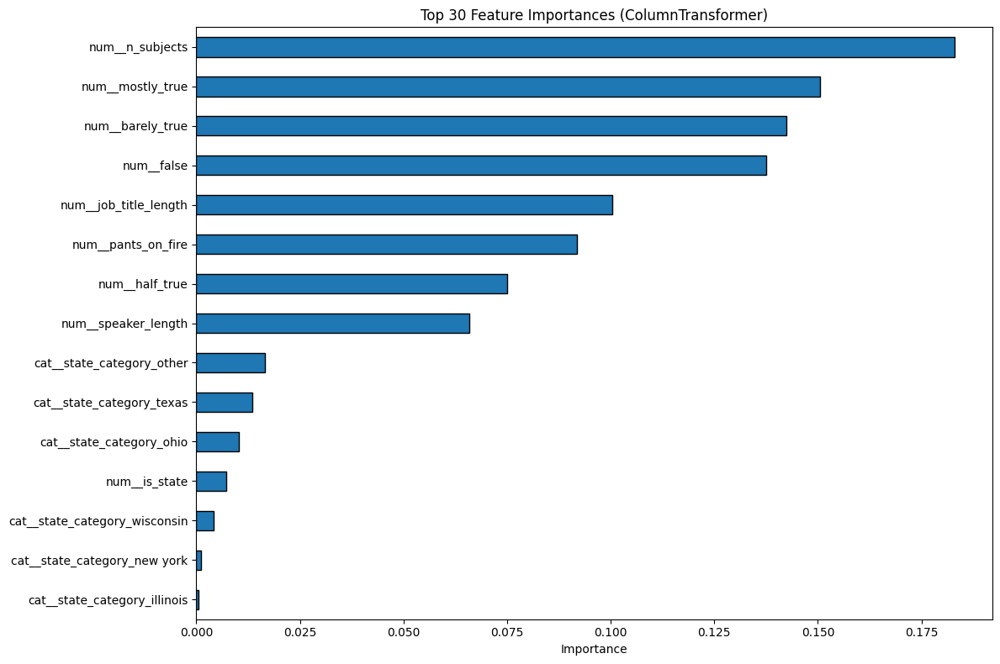

In [78]:
plot_tree_feature_importance_non_numeric(temp_data, 'state_category')

In [79]:
X_train, X_test, y_train, y_test = train_test_split(
    temp_data[['is_state', 'state_category']], temp_data['label'], test_size=0.2
)
transformer = ColumnTransformer(
    transformers=[
        ('state_category', OneHotEncoder(handle_unknown='ignore', drop='first'), ['state_category']),
    ],
    remainder='passthrough',
)
temp_data.dropna(inplace=True)
pipe = Pipeline([
        ("preprocessor", transformer),
        ("clf", MultinomialNB(alpha=1.0))
    ])
pipe.fit(X_train, y_train)
pred = pipe.predict(X_test)
print(name, "F1=", f1_score(y_test, pred, average="weighted"))
temp_data

word_1_2_stop F1= 0.18166055792373728


C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\725225872.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp_data.dropna(inplace=True)


,label,statement,job_title,state_info,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,context,n_subjects,speaker_length,job_title_length,state_category,is_state
0,1,Says the Annies List political group supports ...,State representative,texas,republican,0.0,1.0,0.0,0.0,0.0,a mailer,1,12,20.0,texas,1
1,3,When did the decline of coal start? It started...,State delegate,virginia,democrat,0.0,0.0,1.0,1.0,0.0,a floor speech.,3,14,14.0,other,1
2,4,"Hillary Clinton agrees with John McCain ""by vo...",President,illinois,democrat,70.0,71.0,160.0,163.0,9.0,Denver,1,12,9.0,illinois,1
5,5,The Chicago Bears have had more starting quart...,Wisconsin Assembly speaker,wisconsin,republican,0.0,3.0,2.0,5.0,1.0,a an online opinion-piece,1,9,26.0,wisconsin,1
7,3,I'm the only person on this stage who has work...,President,illinois,democrat,70.0,71.0,160.0,163.0,9.0,"a Democratic debate in Philadelphia, Pa.",1,12,9.0,illinois,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12783,2,We came out of the White House not only dead b...,Presidential candidate,new york,democrat,40.0,29.0,69.0,76.0,7.0,an interview on ABC,2,15,22.0,new york,1
12786,3,Says his budget provides the highest state fun...,Governor,florida,republican,28.0,23.0,38.0,34.0,7.0,a news conference,1,10,8.0,florida,1
12787,2,Ive been here almost every day.,Governor,missouri,democrat,2.0,0.0,0.0,1.0,0.0,"on ABC's ""This Week""",3,9,8.0,other,1
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...","senior fellow, Foreign Policy Research Institute",rhode island,other,1.0,0.0,0.0,0.0,0.0,a commentary in The Providence Journal,4,21,48.0,other,1


We can see that this categorizing does not really contribute significantly to our model, so we will stick with it but it is very probable that the new columns would not play a role in our future models

In [80]:

keywords = ['republican', 'democrat', 'none']
def map_party(x):
    if not pd.isna(x):
        s = str(x).lower().strip()
        for k in keywords:
            if k in s:
                return k
        return 'other'
data['party_affiliation'] = data['party_affiliation'].apply(map_party)
data['is_state'] = data['state_info'].apply(lambda x: 1 if x in valid_states else 0)
data['state_category'] = data['state_info'].apply(categorize_state_info)

data

,label,statement,job_title,state_info,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,context,n_subjects,speaker_length,job_title_length,is_state,state_category
0,1,Says the Annies List political group supports ...,State representative,Texas,republican,0.0,1.0,0.0,0.0,0.0,a mailer,1,12,20.0,0,texas
1,3,When did the decline of coal start? It started...,State delegate,Virginia,democrat,0.0,0.0,1.0,1.0,0.0,a floor speech.,3,14,14.0,0,other
2,4,"Hillary Clinton agrees with John McCain ""by vo...",President,Illinois,democrat,70.0,71.0,160.0,163.0,9.0,Denver,1,12,9.0,0,illinois
3,1,Health care reform legislation is likely to ma...,NaN,NaN,none,7.0,19.0,3.0,5.0,44.0,a news release,1,12,NaN,0,other
4,3,The economic turnaround started at the end of ...,NaN,Florida,democrat,15.0,9.0,20.0,19.0,2.0,an interview on CNN,2,13,NaN,0,florida
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,Governor,Florida,republican,28.0,23.0,38.0,34.0,7.0,a news conference,1,10,8.0,0,florida
12787,2,Ive been here almost every day.,Governor,Missouri,democrat,2.0,0.0,0.0,1.0,0.0,"on ABC's ""This Week""",3,9,8.0,0,other
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...","senior fellow, Foreign Policy Research Institute",Rhode Island,other,1.0,0.0,0.0,0.0,0.0,a commentary in The Providence Journal,4,21,48.0,0,other
12789,2,Says an EPA permit languished under Strickland...,"Governor of Ohio as of Jan. 10, 2011",Ohio,republican,9.0,8.0,10.0,18.0,3.0,a news conference,2,11,36.0,0,ohio


Now we will analyze the initial numerical features a little further. A it is said that the total credit history involces the current statement, We should substract from the columns to avoid data leakage.

In [81]:
for index, row in data.iterrows():
    if row['label'] == 0 and data.at[index, 'pants_on_fire'] > 0:
        data.at[index, 'pants_on_fire'] -= 1
    elif row['label'] == 1 and data.at[index, 'false'] > 0:
        data.at[index, 'false'] -= 1
    elif row['label'] == 2 and data.at[index, 'barely_true'] > 0:
        data.at[index, 'barely_true'] -= 1
    elif row['label'] == 3 and data.at[index, 'half_true'] > 0:
        data.at[index, 'half_true'] -= 1
    elif row['label'] == 4 and data.at[index, 'mostly_true'] > 0:
        data.at[index, 'mostly_true'] -= 1

In [82]:
data

,label,statement,job_title,state_info,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,context,n_subjects,speaker_length,job_title_length,is_state,state_category
0,1,Says the Annies List political group supports ...,State representative,Texas,republican,0.0,0.0,0.0,0.0,0.0,a mailer,1,12,20.0,0,texas
1,3,When did the decline of coal start? It started...,State delegate,Virginia,democrat,0.0,0.0,0.0,1.0,0.0,a floor speech.,3,14,14.0,0,other
2,4,"Hillary Clinton agrees with John McCain ""by vo...",President,Illinois,democrat,70.0,71.0,160.0,162.0,9.0,Denver,1,12,9.0,0,illinois
3,1,Health care reform legislation is likely to ma...,NaN,NaN,none,7.0,18.0,3.0,5.0,44.0,a news release,1,12,NaN,0,other
4,3,The economic turnaround started at the end of ...,NaN,Florida,democrat,15.0,9.0,19.0,19.0,2.0,an interview on CNN,2,13,NaN,0,florida
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,Governor,Florida,republican,28.0,23.0,37.0,34.0,7.0,a news conference,1,10,8.0,0,florida
12787,2,Ive been here almost every day.,Governor,Missouri,democrat,1.0,0.0,0.0,1.0,0.0,"on ABC's ""This Week""",3,9,8.0,0,other
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...","senior fellow, Foreign Policy Research Institute",Rhode Island,other,0.0,0.0,0.0,0.0,0.0,a commentary in The Providence Journal,4,21,48.0,0,other
12789,2,Says an EPA permit languished under Strickland...,"Governor of Ohio as of Jan. 10, 2011",Ohio,republican,8.0,8.0,10.0,18.0,3.0,a news conference,2,11,36.0,0,ohio


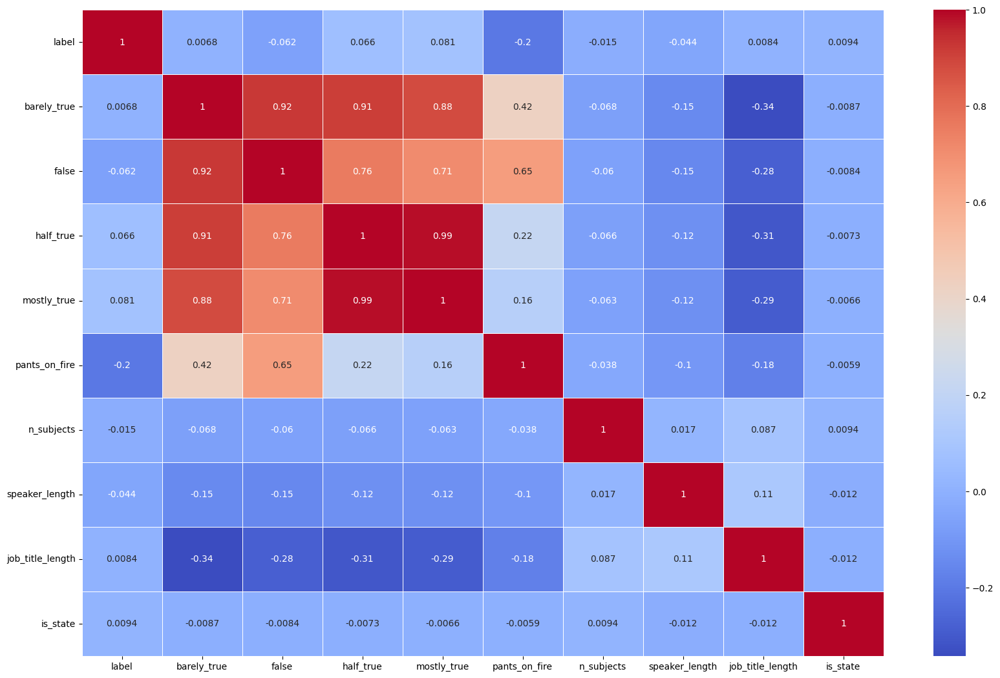

In [83]:
plt.figure(figsize=(20, 13))
sns.heatmap(data[data.select_dtypes(include=['number']).columns].corr(), annot=True, cmap="coolwarm", linewidths=0.5)
plt.show()

The correlation with label doesnt seem high, but it is expected to not have linearity

Let us see if we can create an index for the numerical columns about how truthful the authors who made the statements are.

In [ ]:

weights = {
    'pants_on_fire': 0,
    'false': 0.2,
    'barely_true': 0.4,
    'half_true': 0.6,
    'mostly_true': 0.8
}

data['total_history'] = data[['barely_true', 'false', 'half_true', 'mostly_true', 'pants_on_fire']].sum(axis=1)

data['truth_index'] = (
    (data['pants_on_fire'] * weights['pants_on_fire']) +
    (data['false'] * weights['false']) +
    (data['barely_true'] * weights['barely_true']) +
    (data['half_true'] * weights['half_true']) +
    (data['mostly_true'] * weights['mostly_true'])
) / (data['total_history'] + 1)

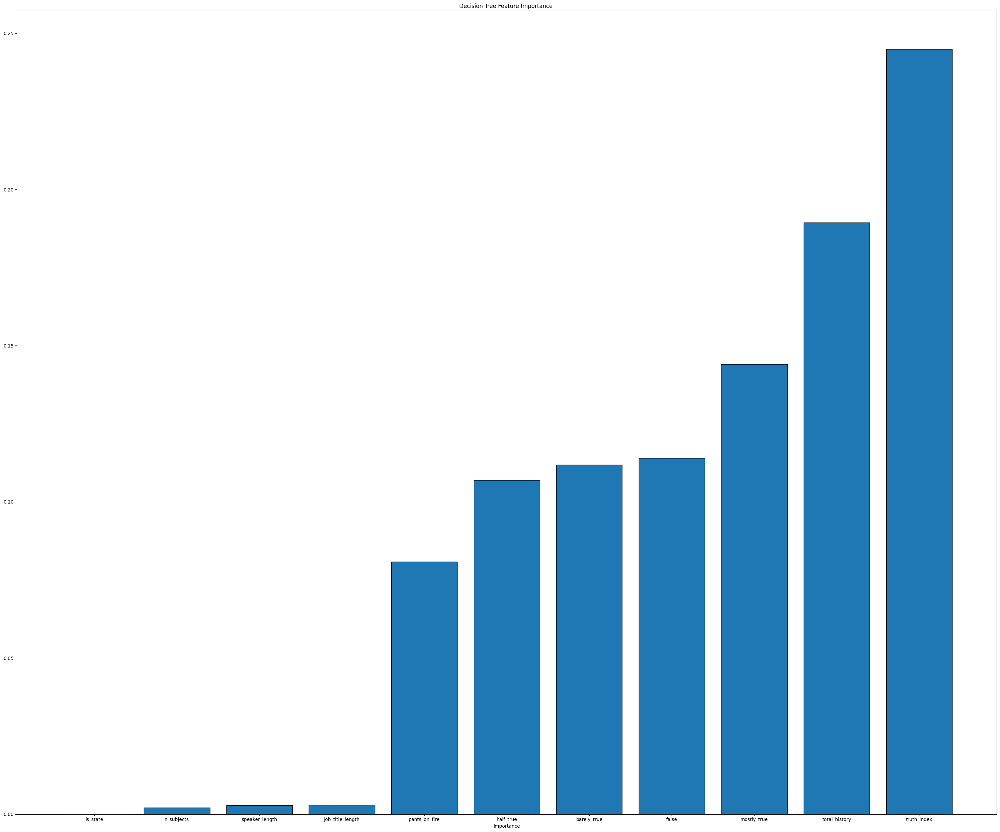

In [85]:
plot_tree_feature_importance(data)

We see that these two might be two of the most important features, while is_state seems unsignificant

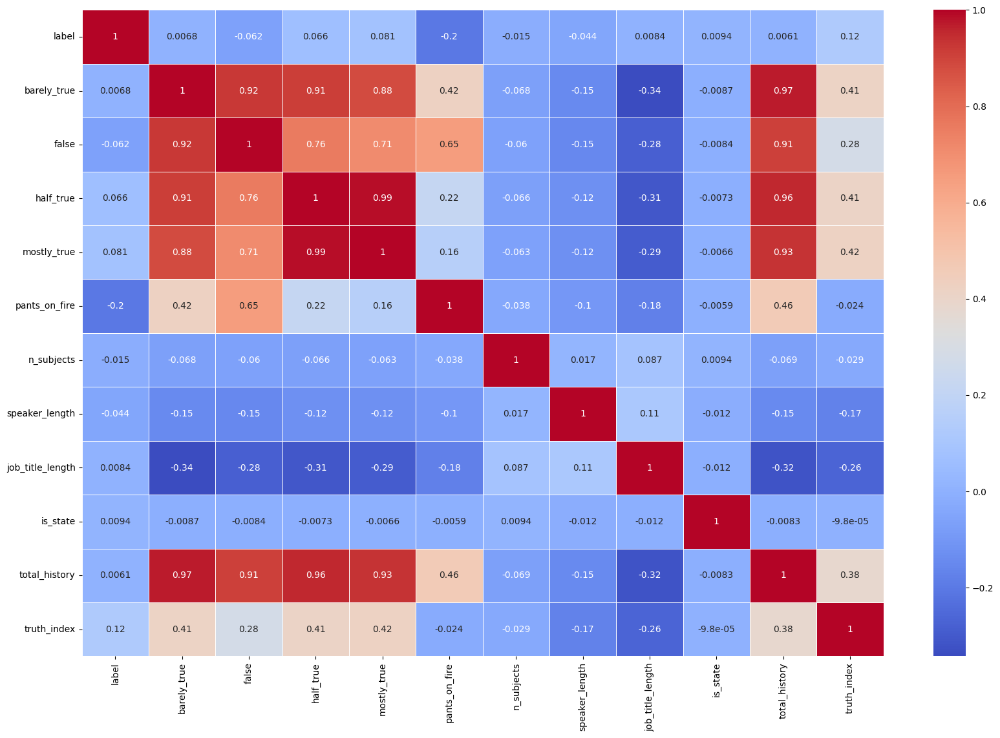

In [86]:
plt.figure(figsize=(20, 13))
sns.heatmap(data[data.select_dtypes(include=['number']).columns].corr(), annot=True, cmap="coolwarm", linewidths=0.5)
plt.show()

The truth index seems to have the highest correlation with the target column out of all our features till now.

So we see that total history and truth_index are very benefitial so they would definetely be added to our features. We will leave the other initial numeric columns and will see in the model experiments if we should remove them.

In [87]:
data

,label,statement,job_title,state_info,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,context,n_subjects,speaker_length,job_title_length,is_state,state_category,total_history,truth_index
0,1,Says the Annies List political group supports ...,State representative,Texas,republican,0.0,0.0,0.0,0.0,0.0,a mailer,1,12,20.0,0,texas,0.0,0.000000
1,3,When did the decline of coal start? It started...,State delegate,Virginia,democrat,0.0,0.0,0.0,1.0,0.0,a floor speech.,3,14,14.0,0,other,1.0,0.400000
2,4,"Hillary Clinton agrees with John McCain ""by vo...",President,Illinois,democrat,70.0,71.0,160.0,162.0,9.0,Denver,1,12,9.0,0,illinois,472.0,0.566173
3,1,Health care reform legislation is likely to ma...,NaN,NaN,none,7.0,18.0,3.0,5.0,44.0,a news release,1,12,NaN,0,other,77.0,0.156410
4,3,The economic turnaround started at the end of ...,NaN,Florida,democrat,15.0,9.0,19.0,19.0,2.0,an interview on CNN,2,13,NaN,0,florida,64.0,0.529231
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,Governor,Florida,republican,28.0,23.0,37.0,34.0,7.0,a news conference,1,10,8.0,0,florida,129.0,0.501538
12787,2,Ive been here almost every day.,Governor,Missouri,democrat,1.0,0.0,0.0,1.0,0.0,"on ABC's ""This Week""",3,9,8.0,0,other,2.0,0.400000
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...","senior fellow, Foreign Policy Research Institute",Rhode Island,other,0.0,0.0,0.0,0.0,0.0,a commentary in The Providence Journal,4,21,48.0,0,other,0.0,0.000000
12789,2,Says an EPA permit languished under Strickland...,"Governor of Ohio as of Jan. 10, 2011",Ohio,republican,8.0,8.0,10.0,18.0,3.0,a news conference,2,11,36.0,0,ohio,47.0,0.525000


In [88]:
data['state_info'].isna().sum()

np.int64(2751)

We will now look at the last column which is context.

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


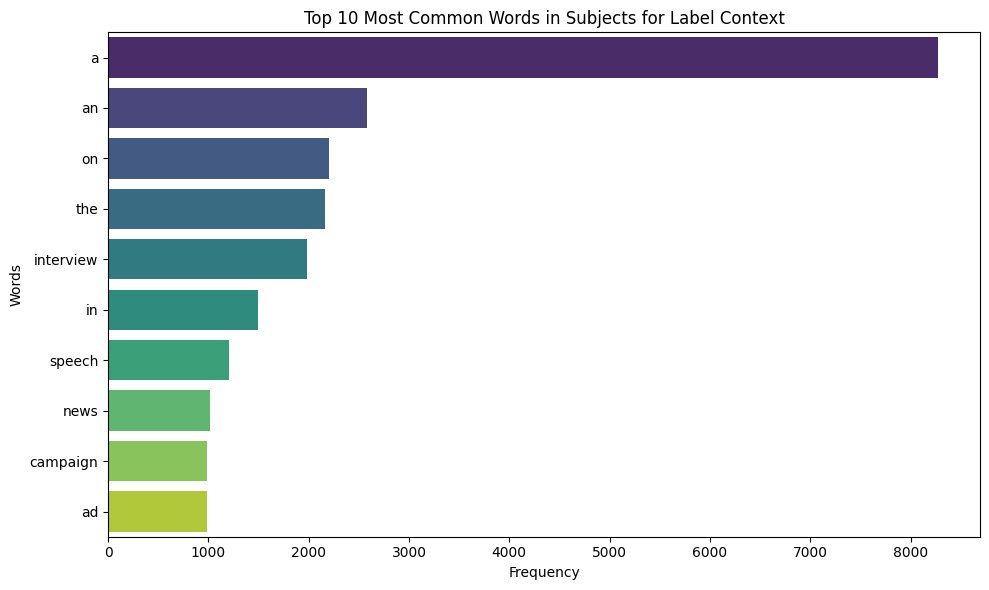

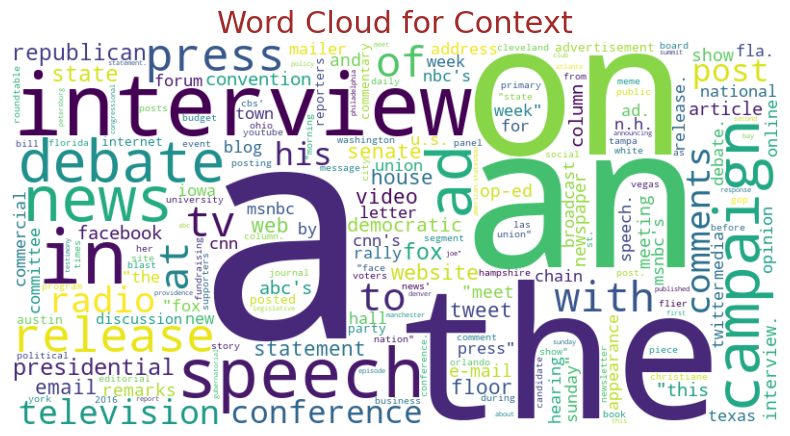

In [89]:
word_counter = count_word_frequencies(data['context'])
plot_bar_chart_for_most_common_words(word_counter, label='Context')
create_word_cloud(word_counter, label='Context')

We can see that it is full of stopwords, so we should try to remove them.

In [90]:
stop_words = set(stopwords.words('english'))

def preprocess_text(text):
    if pd.isna(text):
        return ''
    text = str(text).lower()
    text = re.sub(r'[^\w\s]', '', text)
    tokens = text.split()
    tokens = [t for t in tokens if t not in stop_words]
    return ' '.join(tokens)

data['context_processed'] = data['context'].apply(preprocess_text)
data['context_processed'].isna().sum()


np.int64(0)

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


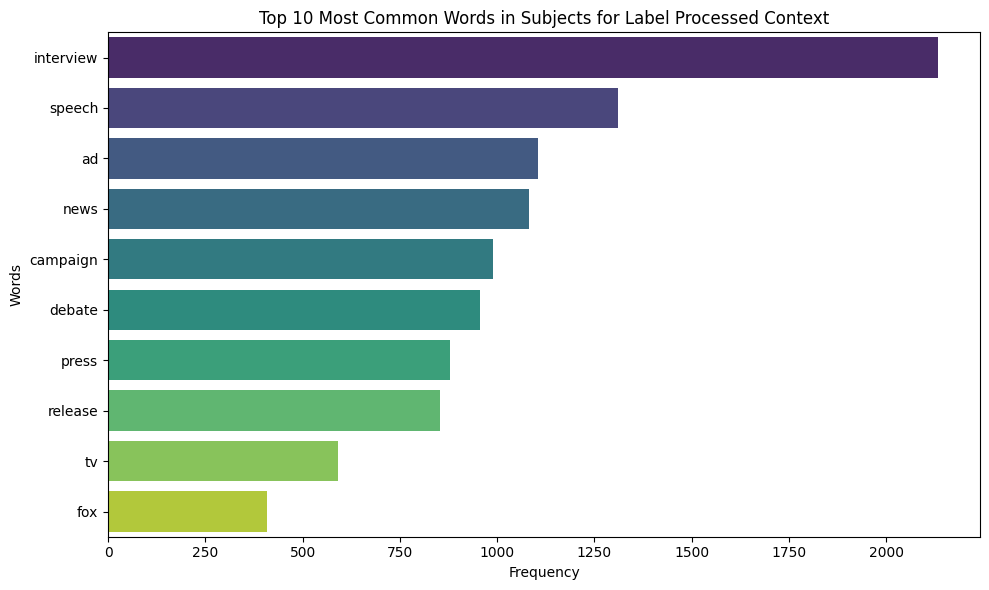

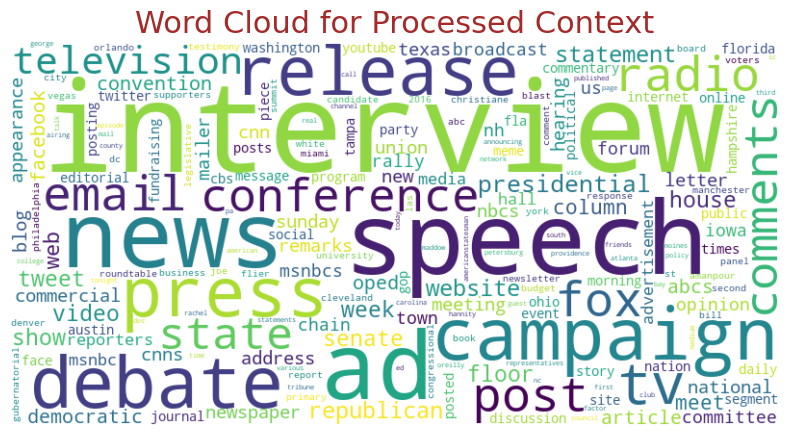

2524


In [91]:
word_counter = count_word_frequencies(data['context_processed'])
plot_bar_chart_for_most_common_words(word_counter, label='Processed Context')
create_word_cloud(word_counter, label='Processed Context')
print(len(word_counter))

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


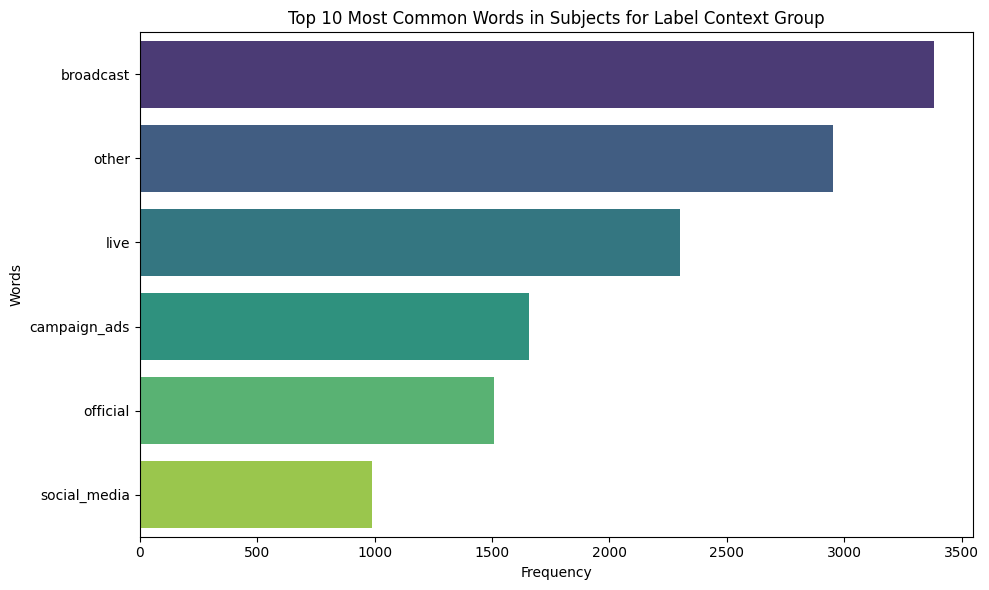

In [92]:
def categorize_context(text):
    text = str(text).lower()
    if any(word in text for word in ['facebook', 'twitter', 'tweet', 'post', 'social media']):
        return 'social_media'
    if any(word in text for word in ['tv', 'interview', 'cnn', 'abc', 'nbc', 'fox', 'tv', 'radio']):
        return 'broadcast'
    if any(word in text for word in ['news release', 'press', 'statement', 'newspaper']):
        return 'official'
    if any(word in text for word in ['mailer', 'flyer', 'ad', 'advertisement', 'commercial', 'campaign']):
        return 'campaign_ads'
    if any(word in text for word in ['speech', 'floor speech', 'debate', 'rally', 'conference']):
        return 'live'
    return 'other'

data['context_group'] = data['context'].apply(categorize_context)
word_counter = data['context_group'].value_counts()
plot_bar_chart_for_most_common_words(word_counter, label='Context Group')

We will now see the most common words in others

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


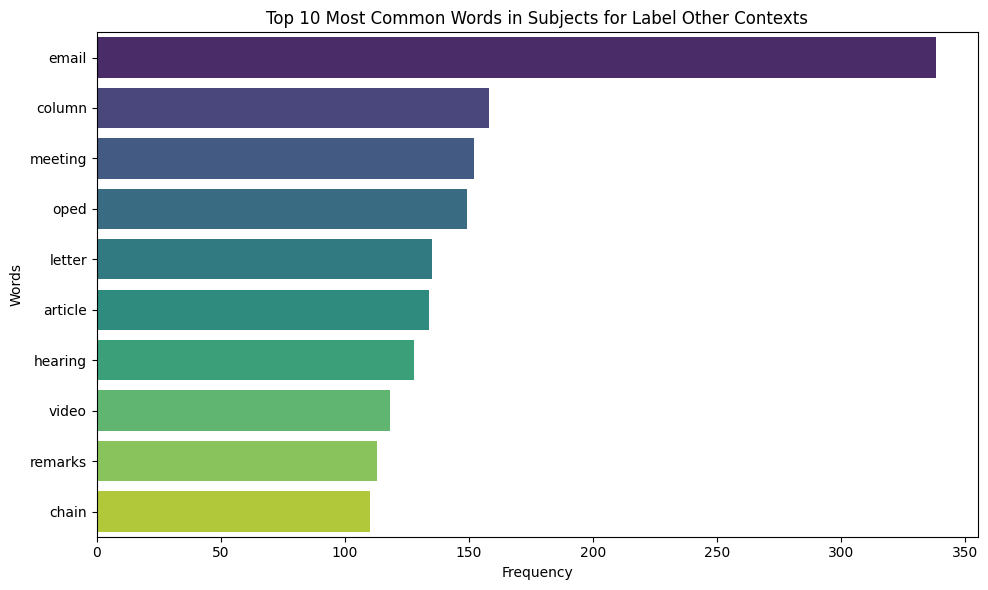

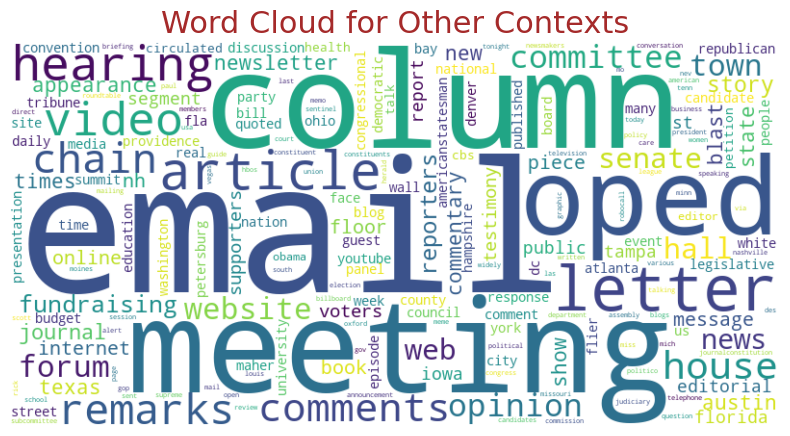

In [93]:
others_counter = count_word_frequencies(data.loc[data['context_group'] == 'other', 'context_processed'])
plot_bar_chart_for_most_common_words(others_counter, label='Other Contexts')
create_word_cloud(others_counter, label='Other Contexts')

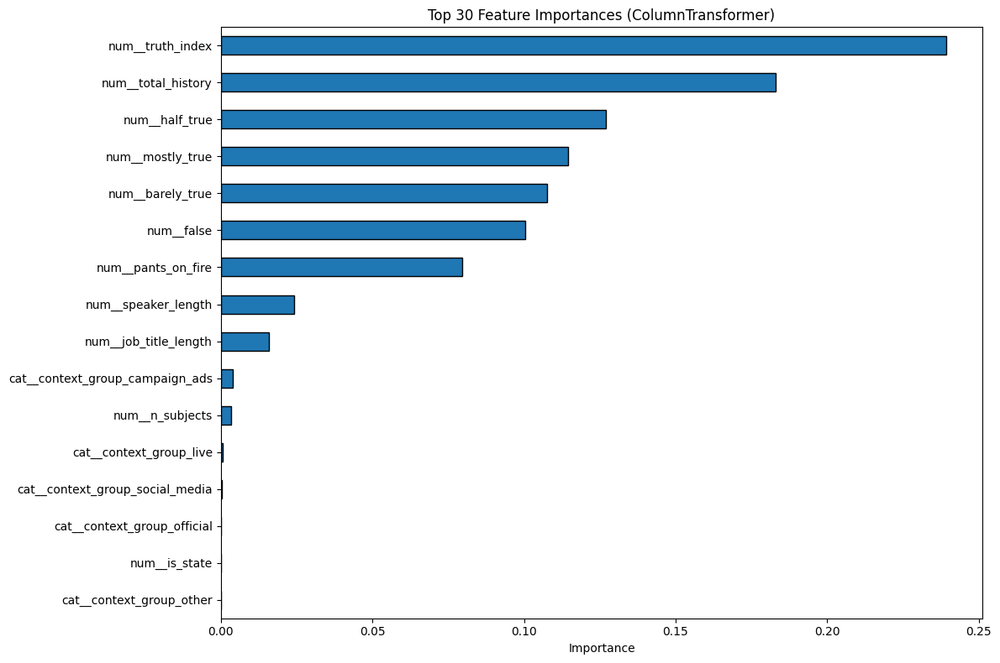

In [94]:
plot_tree_feature_importance_non_numeric(data, 'context_group')

We see that we does not really have a good importance from these features

In [95]:
numerical_columns = data.select_dtypes(include=np.number).columns.tolist()
columns = numerical_columns + ['context_group']
columns.remove('label')
X_train, X_test, y_train, y_test = train_test_split(
    data[columns], data['label'], test_size=0.2, random_state=42)
transformer = ColumnTransformer(
    transformers=[
        ('context_group', OneHotEncoder(handle_unknown='ignore', drop='first'), ['context_group']),
    ],
    remainder='passthrough',
)
pipe = Pipeline([
        ("preprocessor", transformer),
        ("clf", DecisionTreeClassifier(random_state=42, max_depth=20))
    ])

pipe.fit(X_train, y_train)
pred = pipe.predict(X_test)
print("F1=", f1_score(y_test, pred, average="weighted"))


F1= 0.42510582653523593


We see a ~ 41 f1 score, but that is mainly because of the truth index and the total history column. However, we cannot lie about the insignificance of the is_state column. It is better for everyone if we just removed it.

In [96]:
data.drop(columns=['is_state'], inplace=True)


In [97]:
data

,label,statement,job_title,state_info,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,context,n_subjects,speaker_length,job_title_length,state_category,total_history,truth_index,context_processed,context_group
0,1,Says the Annies List political group supports ...,State representative,Texas,republican,0.0,0.0,0.0,0.0,0.0,a mailer,1,12,20.0,texas,0.0,0.000000,mailer,campaign_ads
1,3,When did the decline of coal start? It started...,State delegate,Virginia,democrat,0.0,0.0,0.0,1.0,0.0,a floor speech.,3,14,14.0,other,1.0,0.400000,floor speech,live
2,4,"Hillary Clinton agrees with John McCain ""by vo...",President,Illinois,democrat,70.0,71.0,160.0,162.0,9.0,Denver,1,12,9.0,illinois,472.0,0.566173,denver,other
3,1,Health care reform legislation is likely to ma...,NaN,NaN,none,7.0,18.0,3.0,5.0,44.0,a news release,1,12,NaN,other,77.0,0.156410,news release,official
4,3,The economic turnaround started at the end of ...,NaN,Florida,democrat,15.0,9.0,19.0,19.0,2.0,an interview on CNN,2,13,NaN,florida,64.0,0.529231,interview cnn,broadcast
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,Governor,Florida,republican,28.0,23.0,37.0,34.0,7.0,a news conference,1,10,8.0,florida,129.0,0.501538,news conference,live
12787,2,Ive been here almost every day.,Governor,Missouri,democrat,1.0,0.0,0.0,1.0,0.0,"on ABC's ""This Week""",3,9,8.0,other,2.0,0.400000,abcs week,broadcast
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...","senior fellow, Foreign Policy Research Institute",Rhode Island,other,0.0,0.0,0.0,0.0,0.0,a commentary in The Providence Journal,4,21,48.0,other,0.0,0.000000,commentary providence journal,other
12789,2,Says an EPA permit languished under Strickland...,"Governor of Ohio as of Jan. 10, 2011",Ohio,republican,8.0,8.0,10.0,18.0,3.0,a news conference,2,11,36.0,ohio,47.0,0.525000,news conference,live


We may as well remove the other context columns, as the context_group will be the category we will be working with. Also, forgot to remove state_info to stick with state_category.

In [98]:
data.drop(columns=['context', 'context_processed'], inplace=True)

In [99]:
data.drop(columns = ['state_info'], inplace = True)
data

,label,statement,job_title,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,n_subjects,speaker_length,job_title_length,state_category,total_history,truth_index,context_group
0,1,Says the Annies List political group supports ...,State representative,republican,0.0,0.0,0.0,0.0,0.0,1,12,20.0,texas,0.0,0.000000,campaign_ads
1,3,When did the decline of coal start? It started...,State delegate,democrat,0.0,0.0,0.0,1.0,0.0,3,14,14.0,other,1.0,0.400000,live
2,4,"Hillary Clinton agrees with John McCain ""by vo...",President,democrat,70.0,71.0,160.0,162.0,9.0,1,12,9.0,illinois,472.0,0.566173,other
3,1,Health care reform legislation is likely to ma...,NaN,none,7.0,18.0,3.0,5.0,44.0,1,12,NaN,other,77.0,0.156410,official
4,3,The economic turnaround started at the end of ...,NaN,democrat,15.0,9.0,19.0,19.0,2.0,2,13,NaN,florida,64.0,0.529231,broadcast
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,Governor,republican,28.0,23.0,37.0,34.0,7.0,1,10,8.0,florida,129.0,0.501538,live
12787,2,Ive been here almost every day.,Governor,democrat,1.0,0.0,0.0,1.0,0.0,3,9,8.0,other,2.0,0.400000,broadcast
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...","senior fellow, Foreign Policy Research Institute",other,0.0,0.0,0.0,0.0,0.0,4,21,48.0,other,0.0,0.000000,other
12789,2,Says an EPA permit languished under Strickland...,"Governor of Ohio as of Jan. 10, 2011",republican,8.0,8.0,10.0,18.0,3.0,2,11,36.0,ohio,47.0,0.525000,live


## Statement column

Now we will try to analyze and extract something from the statement column.

Let us first see how the length of the statements affect the truthfulness.

In [100]:
def plot_text_length_histogram(data, column, limit=400):
    plt.figure(figsize = (20,15))
    for label in range(6):
        subset = data[data['label'] == label]
        sns.histplot(x = subset[column].astype(str).apply(len), element = "step", stat = "count", alpha = 0.5)


    plt.legend()

    plt.xlabel("Text Length", color = "brown", size = 14)
    plt.xlim(0, limit)


C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1097059461.py:8: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


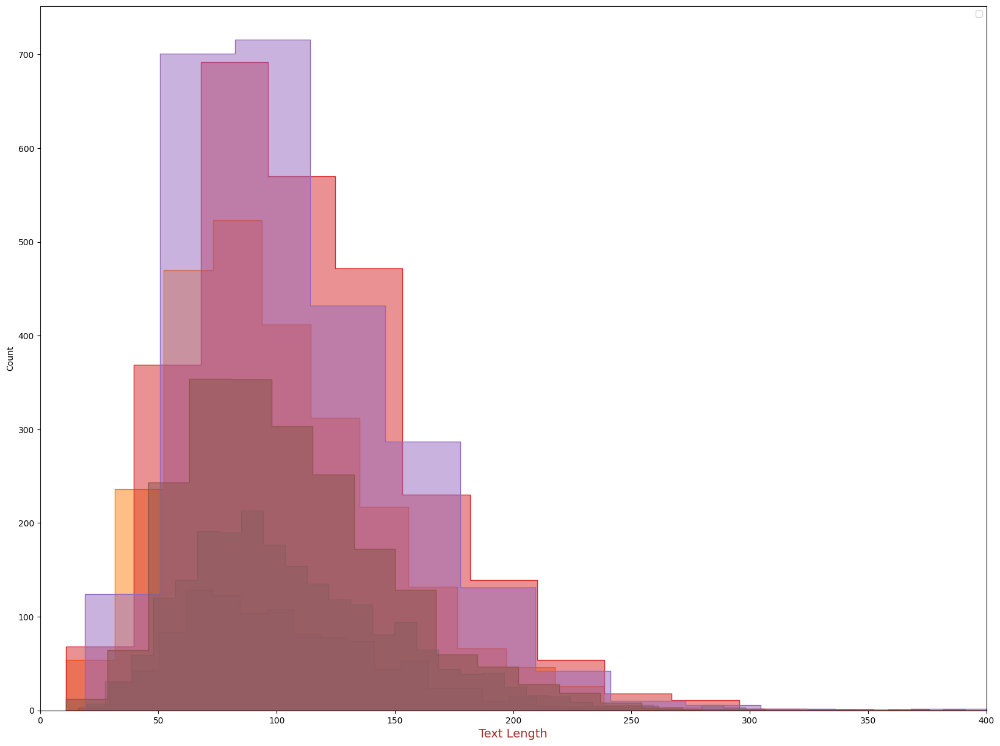

In [101]:
plot_text_length_histogram(data, 'statement')

It doesn seem that it has serious effect on the truthfulness of the statements. Let us at least see what is its importance using a decision tree model.

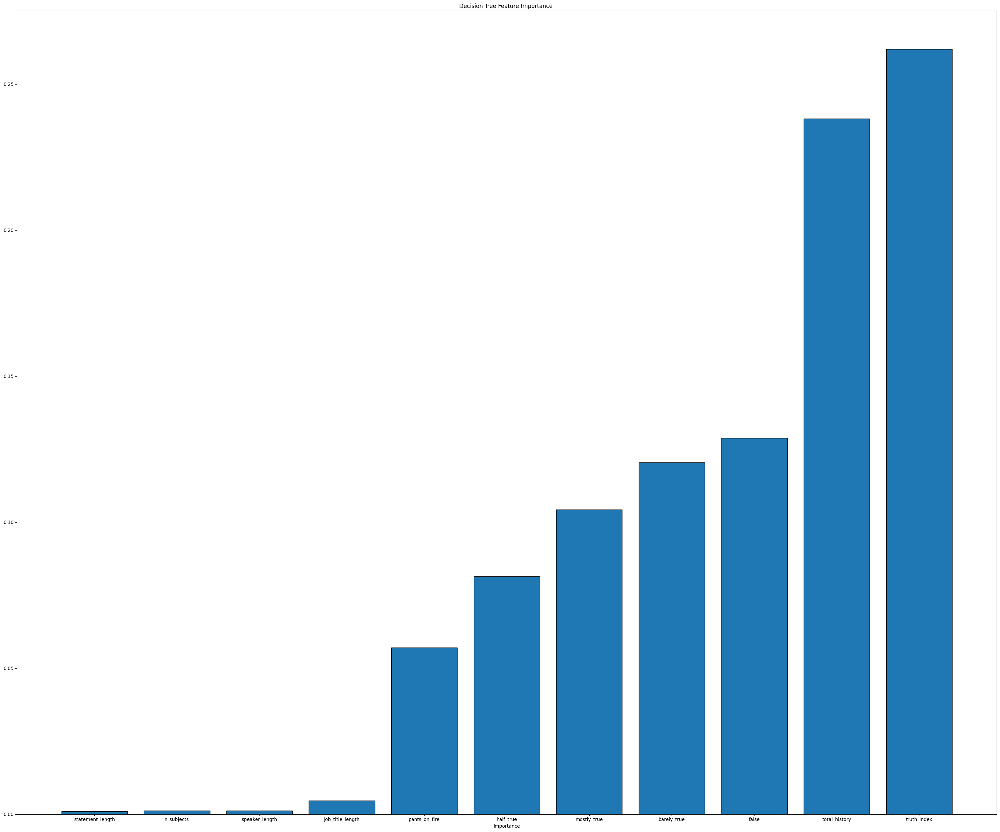

,label,statement,job_title,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,n_subjects,speaker_length,job_title_length,state_category,total_history,truth_index,context_group,statement_length
0,1,Says the Annies List political group supports ...,State representative,republican,0.0,0.0,0.0,0.0,0.0,1,12,20.0,texas,0.0,0.000000,campaign_ads,82
1,3,When did the decline of coal start? It started...,State delegate,democrat,0.0,0.0,0.0,1.0,0.0,3,14,14.0,other,1.0,0.400000,live,141
2,4,"Hillary Clinton agrees with John McCain ""by vo...",President,democrat,70.0,71.0,160.0,162.0,9.0,1,12,9.0,illinois,472.0,0.566173,other,105
3,1,Health care reform legislation is likely to ma...,NaN,none,7.0,18.0,3.0,5.0,44.0,1,12,NaN,other,77.0,0.156410,official,78
4,3,The economic turnaround started at the end of ...,NaN,democrat,15.0,9.0,19.0,19.0,2.0,2,13,NaN,florida,64.0,0.529231,broadcast,54
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,Governor,republican,28.0,23.0,37.0,34.0,7.0,1,10,8.0,florida,129.0,0.501538,live,82
12787,2,Ive been here almost every day.,Governor,democrat,1.0,0.0,0.0,1.0,0.0,3,9,8.0,other,2.0,0.400000,broadcast,31
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...","senior fellow, Foreign Policy Research Institute",other,0.0,0.0,0.0,0.0,0.0,4,21,48.0,other,0.0,0.000000,other,147
12789,2,Says an EPA permit languished under Strickland...,"Governor of Ohio as of Jan. 10, 2011",republican,8.0,8.0,10.0,18.0,3.0,2,11,36.0,ohio,47.0,0.525000,live,96


In [102]:
data['statement_length'] = data['statement'].astype(str).apply(len)
plot_tree_feature_importance(data)
data

Well, the importance chart tells the same. But this column will remain. Let us now see the most common word in each class.

In [103]:
counter1 = count_word_frequencies(data['statement'])

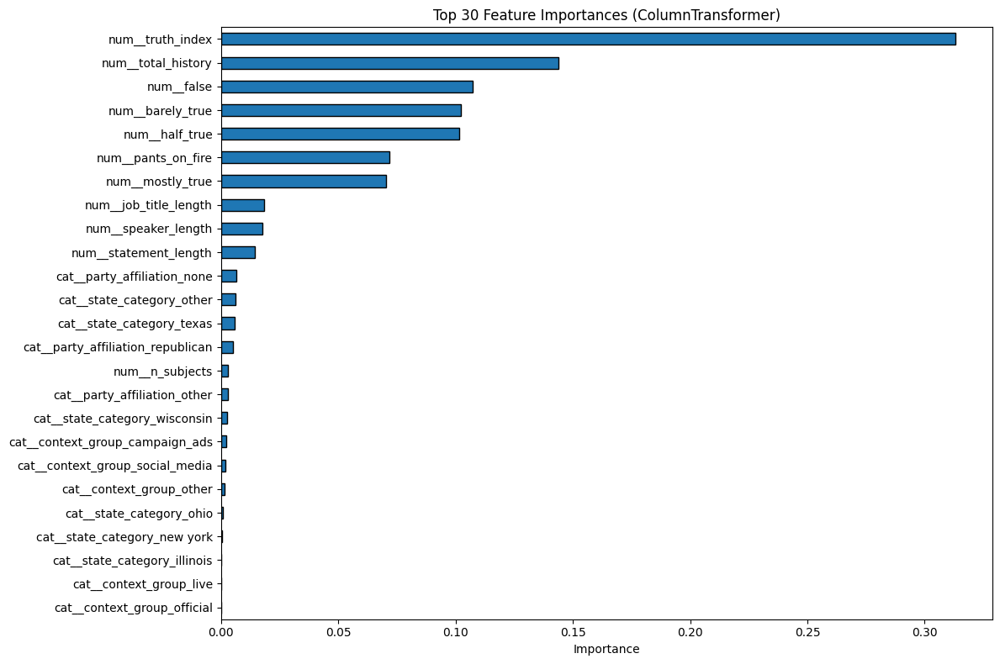

In [104]:
def plot_tree_feature_importance_non_numeric_multiple_cols(data, non_numeric_cols):
    num_cols = data.select_dtypes(include=np.number).columns.tolist()
    num_cols = [c for c in num_cols if c != "label"]
    cat_cols = non_numeric_cols

    used_cols = num_cols + cat_cols + ["label"]
    temp_data = data[used_cols].dropna()

    X = temp_data[num_cols + cat_cols]
    y = temp_data["label"]

    preprocess = ColumnTransformer(
        transformers=[
            ("num", "passthrough", num_cols),
            ("cat", OneHotEncoder(handle_unknown="ignore", drop="first"), cat_cols),
        ],
        remainder="drop",
    )

    model = Pipeline(steps=[
        ("preprocess", preprocess),
        ("clf", DecisionTreeClassifier(random_state=42, max_depth=20)),
    ])

    model.fit(X, y)

    clf = model.named_steps["clf"]
    pre = model.named_steps["preprocess"]

    feature_names = pre.get_feature_names_out()

    importances = clf.feature_importances_
    imp = pd.Series(importances, index=feature_names).sort_values(ascending=False)

    plt.figure(figsize=(12, 8))
    imp.head(30).sort_values().plot(kind="barh", edgecolor="black")
    plt.title("Top 30 Feature Importances (ColumnTransformer)")
    plt.xlabel("Importance")
    plt.tight_layout()
    plt.show()

plot_tree_feature_importance_non_numeric_multiple_cols(data, ['state_category', 'party_affiliation', 'context_group'])

Using all the information we have, it seems some categories are not really useful to us, we will have it in mind, but we will continue with creating more features.

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


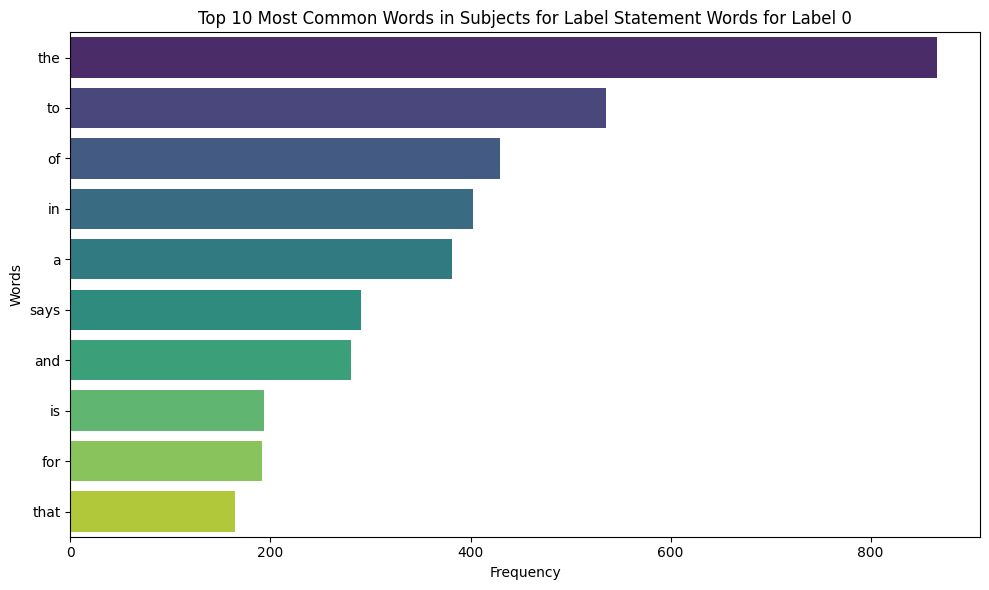

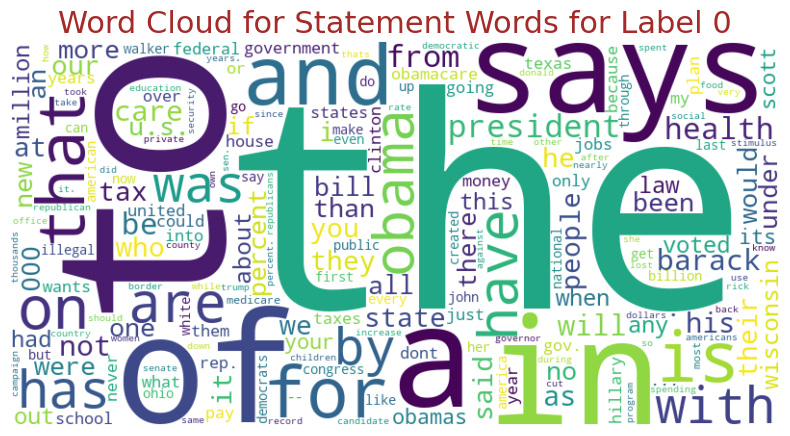

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


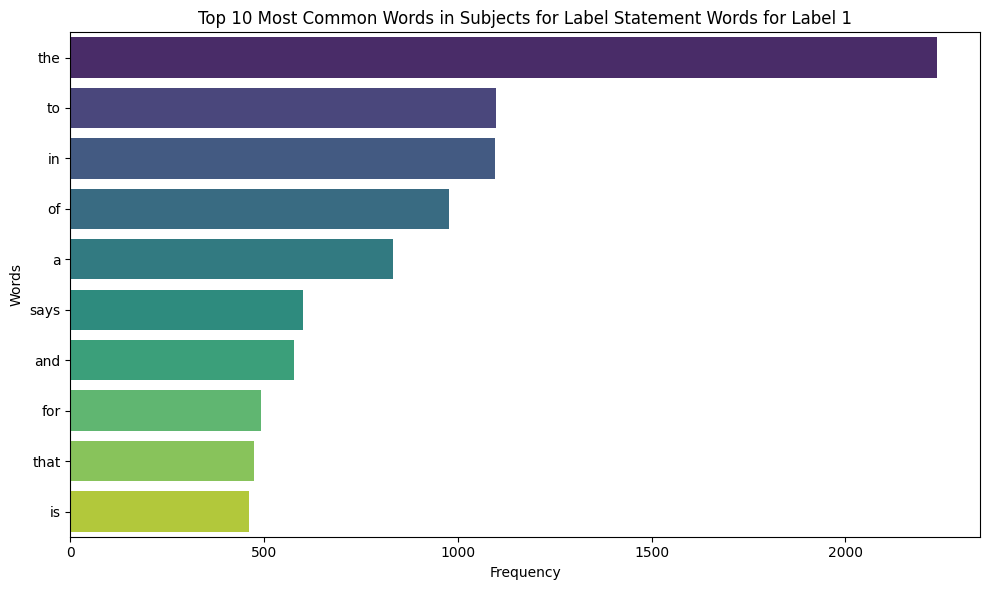

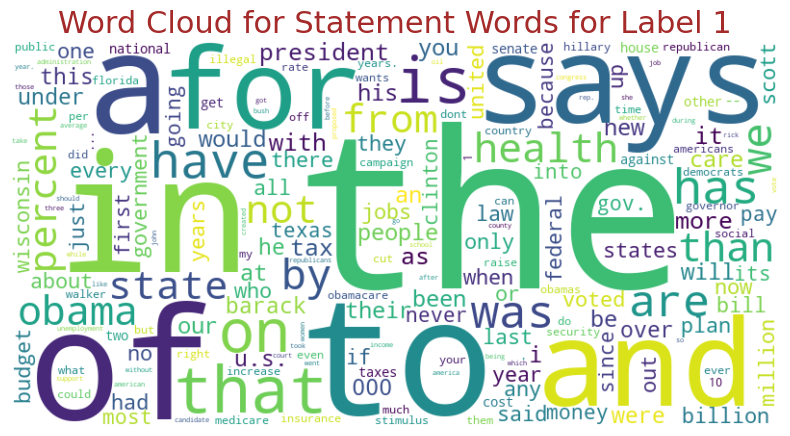

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


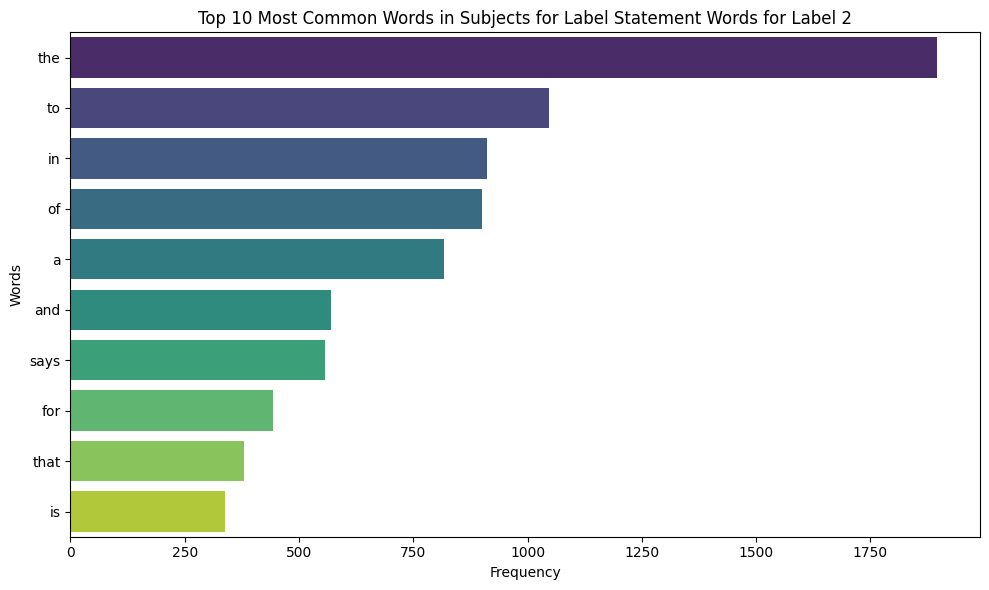

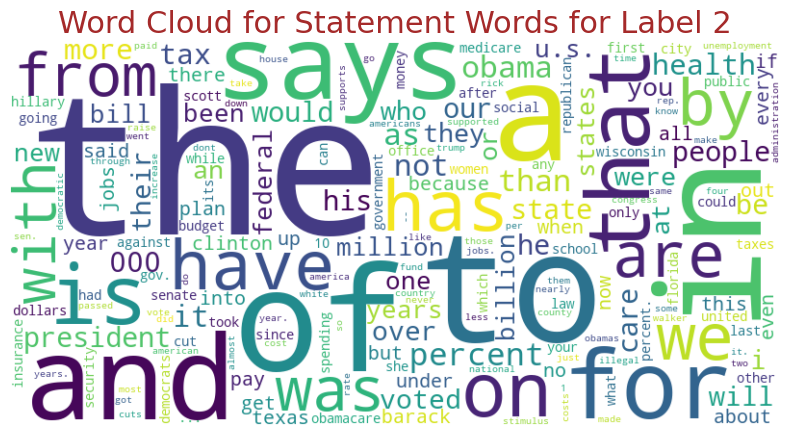

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


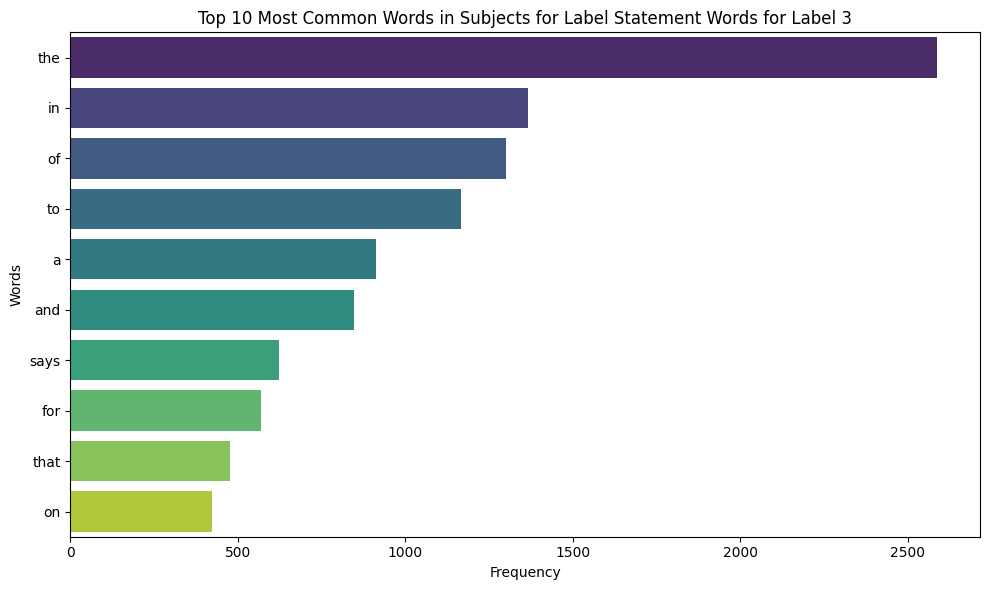

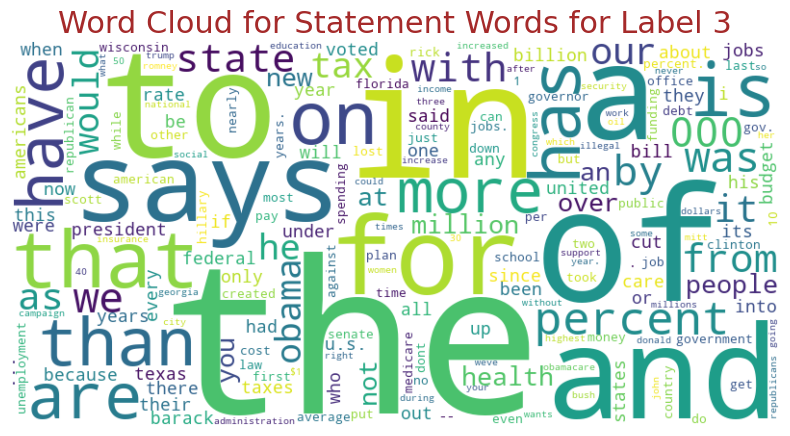

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


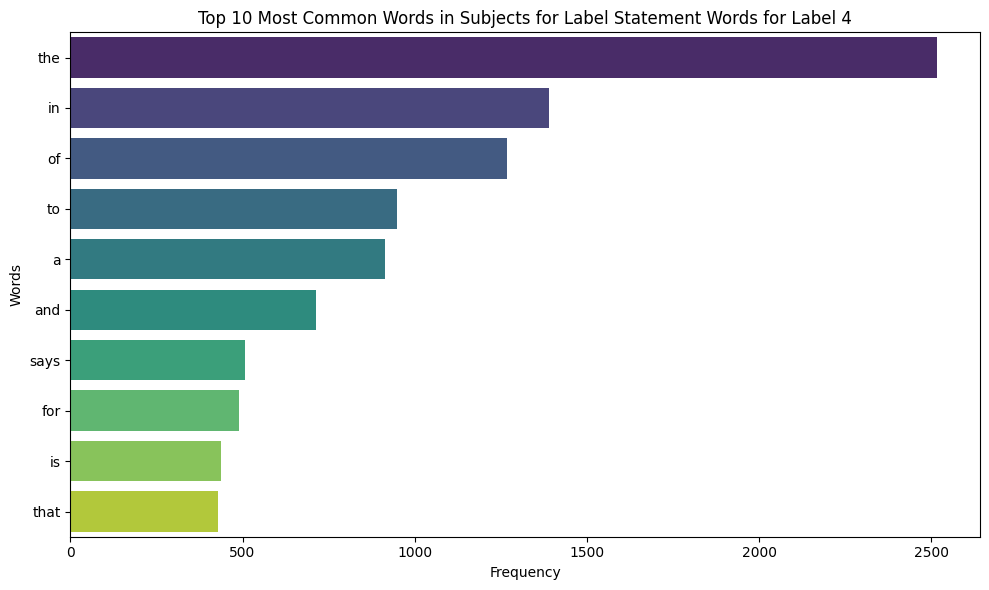

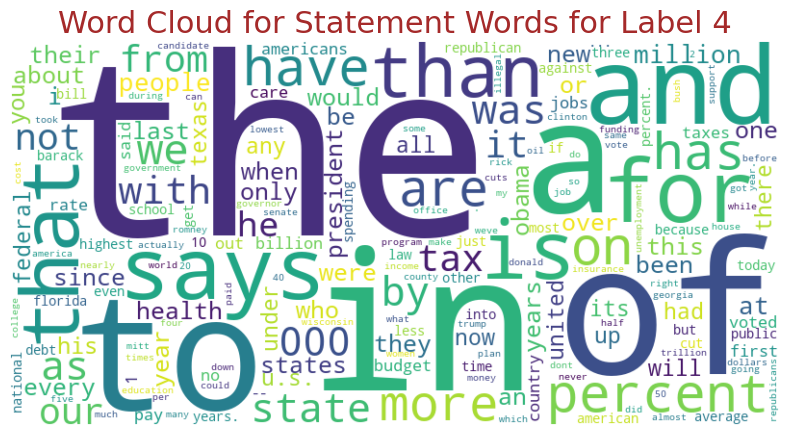

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


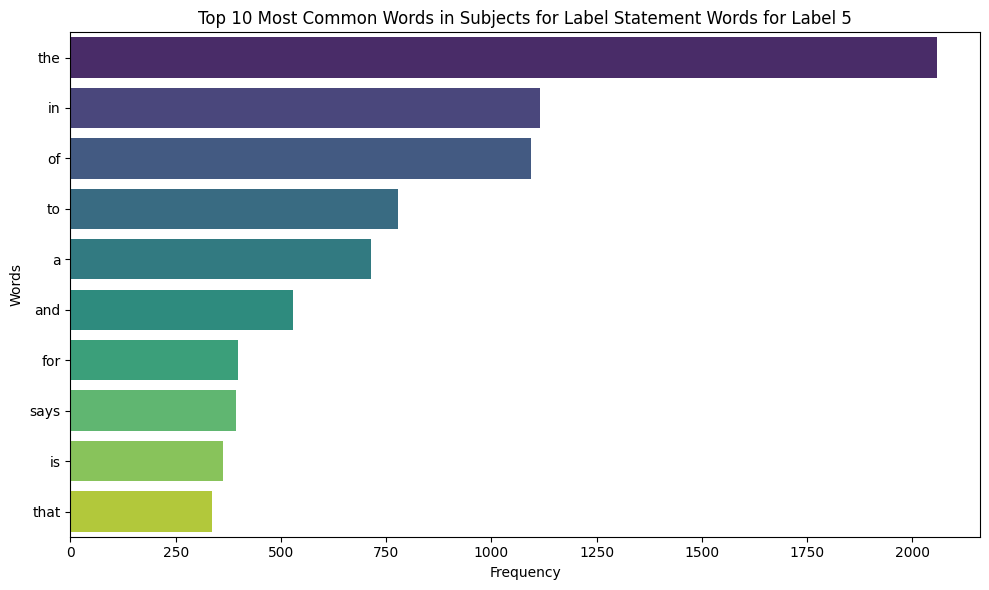

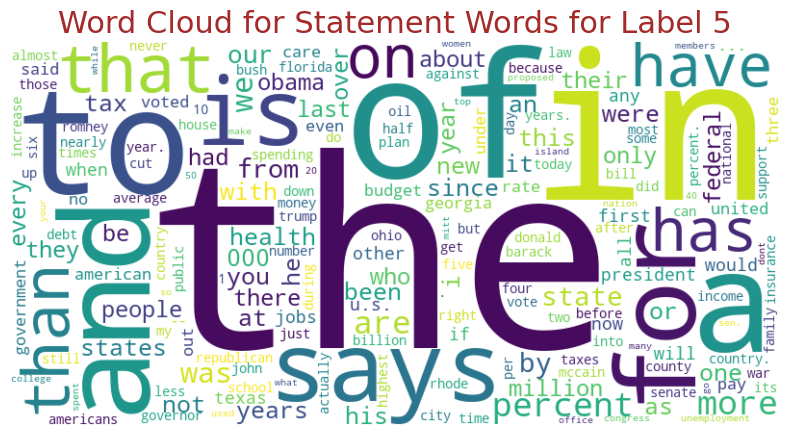

In [105]:
for label in range(6):
    subset = data[data['label'] == label]
    counter = count_word_frequencies(subset['statement'])
    plot_bar_chart_for_most_common_words(counter, label=f'Statement Words for Label {label}')
    create_word_cloud(counter, label=f'Statement Words for Label {label}')

These are the most popular words in each of the 6 classes. As we can see, however, they mostly consist of stopwords, so we should do something to remove them.

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\3382719228.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset['statement_no_stopwords'] = subset['statement'].apply(preprocess_text)
C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


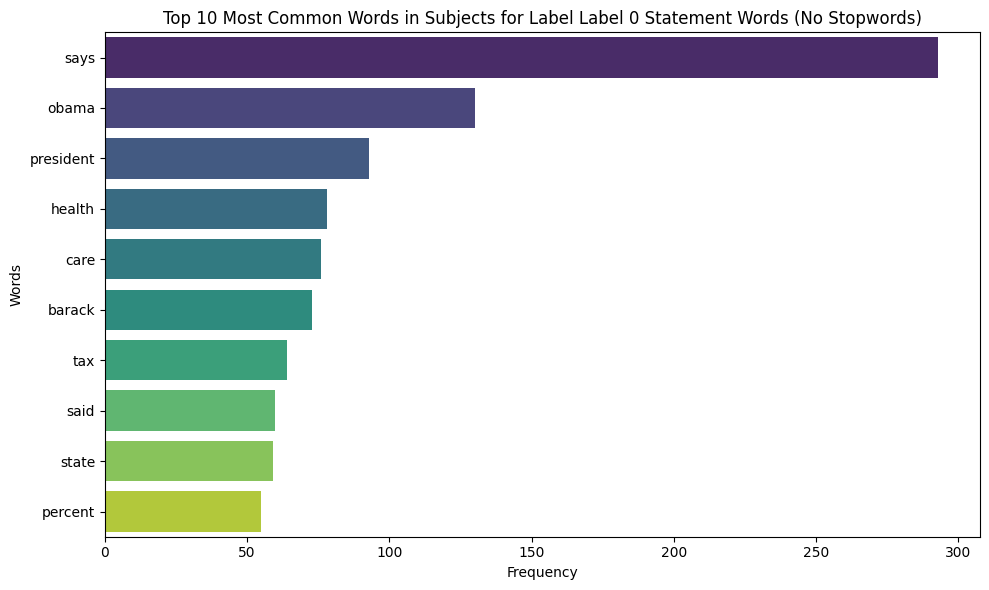

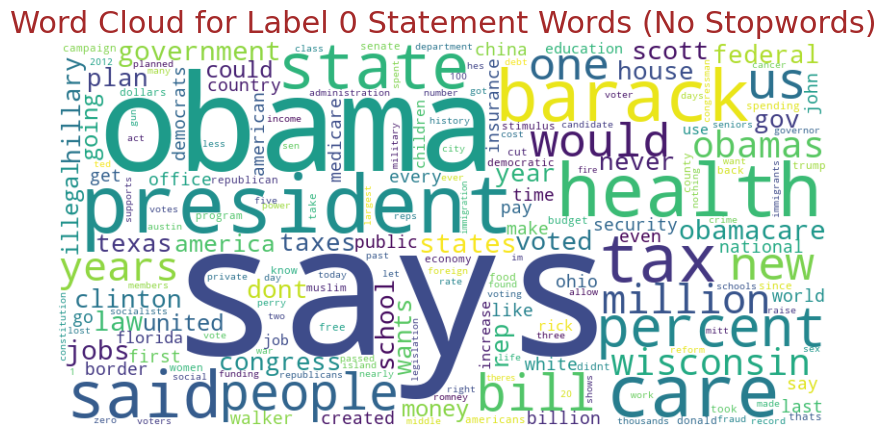

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\3382719228.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset['statement_no_stopwords'] = subset['statement'].apply(preprocess_text)
C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


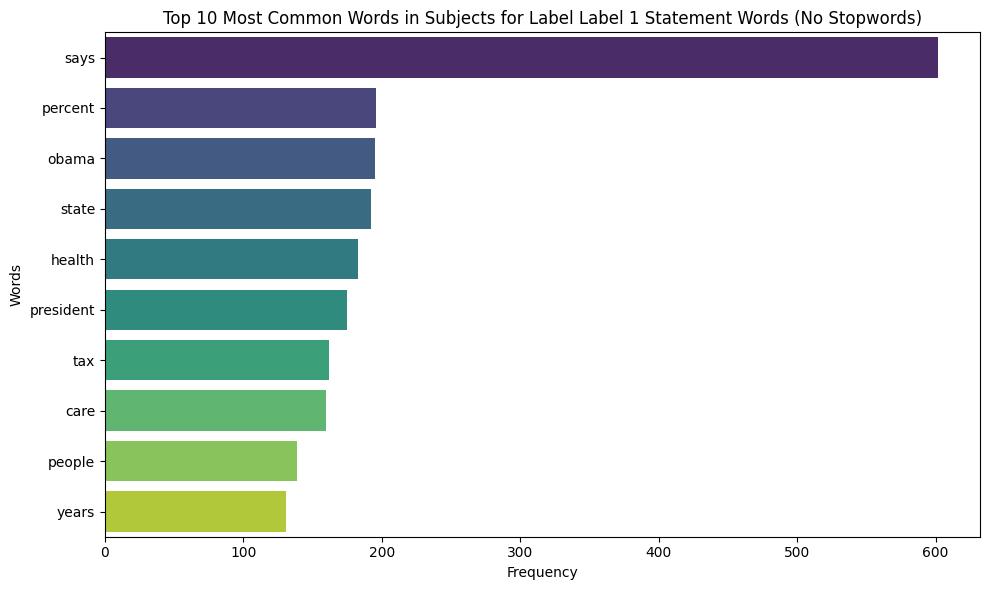

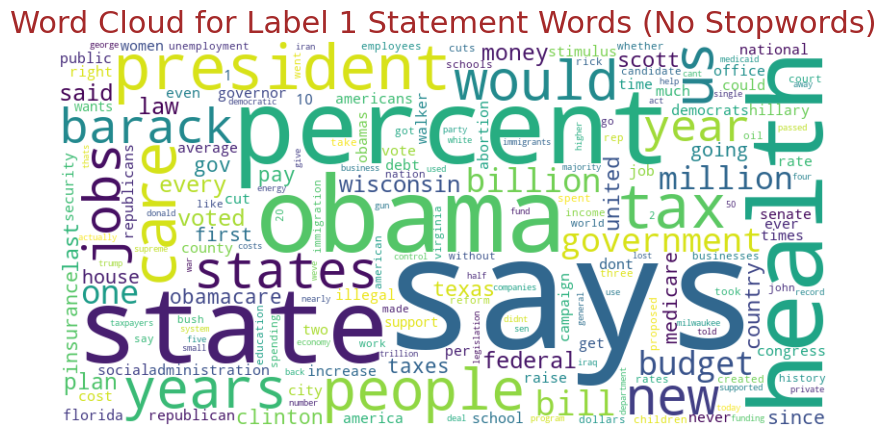

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\3382719228.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset['statement_no_stopwords'] = subset['statement'].apply(preprocess_text)
C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


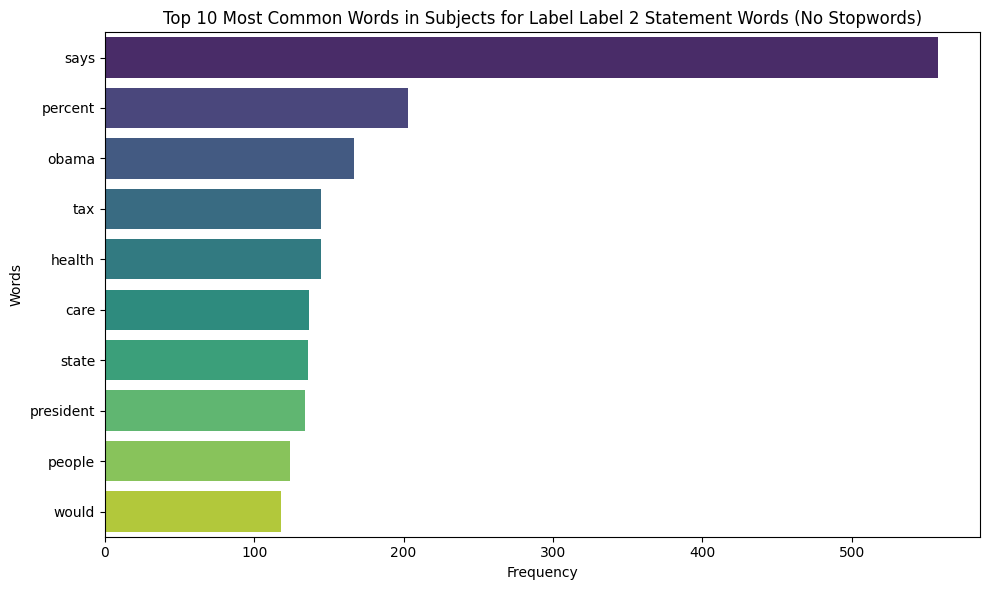

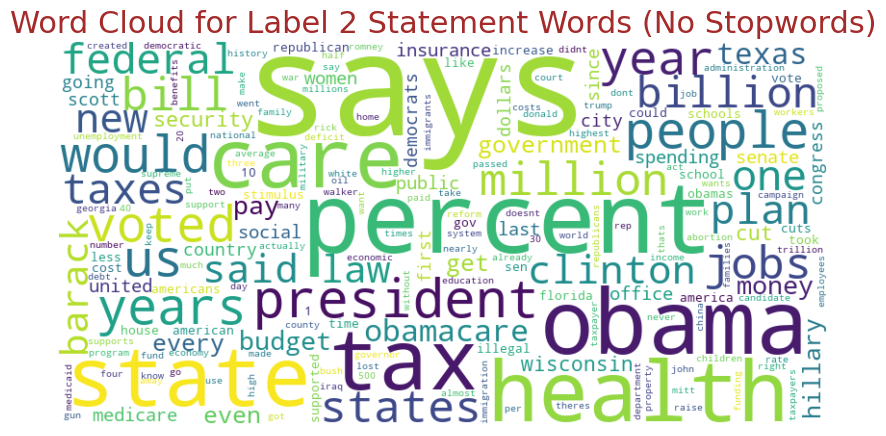

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\3382719228.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset['statement_no_stopwords'] = subset['statement'].apply(preprocess_text)
C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


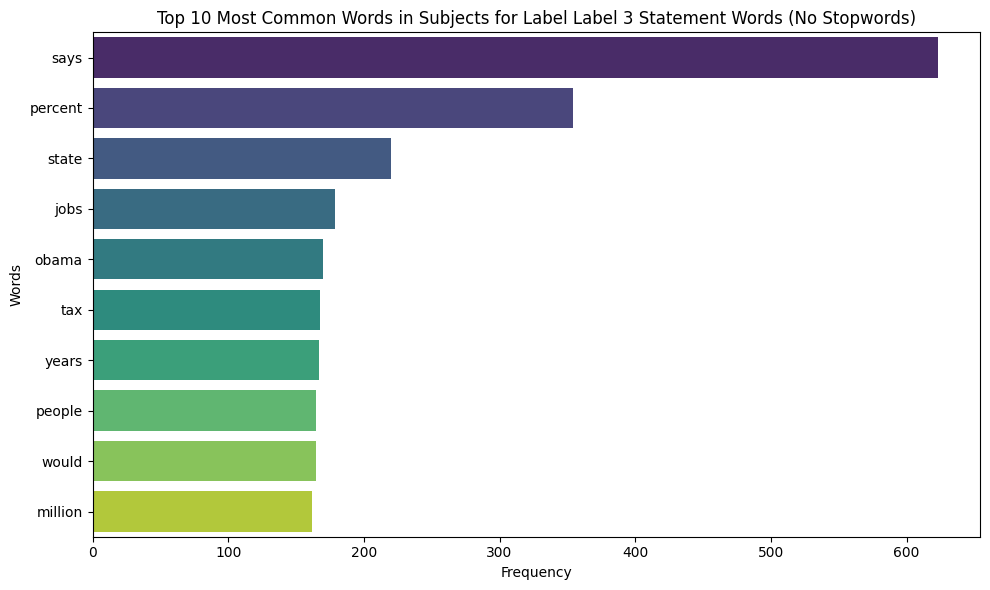

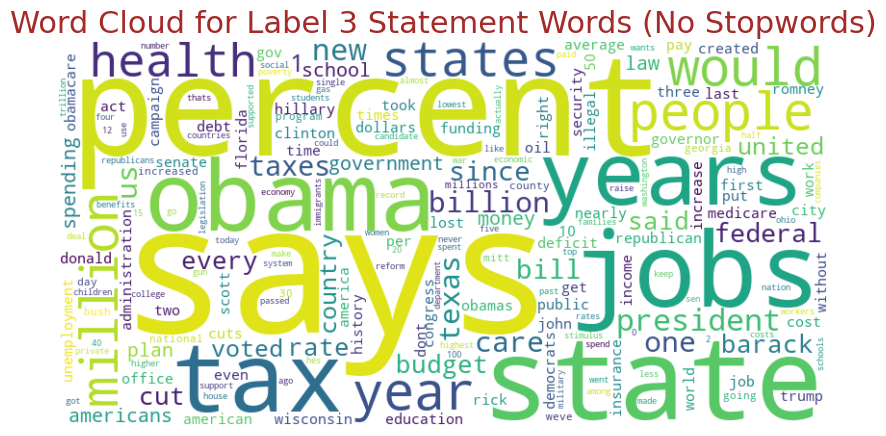

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\3382719228.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset['statement_no_stopwords'] = subset['statement'].apply(preprocess_text)
C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


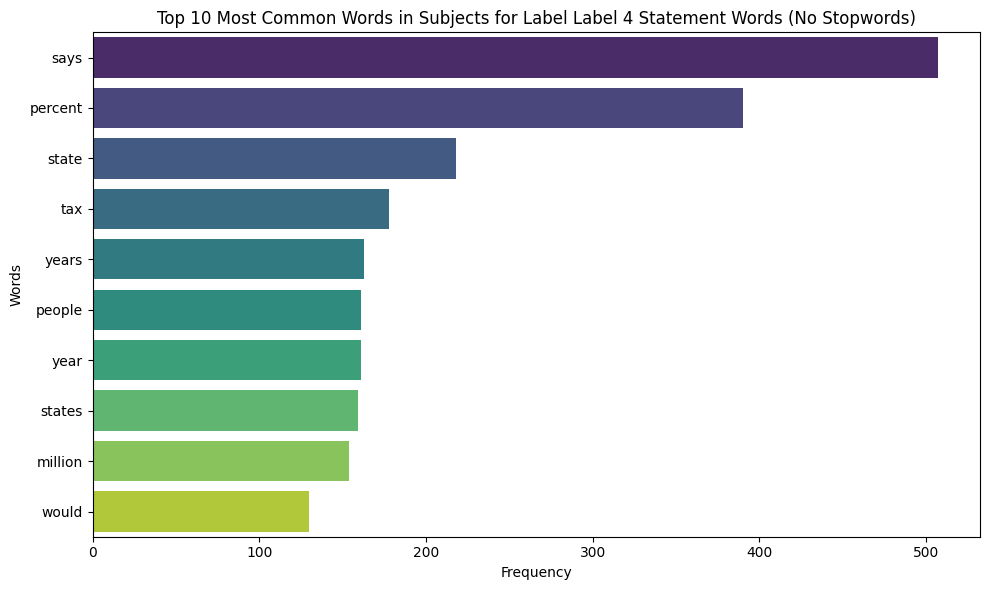

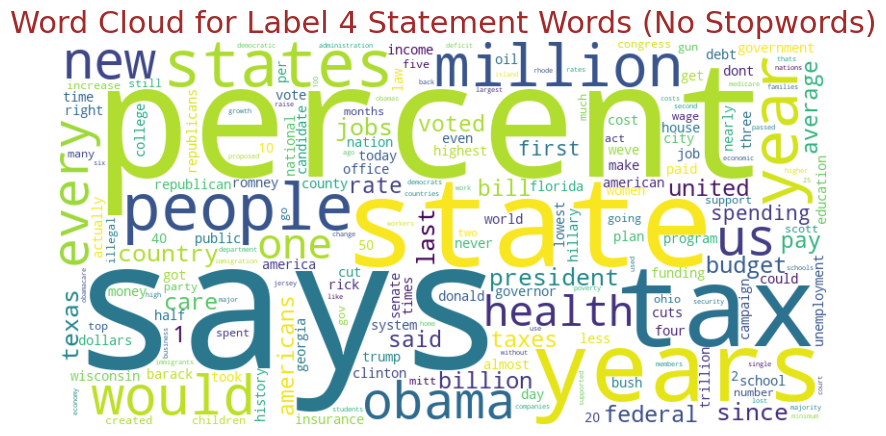

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\3382719228.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset['statement_no_stopwords'] = subset['statement'].apply(preprocess_text)
C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


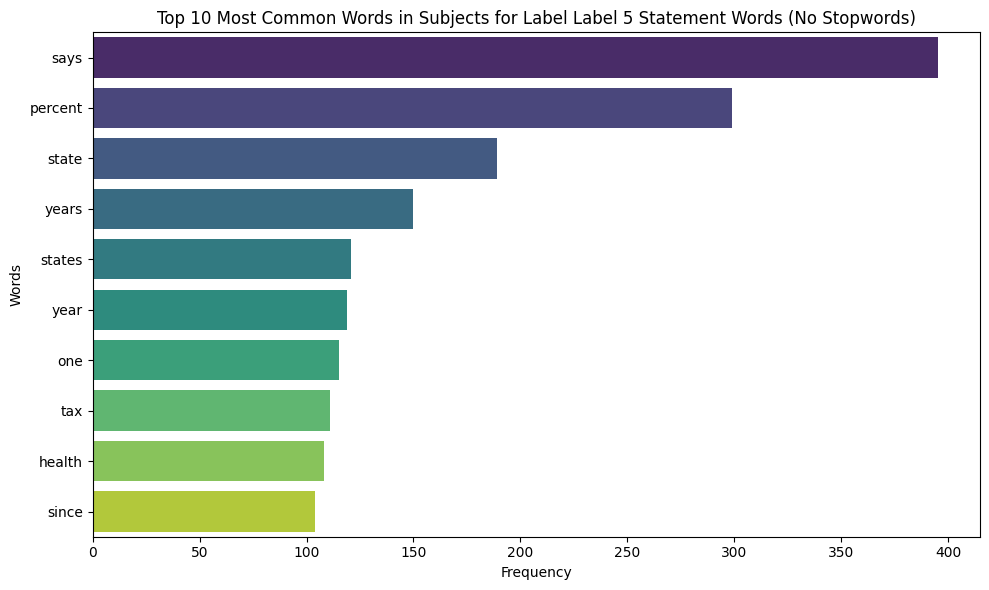

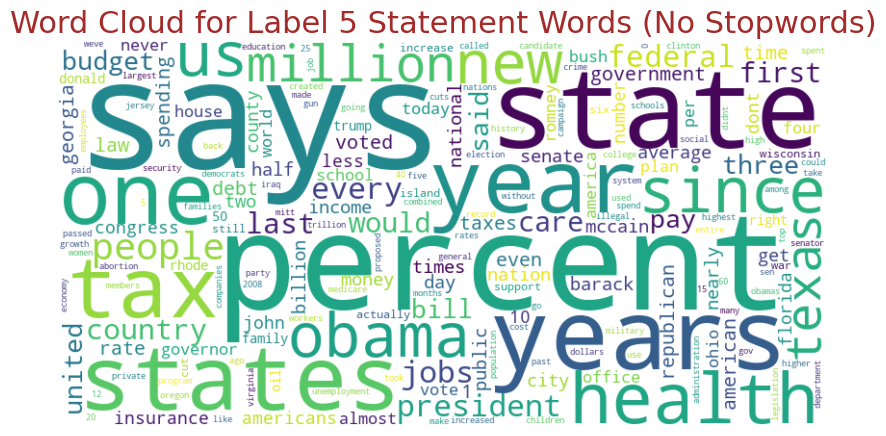

In [106]:
for label in range(6):
    subset = data[data['label'] == label]
    subset['statement_no_stopwords'] = subset['statement'].apply(preprocess_text)
    counter = count_word_frequencies(subset['statement_no_stopwords'])
    plot_bar_chart_for_most_common_words(counter, label=f'Label {label} Statement Words (No Stopwords)')
    create_word_cloud(counter, label=f'Label {label} Statement Words (No Stopwords)')

The most interesting word that seems more common in fake news and not present in real news is obama(and maybe president).

We should also see 2-grams to see if there is something unusual.

In [107]:
def get_top_bigrams(text_series, n=20):
    text_series = text_series.astype(str)
    words = ' '.join(text_series).lower().split()
    bigrams = list(zip(words, words[1:]))
    
    counts = Counter(bigrams)
    top = counts.most_common(n)
    
    return pd.Series(
        {f"{word1} {word2}": count for (word1, word2), count in top}
    )
data

,label,statement,job_title,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,n_subjects,speaker_length,job_title_length,state_category,total_history,truth_index,context_group,statement_length
0,1,Says the Annies List political group supports ...,State representative,republican,0.0,0.0,0.0,0.0,0.0,1,12,20.0,texas,0.0,0.000000,campaign_ads,82
1,3,When did the decline of coal start? It started...,State delegate,democrat,0.0,0.0,0.0,1.0,0.0,3,14,14.0,other,1.0,0.400000,live,141
2,4,"Hillary Clinton agrees with John McCain ""by vo...",President,democrat,70.0,71.0,160.0,162.0,9.0,1,12,9.0,illinois,472.0,0.566173,other,105
3,1,Health care reform legislation is likely to ma...,NaN,none,7.0,18.0,3.0,5.0,44.0,1,12,NaN,other,77.0,0.156410,official,78
4,3,The economic turnaround started at the end of ...,NaN,democrat,15.0,9.0,19.0,19.0,2.0,2,13,NaN,florida,64.0,0.529231,broadcast,54
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,Governor,republican,28.0,23.0,37.0,34.0,7.0,1,10,8.0,florida,129.0,0.501538,live,82
12787,2,Ive been here almost every day.,Governor,democrat,1.0,0.0,0.0,1.0,0.0,3,9,8.0,other,2.0,0.400000,broadcast,31
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...","senior fellow, Foreign Policy Research Institute",other,0.0,0.0,0.0,0.0,0.0,4,21,48.0,other,0.0,0.000000,other,147
12789,2,Says an EPA permit languished under Strickland...,"Governor of Ohio as of Jan. 10, 2011",republican,8.0,8.0,10.0,18.0,3.0,2,11,36.0,ohio,47.0,0.525000,live,96


C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\2033862772.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset['statement_no_stopwords'] = subset['statement'].apply(preprocess_text)
C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


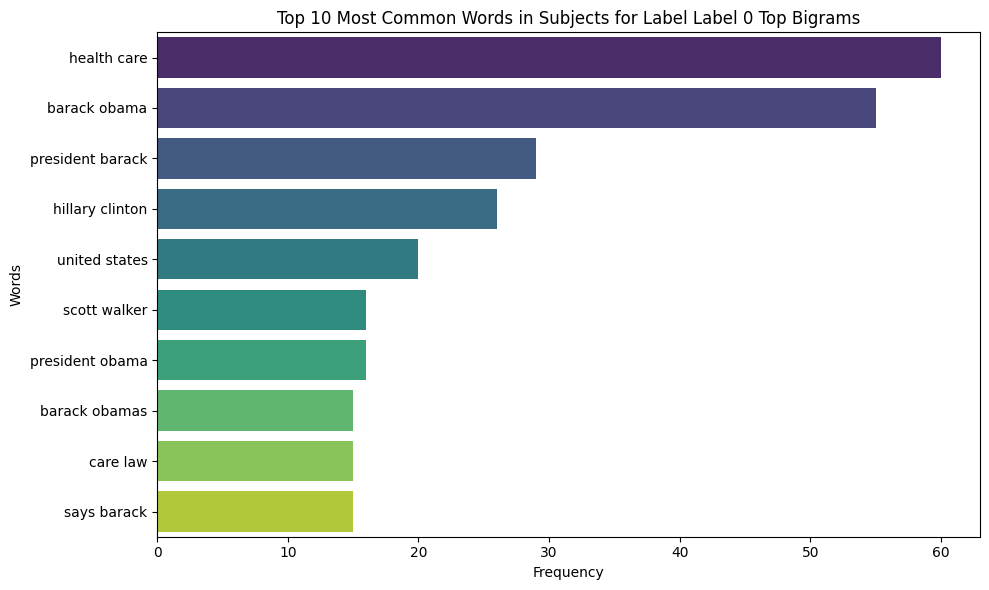

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\2033862772.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset['statement_no_stopwords'] = subset['statement'].apply(preprocess_text)
C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


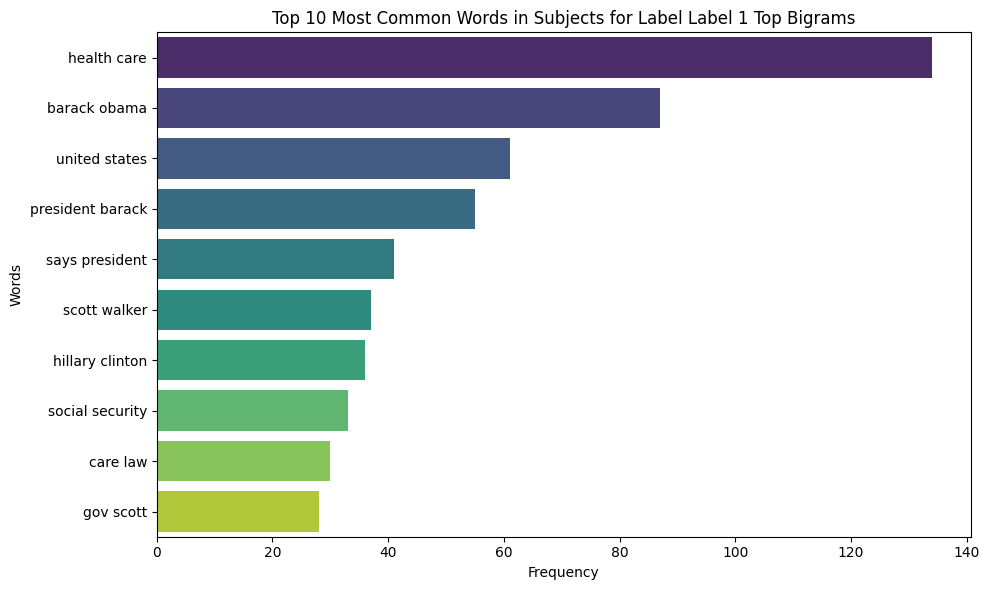

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\2033862772.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset['statement_no_stopwords'] = subset['statement'].apply(preprocess_text)
C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


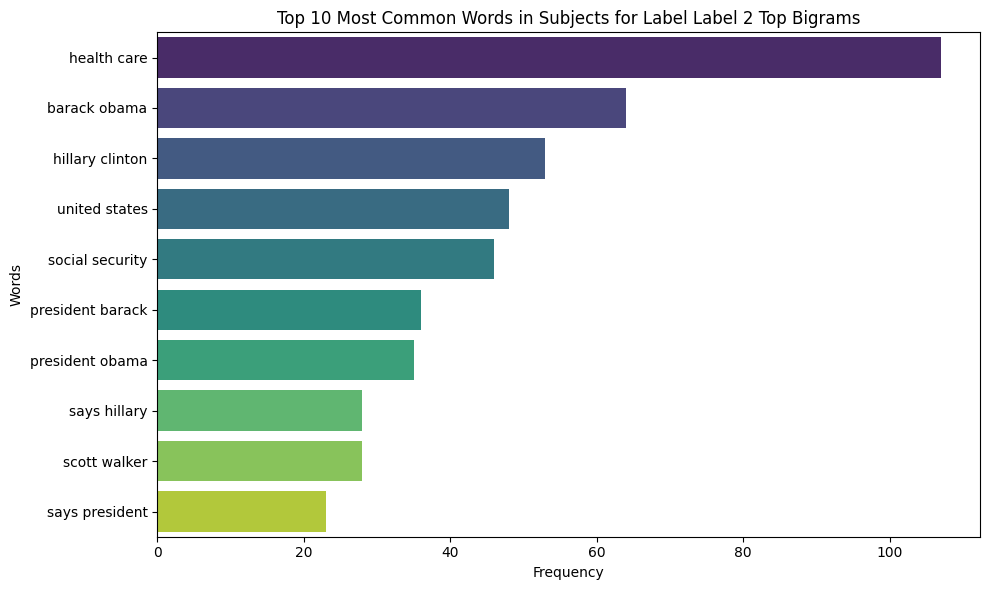

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\2033862772.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset['statement_no_stopwords'] = subset['statement'].apply(preprocess_text)
C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


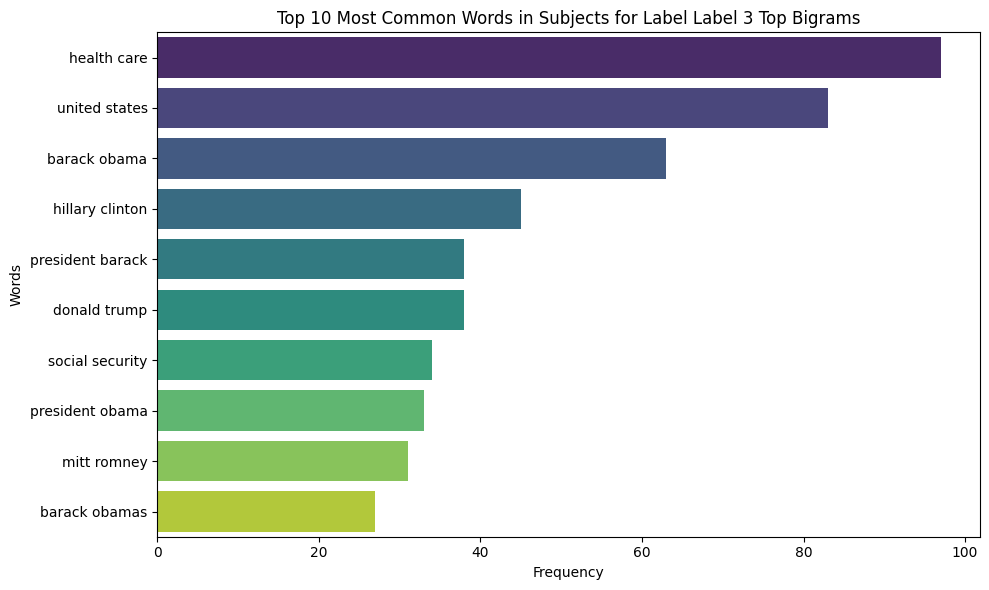

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\2033862772.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset['statement_no_stopwords'] = subset['statement'].apply(preprocess_text)
C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


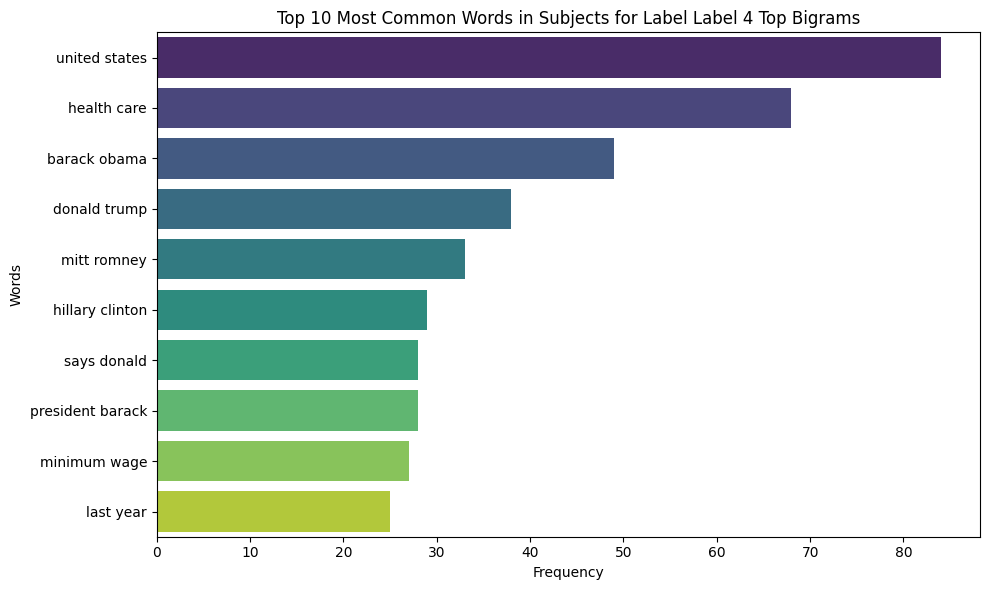

C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\2033862772.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset['statement_no_stopwords'] = subset['statement'].apply(preprocess_text)
C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\1566201622.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=most_common.values, y=most_common.index, palette='viridis')


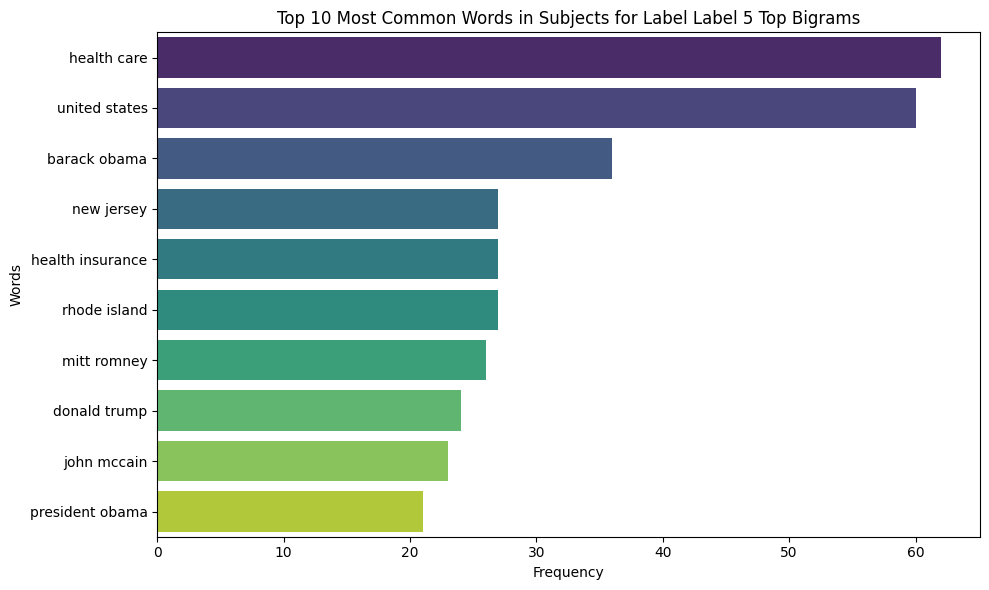

In [108]:
for label in range(6):
    subset = data[data['label'] == label]
    subset['statement_no_stopwords'] = subset['statement'].apply(preprocess_text)
    bigram_counts = get_top_bigrams(subset['statement_no_stopwords'])
    plot_bar_chart_for_most_common_words(bigram_counts, label=f'Label {label} Top Bigrams')

It is hard to distinguish any word combination that is has much bigger occurence rate in on category than the others, so this may be not the way to look for extracting more features.

## POS Tagging

In [109]:
# nltk.download("averaged_perceptron_tagger")

In [110]:
# nltk.download("punkt")

In [111]:
# nltk.download('maxent_ne_chunker_tab')

In [112]:
# nltk.download("punkt_tab")

In [113]:
# nltk.download("averaged_perceptron_tagger_eng")

In [114]:
def count_pos_tags(text):
    tokens = word_tokenize(text)
    pos_tags = nltk.pos_tag(tokens)

    pos_counts = {
        'proper_nouns': 0,
        'nouns': 0,
        'verbs': 0,
        'adjectives': 0,
        'adverbs': 0,
        'pronouns': 0,
        'conjunctions': 0,
        'other': 0
    }

    for _ , tag in pos_tags:
        if tag == 'NNP' or tag == 'NNPS':
            pos_counts['proper_nouns'] += 1
        elif tag.startswith('NN'):
            pos_counts['nouns'] += 1
        elif tag.startswith('VB'):
            pos_counts['verbs'] += 1
        elif tag.startswith('JJ'):
            pos_counts['adjectives'] += 1
        elif tag.startswith('RB'):
            pos_counts['adverbs'] += 1
        elif tag.startswith('PRP'):
            pos_counts['pronouns'] += 1
        elif tag == 'CC' or tag == 'IN':
            pos_counts['conjunctions'] += 1
        else:
            pos_counts['other'] += 1

    total_tokens = len(tokens)
    for key in pos_counts:
        pos_counts[key] = pos_counts[key] / total_tokens

    return pd.Series(pos_counts)

In [115]:
pos_features = data['statement'].apply(count_pos_tags)
data = pd.concat([data, pos_features], axis=1)
data

,label,statement,job_title,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,n_subjects,...,context_group,statement_length,proper_nouns,nouns,verbs,adjectives,adverbs,pronouns,conjunctions,other
0,1,Says the Annies List political group supports ...,State representative,republican,0.0,0.0,0.0,0.0,0.0,1,...,campaign_ads,82,0.166667,0.333333,0.166667,0.083333,0.000000,0.000000,0.083333,0.166667
1,3,When did the decline of coal start? It started...,State delegate,democrat,0.0,0.0,0.0,1.0,0.0,3,...,live,141,0.142857,0.178571,0.178571,0.035714,0.000000,0.035714,0.107143,0.321429
2,4,"Hillary Clinton agrees with John McCain ""by vo...",President,democrat,70.0,71.0,160.0,162.0,9.0,1,...,other,105,0.318182,0.090909,0.136364,0.000000,0.000000,0.000000,0.181818,0.272727
3,1,Health care reform legislation is likely to ma...,NaN,none,7.0,18.0,3.0,5.0,44.0,1,...,official,78,0.076923,0.461538,0.153846,0.153846,0.000000,0.000000,0.000000,0.153846
4,3,The economic turnaround started at the end of ...,NaN,democrat,15.0,9.0,19.0,19.0,2.0,2,...,broadcast,54,0.000000,0.272727,0.090909,0.090909,0.000000,0.090909,0.181818,0.272727
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,Governor,republican,28.0,23.0,37.0,34.0,7.0,1,...,live,82,0.000000,0.428571,0.142857,0.071429,0.000000,0.071429,0.142857,0.142857
12787,2,Ive been here almost every day.,Governor,democrat,1.0,0.0,0.0,1.0,0.0,3,...,broadcast,31,0.142857,0.142857,0.142857,0.000000,0.285714,0.000000,0.000000,0.285714
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...","senior fellow, Foreign Policy Research Institute",other,0.0,0.0,0.0,0.0,0.0,4,...,other,147,0.173913,0.173913,0.130435,0.130435,0.043478,0.000000,0.086957,0.260870
12789,2,Says an EPA permit languished under Strickland...,"Governor of Ohio as of Jan. 10, 2011",republican,8.0,8.0,10.0,18.0,3.0,2,...,live,96,0.157895,0.157895,0.210526,0.052632,0.000000,0.105263,0.157895,0.157895


C:\Users\Ivan\AppData\Local\Temp\ipykernel_18120\402632894.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=corr.index, y=corr.values, palette='viridis', edgecolor='black')


Text(0.5, 1.0, 'Correlation of POS Tag Features with Label')

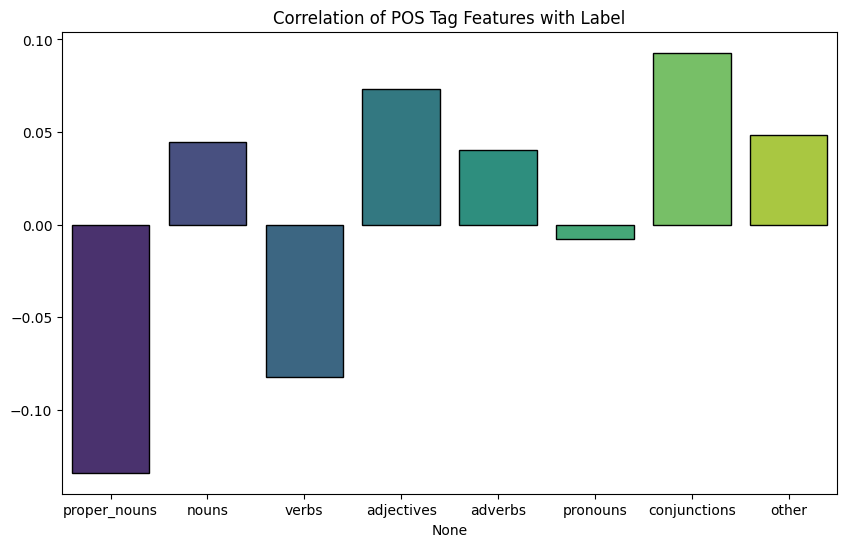

In [116]:
corr = data[['proper_nouns','nouns','verbs','adjectives','adverbs','pronouns','conjunctions','other']].corrwith(data['label'])
plt.figure(figsize=(10, 6))
sns.barplot(x=corr.index, y=corr.values, palette='viridis', edgecolor='black')
plt.title('Correlation of POS Tag Features with Label')

Proper nowns was put becaues these include names of people, which might be good indicator about how truthful the statement is. It seems that it could be very benefitial. Let us try a model with these features

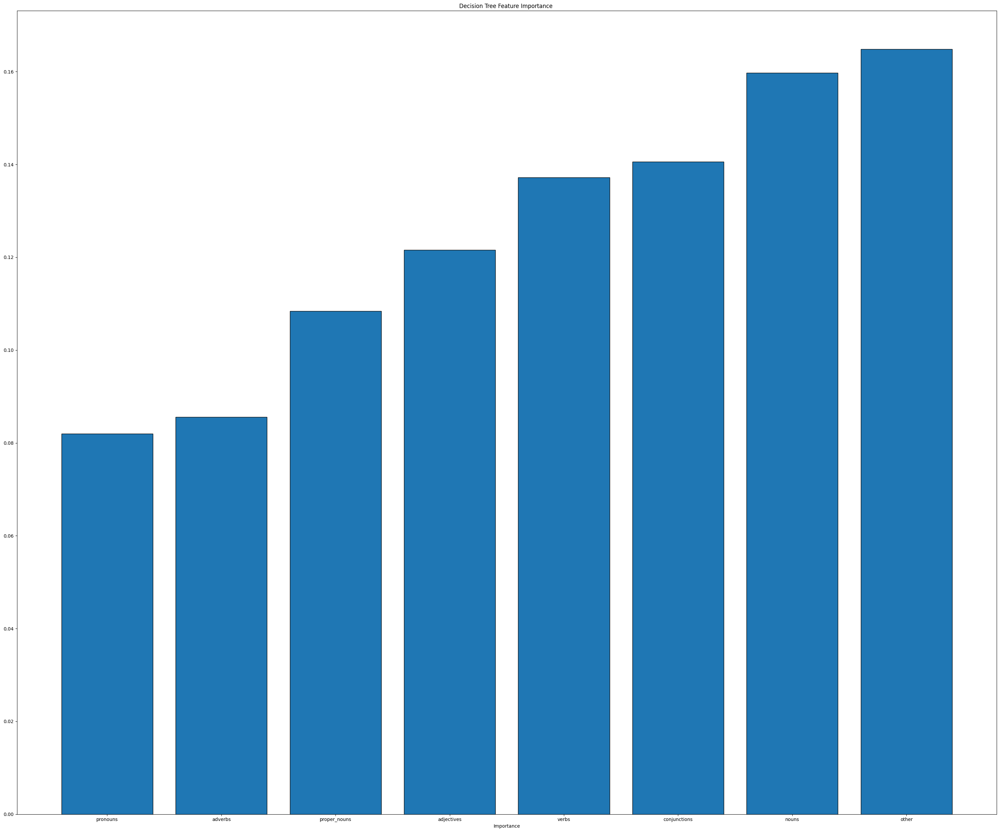

In [117]:
plot_tree_feature_importance(data[['proper_nouns','nouns','verbs','adjectives','adverbs','pronouns','conjunctions','other', 'label']])

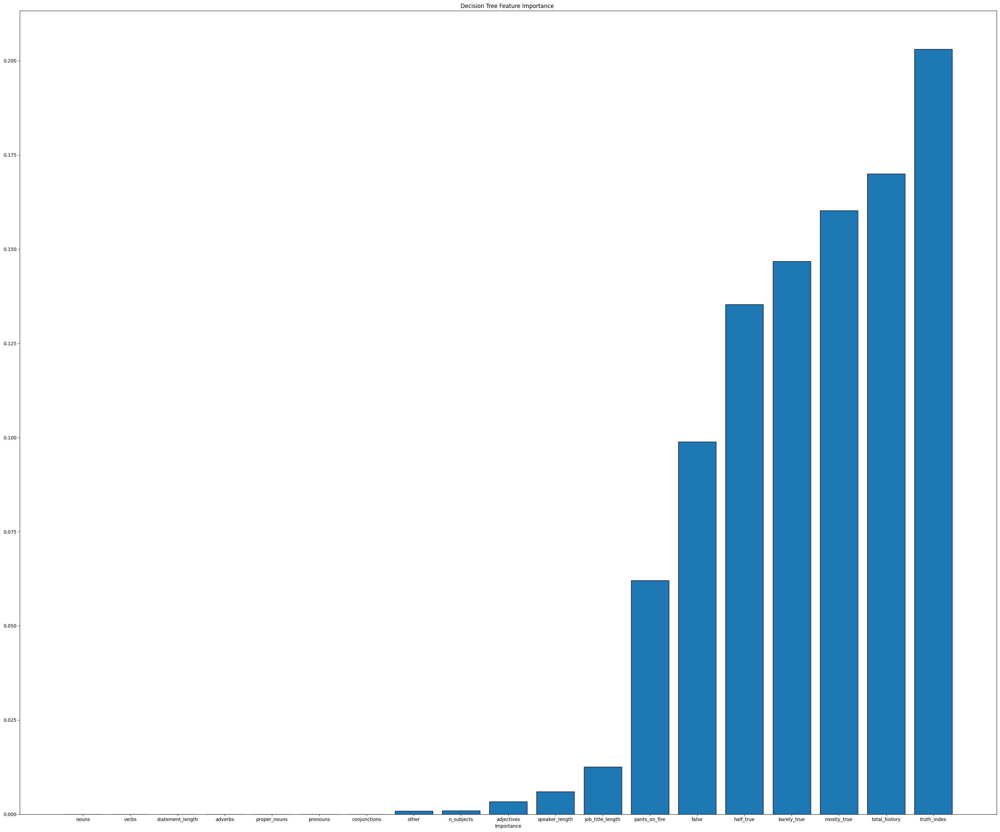

In [118]:
plot_tree_feature_importance(data)

They do not have that significant importance, let us see their correlation with each other, if there is a way to not use all of them.

<Axes: >

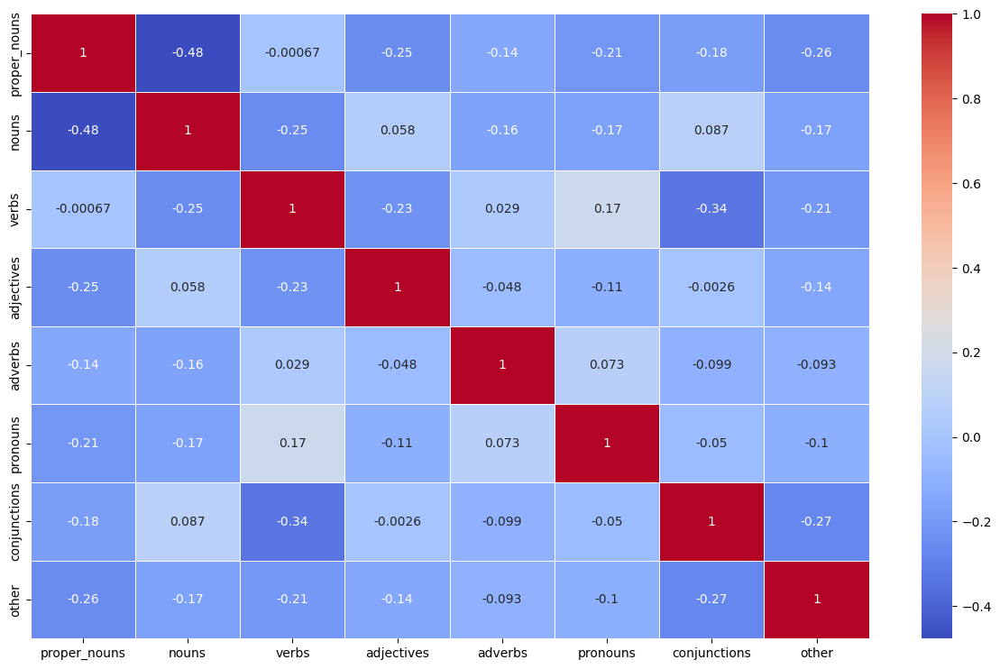

In [119]:
plt.figure(figsize=(15, 9))
sns.heatmap(data[['proper_nouns','nouns','verbs','adjectives','adverbs','pronouns','conjunctions','other']].corr(), annot=True, cmap="coolwarm", linewidths=0.5)

Not that strong of correlation, so we will continue searching for other features and will decide in the end what should be kept and what should not.

## Lexical diversity

This aims to measure the diversity of the text(more uniqe words might give us more certainty about the originality of the text)
$$coef = \frac{\text{Number Of Unique Words}}{\text{Total number of words}}$$

In [120]:
# nltk.download('wordnet')
# nltk.download('omw-1.4')

In [121]:
def calculate_lexical_diversity(text):
    words = word_tokenize(str(text).lower())
    words = list(map(str.strip, words))

    lemmatizer = WordNetLemmatizer()
    words = [lemmatizer.lemmatize(word) for word in words]

    return len(set(words)) / len(words) if words else 0
data

,label,statement,job_title,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,n_subjects,...,context_group,statement_length,proper_nouns,nouns,verbs,adjectives,adverbs,pronouns,conjunctions,other
0,1,Says the Annies List political group supports ...,State representative,republican,0.0,0.0,0.0,0.0,0.0,1,...,campaign_ads,82,0.166667,0.333333,0.166667,0.083333,0.000000,0.000000,0.083333,0.166667
1,3,When did the decline of coal start? It started...,State delegate,democrat,0.0,0.0,0.0,1.0,0.0,3,...,live,141,0.142857,0.178571,0.178571,0.035714,0.000000,0.035714,0.107143,0.321429
2,4,"Hillary Clinton agrees with John McCain ""by vo...",President,democrat,70.0,71.0,160.0,162.0,9.0,1,...,other,105,0.318182,0.090909,0.136364,0.000000,0.000000,0.000000,0.181818,0.272727
3,1,Health care reform legislation is likely to ma...,NaN,none,7.0,18.0,3.0,5.0,44.0,1,...,official,78,0.076923,0.461538,0.153846,0.153846,0.000000,0.000000,0.000000,0.153846
4,3,The economic turnaround started at the end of ...,NaN,democrat,15.0,9.0,19.0,19.0,2.0,2,...,broadcast,54,0.000000,0.272727,0.090909,0.090909,0.000000,0.090909,0.181818,0.272727
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,Governor,republican,28.0,23.0,37.0,34.0,7.0,1,...,live,82,0.000000,0.428571,0.142857,0.071429,0.000000,0.071429,0.142857,0.142857
12787,2,Ive been here almost every day.,Governor,democrat,1.0,0.0,0.0,1.0,0.0,3,...,broadcast,31,0.142857,0.142857,0.142857,0.000000,0.285714,0.000000,0.000000,0.285714
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...","senior fellow, Foreign Policy Research Institute",other,0.0,0.0,0.0,0.0,0.0,4,...,other,147,0.173913,0.173913,0.130435,0.130435,0.043478,0.000000,0.086957,0.260870
12789,2,Says an EPA permit languished under Strickland...,"Governor of Ohio as of Jan. 10, 2011",republican,8.0,8.0,10.0,18.0,3.0,2,...,live,96,0.157895,0.157895,0.210526,0.052632,0.000000,0.105263,0.157895,0.157895


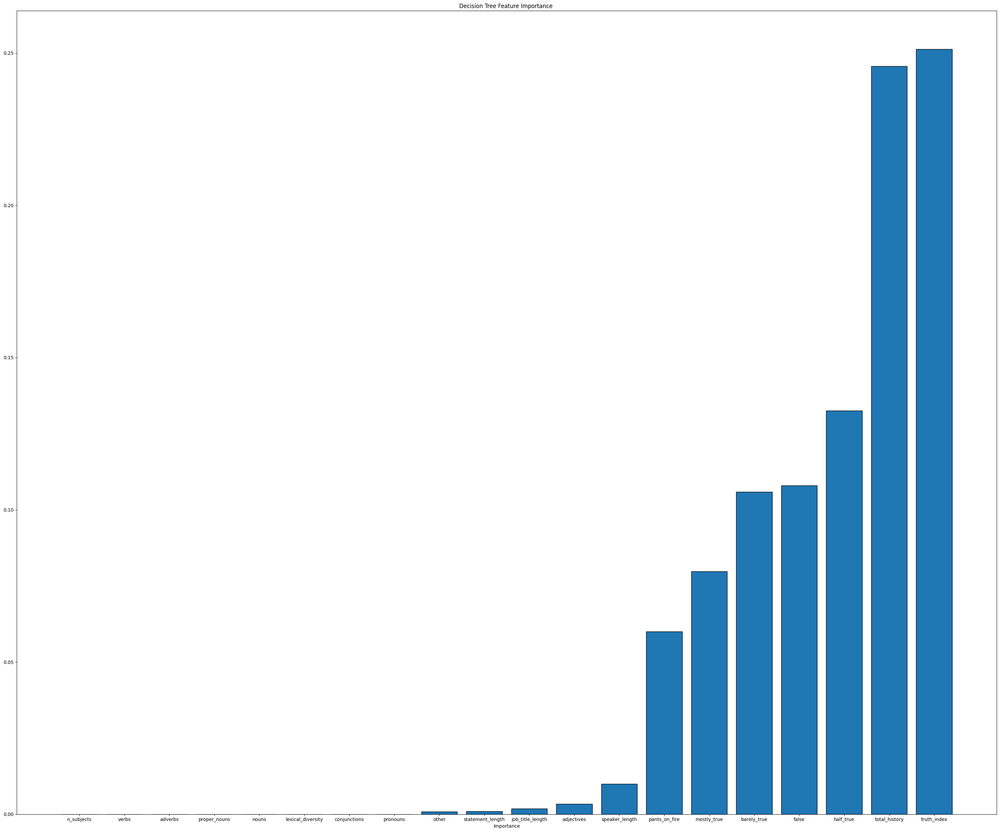

In [122]:
data['lexical_diversity'] = data['statement'].apply(calculate_lexical_diversity)
plot_tree_feature_importance(data)

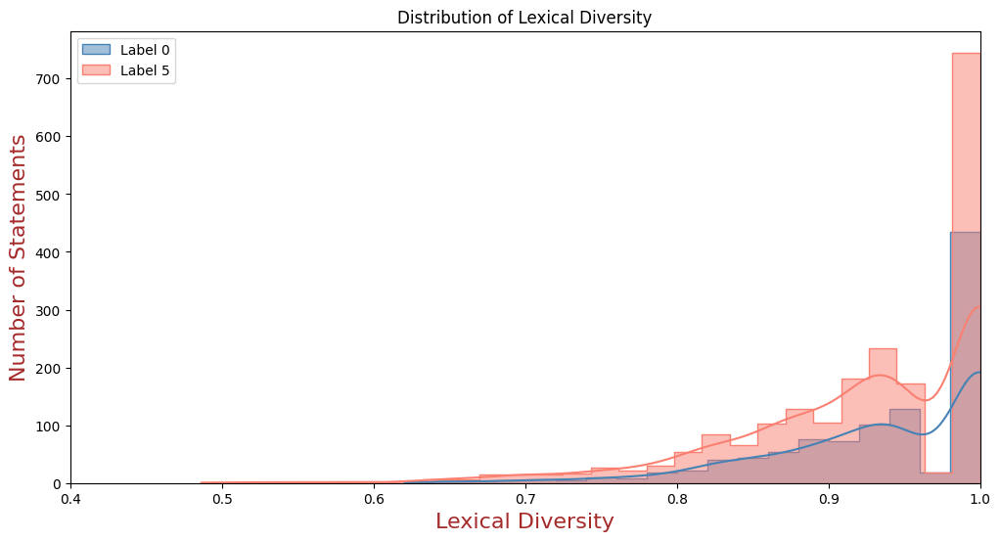

In [123]:
def plot_lexical_diversity(label1, label2):
    plt.figure(figsize = (12, 6))
    sns.histplot(data.loc[data['label'] == label1, 'lexical_diversity'], color = "steelblue", label = f"Label {label1}", kde=True, stat="count", element="step")
    sns.histplot(data.loc[data['label'] == label2, 'lexical_diversity'], color = "salmon", label = f"Label {label2}", kde=True, stat="count", element="step")

    plt.xlabel("Lexical Diversity", size = 16, color = "brown")
    plt.ylabel("Number of Statements", size = 16, color = "brown")
    plt.xlim((0.4, 1))

    plt.legend()

    plt.title("Distribution of Lexical Diversity")
plot_lexical_diversity(0, 5)

We see a very similar lexical diversity between pants-fire and true news, it doesnt seem to be a pattern.

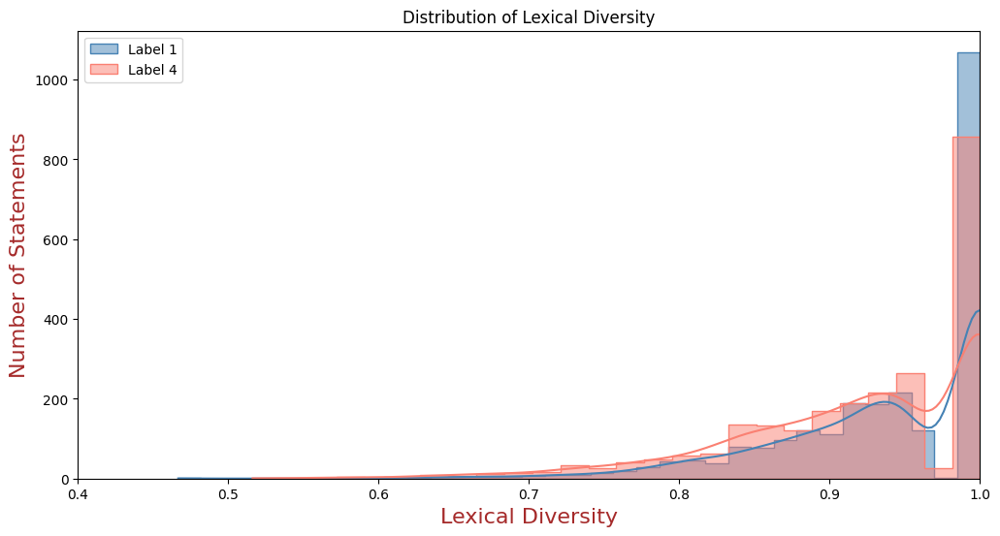

In [124]:
plot_lexical_diversity(1, 4)

A slightly better significance here.

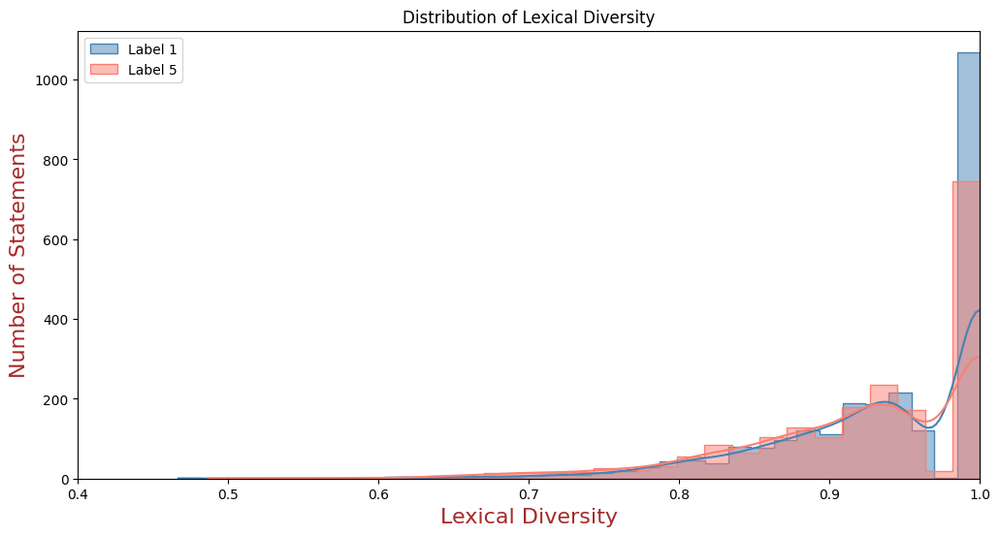

In [125]:
plot_lexical_diversity(1, 5)

Again, only slight signs of clear pattern.

## Sentiment analysis

Sentiment analysis is the process to determine the attitude, which is expressed in the text. This could give us a pattern existing in the different types of news. Source https://www.zignuts.com/blog/python-sentiment-analysis-nlp-guide

In [126]:
def calculate_sentiment(text):
    blob = TextBlob(str(text))
    return pd.Series({'sentiment_polarity': blob.sentiment.polarity, 'sentiment_subjectivity': blob.sentiment.subjectivity})

data[['sentiment_polarity', 'sentiment_subjectivity']] = data['statement'].apply(calculate_sentiment)


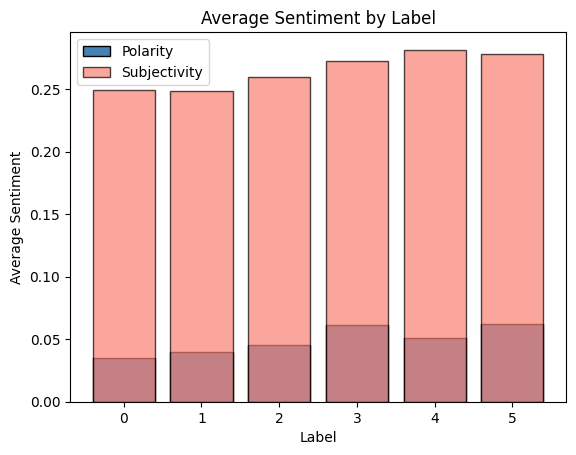

In [127]:
def plot_average_sentiment():
    for label in range(6):
        subset = data[data['label'] == label]
        avg_polarity = subset['sentiment_polarity'].mean()
        avg_subjectivity = subset['sentiment_subjectivity'].mean()
        plt.bar(label, avg_polarity, color='steelblue', edgecolor='black')
        plt.bar(label, avg_subjectivity, color='salmon', edgecolor='black', alpha=0.7)
    plt.xlabel('Label')
    plt.ylabel('Average Sentiment')
    plt.title('Average Sentiment by Label')
    plt.legend(['Polarity', 'Subjectivity'])
    plt.show()
plot_average_sentiment()

We see that news who are at least half-true jave both better polarity and subjectivity scores, so what we will stick with this feature. Let us now see what the current data looks like.

## Feature selection

In [128]:
data

,label,statement,job_title,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,n_subjects,...,nouns,verbs,adjectives,adverbs,pronouns,conjunctions,other,lexical_diversity,sentiment_polarity,sentiment_subjectivity
0,1,Says the Annies List political group supports ...,State representative,republican,0.0,0.0,0.0,0.0,0.0,1,...,0.333333,0.166667,0.083333,0.000000,0.000000,0.083333,0.166667,1.000000,0.000000,0.100000
1,3,When did the decline of coal start? It started...,State delegate,democrat,0.0,0.0,0.0,1.0,0.0,3,...,0.178571,0.178571,0.035714,0.000000,0.035714,0.107143,0.321429,0.928571,0.100000,0.400000
2,4,"Hillary Clinton agrees with John McCain ""by vo...",President,democrat,70.0,71.0,160.0,162.0,9.0,1,...,0.090909,0.136364,0.000000,0.000000,0.000000,0.181818,0.272727,0.954545,0.000000,0.000000
3,1,Health care reform legislation is likely to ma...,NaN,none,7.0,18.0,3.0,5.0,44.0,1,...,0.461538,0.153846,0.153846,0.000000,0.000000,0.000000,0.153846,1.000000,0.200000,0.900000
4,3,The economic turnaround started at the end of ...,NaN,democrat,15.0,9.0,19.0,19.0,2.0,2,...,0.272727,0.090909,0.090909,0.000000,0.090909,0.181818,0.272727,0.909091,0.200000,0.200000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,Governor,republican,28.0,23.0,37.0,34.0,7.0,1,...,0.428571,0.142857,0.071429,0.000000,0.071429,0.142857,0.142857,1.000000,0.000000,0.000000
12787,2,Ive been here almost every day.,Governor,democrat,1.0,0.0,0.0,1.0,0.0,3,...,0.142857,0.142857,0.000000,0.285714,0.000000,0.000000,0.285714,1.000000,0.000000,0.000000
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...","senior fellow, Foreign Policy Research Institute",other,0.0,0.0,0.0,0.0,0.0,4,...,0.173913,0.130435,0.130435,0.043478,0.000000,0.086957,0.260870,0.956522,-0.150000,0.500000
12789,2,Says an EPA permit languished under Strickland...,"Governor of Ohio as of Jan. 10, 2011",republican,8.0,8.0,10.0,18.0,3.0,2,...,0.157895,0.210526,0.052632,0.000000,0.105263,0.157895,0.157895,0.947368,0.136364,0.454545


We concluded that job_title only might be used with vectorizer. However let us see the missing values.

In [129]:
missing_values = data['job_title'].isna().sum()
print(f"Number of missing values in 'job_title': {missing_values}")

Number of missing values in 'job_title': 3568


Based on the importances of other columns, it might be better to remove it

In [130]:
data.drop(columns=['job_title'], inplace=True)
data

,label,statement,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,n_subjects,speaker_length,...,nouns,verbs,adjectives,adverbs,pronouns,conjunctions,other,lexical_diversity,sentiment_polarity,sentiment_subjectivity
0,1,Says the Annies List political group supports ...,republican,0.0,0.0,0.0,0.0,0.0,1,12,...,0.333333,0.166667,0.083333,0.000000,0.000000,0.083333,0.166667,1.000000,0.000000,0.100000
1,3,When did the decline of coal start? It started...,democrat,0.0,0.0,0.0,1.0,0.0,3,14,...,0.178571,0.178571,0.035714,0.000000,0.035714,0.107143,0.321429,0.928571,0.100000,0.400000
2,4,"Hillary Clinton agrees with John McCain ""by vo...",democrat,70.0,71.0,160.0,162.0,9.0,1,12,...,0.090909,0.136364,0.000000,0.000000,0.000000,0.181818,0.272727,0.954545,0.000000,0.000000
3,1,Health care reform legislation is likely to ma...,none,7.0,18.0,3.0,5.0,44.0,1,12,...,0.461538,0.153846,0.153846,0.000000,0.000000,0.000000,0.153846,1.000000,0.200000,0.900000
4,3,The economic turnaround started at the end of ...,democrat,15.0,9.0,19.0,19.0,2.0,2,13,...,0.272727,0.090909,0.090909,0.000000,0.090909,0.181818,0.272727,0.909091,0.200000,0.200000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,republican,28.0,23.0,37.0,34.0,7.0,1,10,...,0.428571,0.142857,0.071429,0.000000,0.071429,0.142857,0.142857,1.000000,0.000000,0.000000
12787,2,Ive been here almost every day.,democrat,1.0,0.0,0.0,1.0,0.0,3,9,...,0.142857,0.142857,0.000000,0.285714,0.000000,0.000000,0.285714,1.000000,0.000000,0.000000
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...",other,0.0,0.0,0.0,0.0,0.0,4,21,...,0.173913,0.130435,0.130435,0.043478,0.000000,0.086957,0.260870,0.956522,-0.150000,0.500000
12789,2,Says an EPA permit languished under Strickland...,republican,8.0,8.0,10.0,18.0,3.0,2,11,...,0.157895,0.210526,0.052632,0.000000,0.105263,0.157895,0.157895,0.947368,0.136364,0.454545


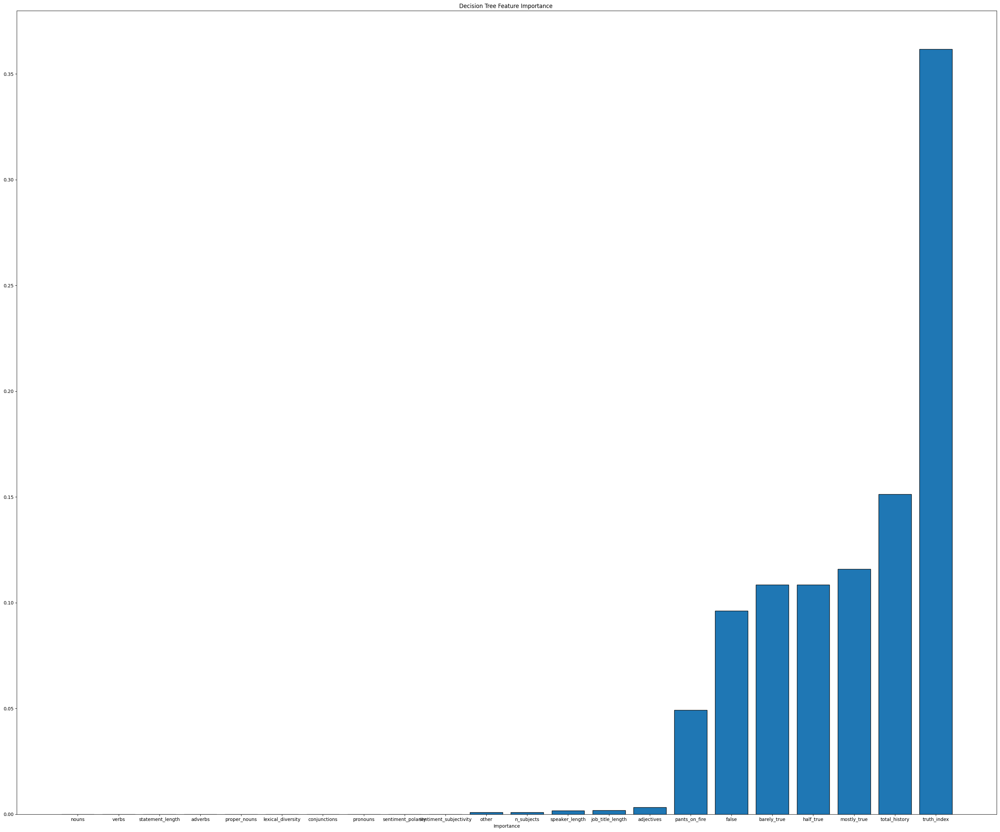

In [131]:
plot_tree_feature_importance(data)

We should see how random forest uses the features.

In [132]:
def best_random_forest(X, y, n_iter=20):
    params = {
        'n_estimators': [100, 200, 300],
        'max_depth': [None, 10, 12, 15, 20],
        'min_samples_split': [2, 5, 10],
        'min_samples_leaf': [1, 2],
    }

    rf = RandomForestClassifier(random_state=42)
    random_search = RandomizedSearchCV(estimator=rf, param_distributions=params,
                                       n_iter=n_iter,scoring = "f1_weighted", cv=5, verbose=2, random_state=42, n_jobs=-1)
    random_search.fit(X, y)

    print("Best Parameters:", random_search.best_params_)
    return random_search.best_estimator_

In [133]:
def plot_forest_feature_importance_with_f1(data, top_n=None):
    numeric_columns = data.select_dtypes(include=np.number).columns.tolist()
    X = data[numeric_columns].drop(columns=['label'], errors='ignore')
    y = data['label']
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    rf = best_random_forest(X_train, y_train, n_iter=5)
    y_pred = rf.predict(X_test)
    print("F1 Score:", f1_score(y_test, y_pred, average="weighted"))
    

    imp = pd.Series(rf.feature_importances_, index=X.columns).sort_values(ascending=True)
    imp_to_plot = imp if top_n is None else imp.tail(top_n)

    plt.figure(figsize=(10, 8))
    imp_to_plot.plot(kind='barh', color='skyblue', edgecolor='black')
    plt.title(f'F1 score = {f1_score(y_test, y_pred, average="weighted"):.4f} - Random Forest Feature Importance')
    plt.xlabel('Gini Importance')
    plt.show()

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best Parameters: {'n_estimators': 100, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': None}
F1 Score: 0.45563023213210413


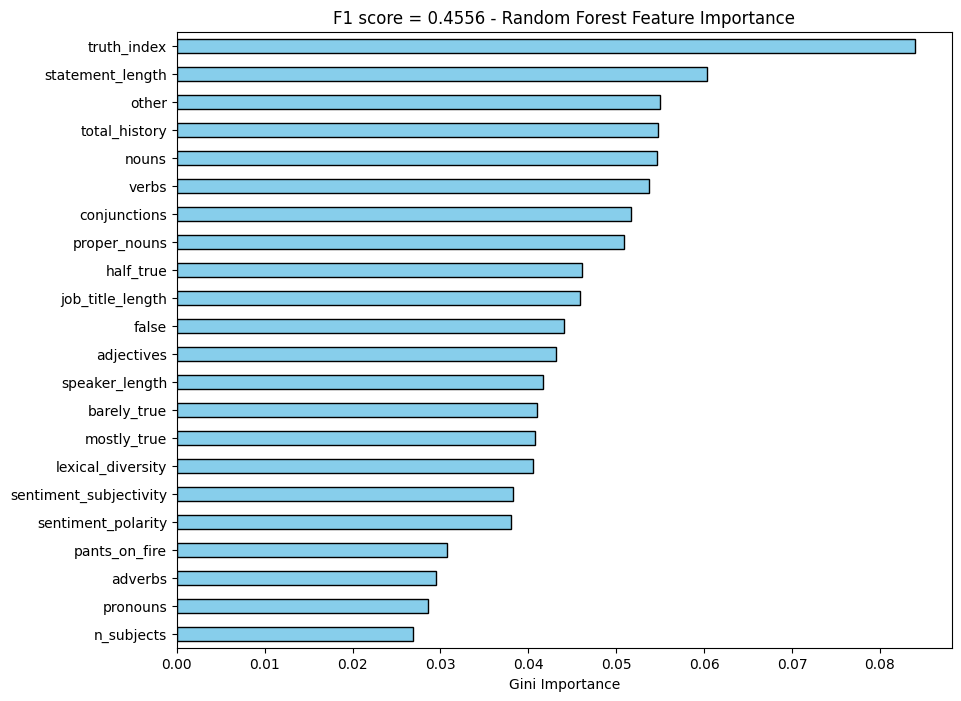

In [134]:
plot_forest_feature_importance_with_f1(data, top_n=30)

Using decision tree models we saw that the importance of n_subjects pronouns and adverbs were practically 0, now we see that they also have the lowest importance of all features. Lets see if we score higher f1 if we remove them.

In [135]:
temp_data = data.drop(columns = ['n_subjects', 'pronouns', 'adverbs'])
data

,label,statement,party_affiliation,barely_true,false,half_true,mostly_true,pants_on_fire,n_subjects,speaker_length,...,nouns,verbs,adjectives,adverbs,pronouns,conjunctions,other,lexical_diversity,sentiment_polarity,sentiment_subjectivity
0,1,Says the Annies List political group supports ...,republican,0.0,0.0,0.0,0.0,0.0,1,12,...,0.333333,0.166667,0.083333,0.000000,0.000000,0.083333,0.166667,1.000000,0.000000,0.100000
1,3,When did the decline of coal start? It started...,democrat,0.0,0.0,0.0,1.0,0.0,3,14,...,0.178571,0.178571,0.035714,0.000000,0.035714,0.107143,0.321429,0.928571,0.100000,0.400000
2,4,"Hillary Clinton agrees with John McCain ""by vo...",democrat,70.0,71.0,160.0,162.0,9.0,1,12,...,0.090909,0.136364,0.000000,0.000000,0.000000,0.181818,0.272727,0.954545,0.000000,0.000000
3,1,Health care reform legislation is likely to ma...,none,7.0,18.0,3.0,5.0,44.0,1,12,...,0.461538,0.153846,0.153846,0.000000,0.000000,0.000000,0.153846,1.000000,0.200000,0.900000
4,3,The economic turnaround started at the end of ...,democrat,15.0,9.0,19.0,19.0,2.0,2,13,...,0.272727,0.090909,0.090909,0.000000,0.090909,0.181818,0.272727,0.909091,0.200000,0.200000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,republican,28.0,23.0,37.0,34.0,7.0,1,10,...,0.428571,0.142857,0.071429,0.000000,0.071429,0.142857,0.142857,1.000000,0.000000,0.000000
12787,2,Ive been here almost every day.,democrat,1.0,0.0,0.0,1.0,0.0,3,9,...,0.142857,0.142857,0.000000,0.285714,0.000000,0.000000,0.285714,1.000000,0.000000,0.000000
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...",other,0.0,0.0,0.0,0.0,0.0,4,21,...,0.173913,0.130435,0.130435,0.043478,0.000000,0.086957,0.260870,0.956522,-0.150000,0.500000
12789,2,Says an EPA permit languished under Strickland...,republican,8.0,8.0,10.0,18.0,3.0,2,11,...,0.157895,0.210526,0.052632,0.000000,0.105263,0.157895,0.157895,0.947368,0.136364,0.454545


Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best Parameters: {'n_estimators': 100, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': None}
F1 Score: 0.4701912142029487


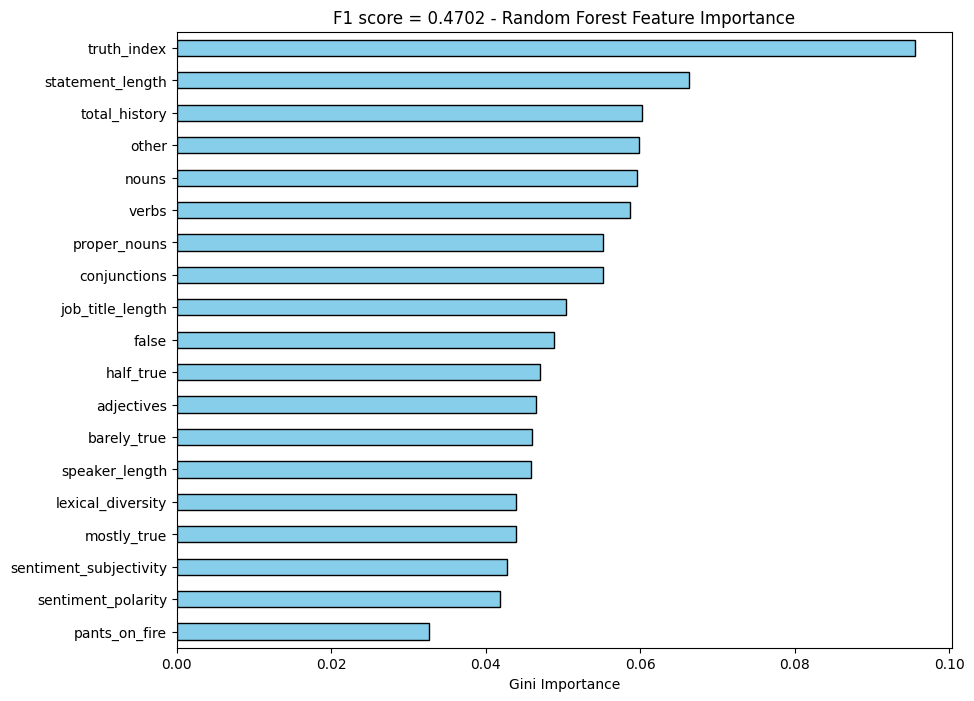

In [136]:

plot_forest_feature_importance_with_f1(temp_data, top_n=30)

We actually got a better result, so it may be better to drop the columns from the data. As initial numerical columns are highly correlated with truth_index and total_history, we should try with removing them 

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best Parameters: {'n_estimators': 100, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': None}
F1 Score: 0.3498883932181979


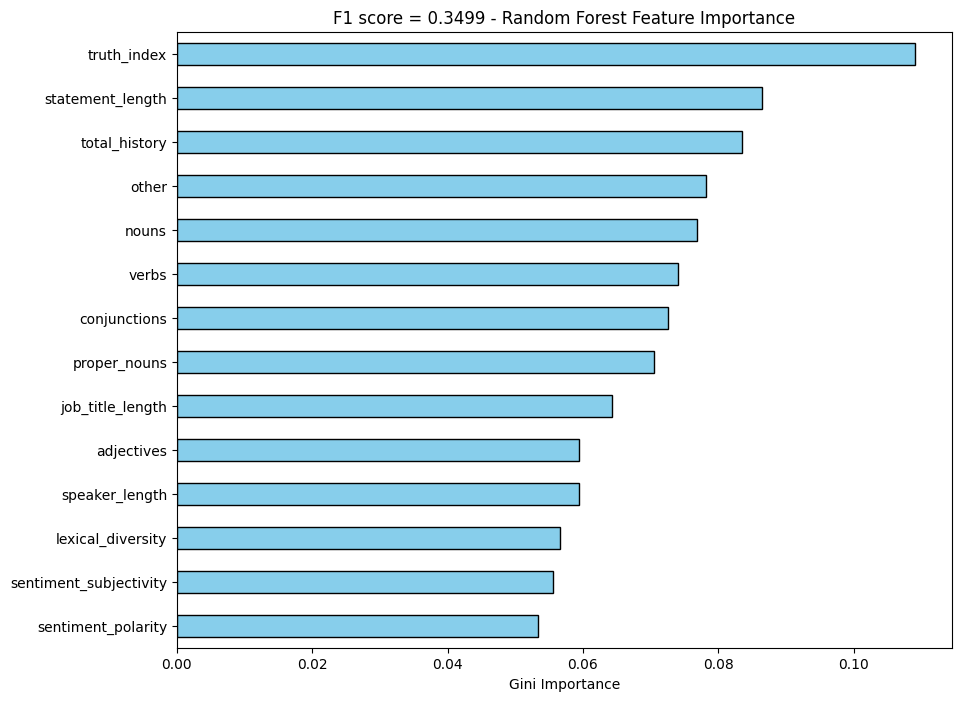

In [137]:
temp_data = temp_data.drop(columns = ['pants_on_fire', 'false', 'barely_true', 'half_true', 'mostly_true'])
plot_forest_feature_importance_with_f1(temp_data, top_n=30)


Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best Parameters: {'n_estimators': 100, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': None}
F1 Score: 0.3498883932181979


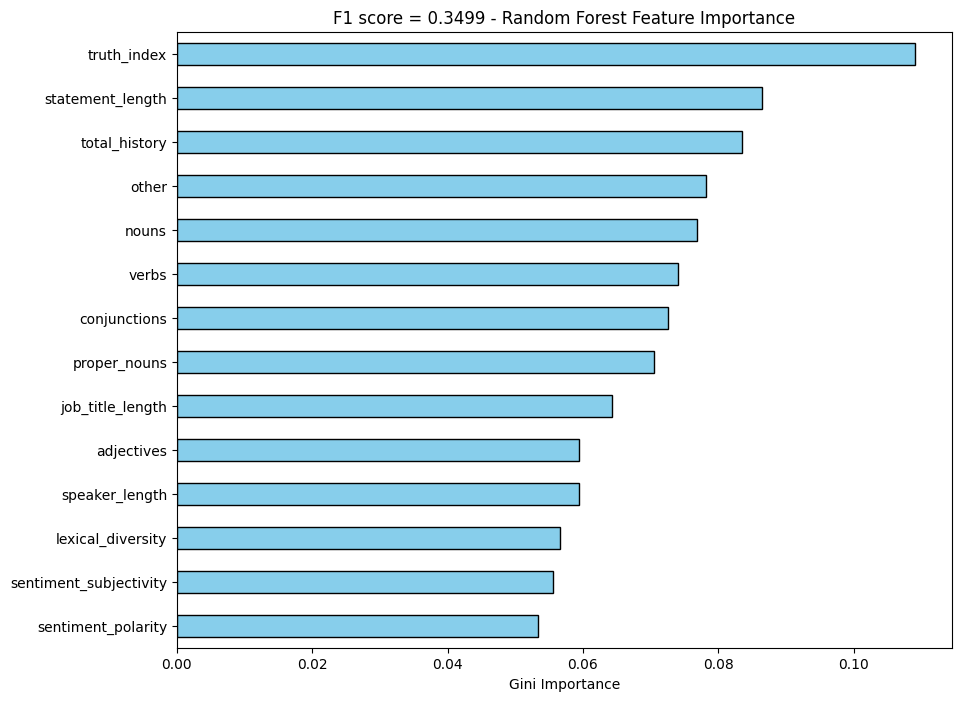

In [138]:
plot_forest_feature_importance_with_f1(temp_data, top_n=30)

We see a lot worse performance so these column should be there. But as we have total history, we may drop one, let say pants_on_fire

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best Parameters: {'n_estimators': 100, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': None}
F1 Score: 0.4737046779743052


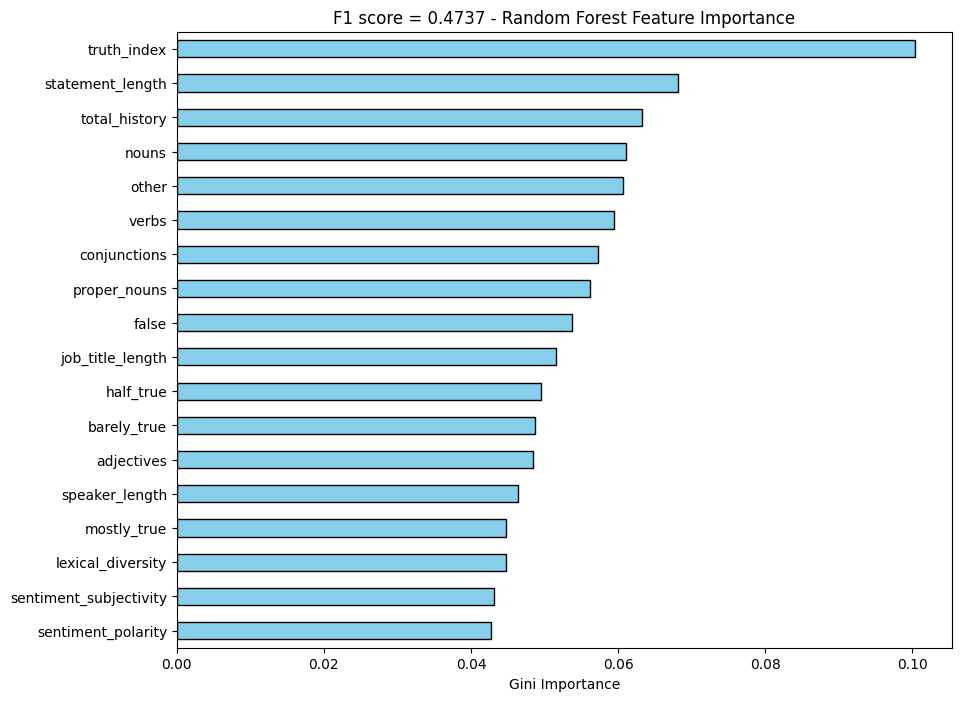

In [139]:
temp_data = data.drop(columns = ['n_subjects', 'pronouns', 'adverbs', 'pants_on_fire'])
plot_forest_feature_importance_with_f1(temp_data, top_n=30)

We see a better f1 score, pants_on_fire column wont be participating, let us see the correlations.

In [140]:
data.drop(columns = ['n_subjects', 'pronouns', 'adverbs', 'pants_on_fire'], inplace = True)

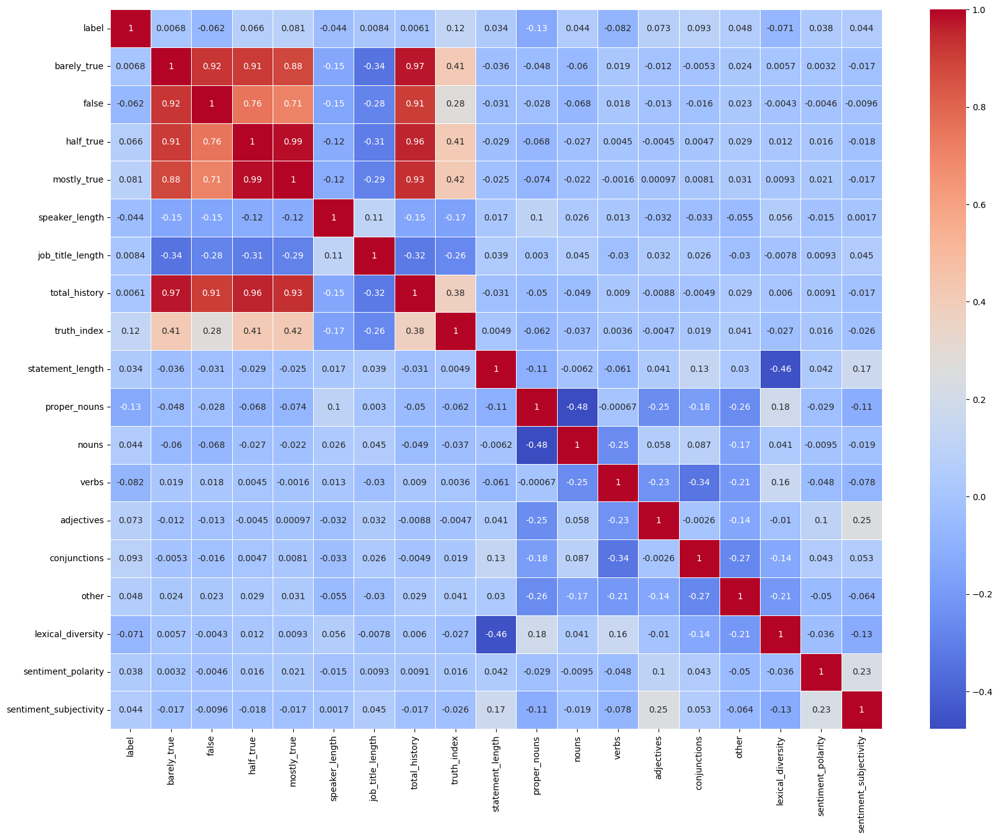

In [141]:
corr = data[data.select_dtypes(include=['number']).columns].corr()
plt.figure(figsize=(20, 15))
sns.heatmap(corr, annot=True, cmap="coolwarm", linewidths=0.5)
plt.show()


Should see how the category columns affect our model.

In [142]:
data

,label,statement,party_affiliation,barely_true,false,half_true,mostly_true,speaker_length,job_title_length,state_category,...,statement_length,proper_nouns,nouns,verbs,adjectives,conjunctions,other,lexical_diversity,sentiment_polarity,sentiment_subjectivity
0,1,Says the Annies List political group supports ...,republican,0.0,0.0,0.0,0.0,12,20.0,texas,...,82,0.166667,0.333333,0.166667,0.083333,0.083333,0.166667,1.000000,0.000000,0.100000
1,3,When did the decline of coal start? It started...,democrat,0.0,0.0,0.0,1.0,14,14.0,other,...,141,0.142857,0.178571,0.178571,0.035714,0.107143,0.321429,0.928571,0.100000,0.400000
2,4,"Hillary Clinton agrees with John McCain ""by vo...",democrat,70.0,71.0,160.0,162.0,12,9.0,illinois,...,105,0.318182,0.090909,0.136364,0.000000,0.181818,0.272727,0.954545,0.000000,0.000000
3,1,Health care reform legislation is likely to ma...,none,7.0,18.0,3.0,5.0,12,NaN,other,...,78,0.076923,0.461538,0.153846,0.153846,0.000000,0.153846,1.000000,0.200000,0.900000
4,3,The economic turnaround started at the end of ...,democrat,15.0,9.0,19.0,19.0,13,NaN,florida,...,54,0.000000,0.272727,0.090909,0.090909,0.181818,0.272727,0.909091,0.200000,0.200000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,republican,28.0,23.0,37.0,34.0,10,8.0,florida,...,82,0.000000,0.428571,0.142857,0.071429,0.142857,0.142857,1.000000,0.000000,0.000000
12787,2,Ive been here almost every day.,democrat,1.0,0.0,0.0,1.0,9,8.0,other,...,31,0.142857,0.142857,0.142857,0.000000,0.000000,0.285714,1.000000,0.000000,0.000000
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...",other,0.0,0.0,0.0,0.0,21,48.0,other,...,147,0.173913,0.173913,0.130435,0.130435,0.086957,0.260870,0.956522,-0.150000,0.500000
12789,2,Says an EPA permit languished under Strickland...,republican,8.0,8.0,10.0,18.0,11,36.0,ohio,...,96,0.157895,0.157895,0.210526,0.052632,0.157895,0.157895,0.947368,0.136364,0.454545


In [143]:
data.columns

Index(['label', 'statement', 'party_affiliation', 'barely_true', 'false',
       'half_true', 'mostly_true', 'speaker_length', 'job_title_length',
       'state_category', 'total_history', 'truth_index', 'context_group',
       'statement_length', 'proper_nouns', 'nouns', 'verbs', 'adjectives',
       'conjunctions', 'other', 'lexical_diversity', 'sentiment_polarity',
       'sentiment_subjectivity'],
      dtype='object')

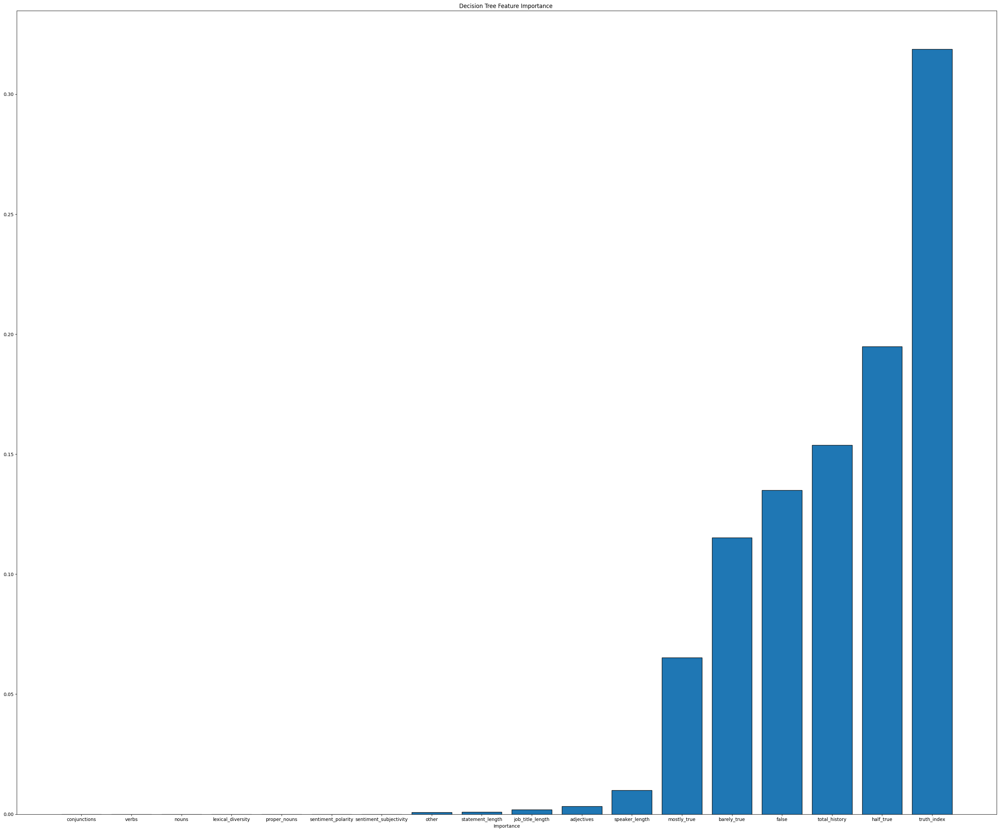

In [144]:
plot_tree_feature_importance(data)

We will remove conjuctions, verbs and nouns to see how the random forest model performs.

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best Parameters: {'n_estimators': 100, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': None}
F1 Score: 0.4891674439439342


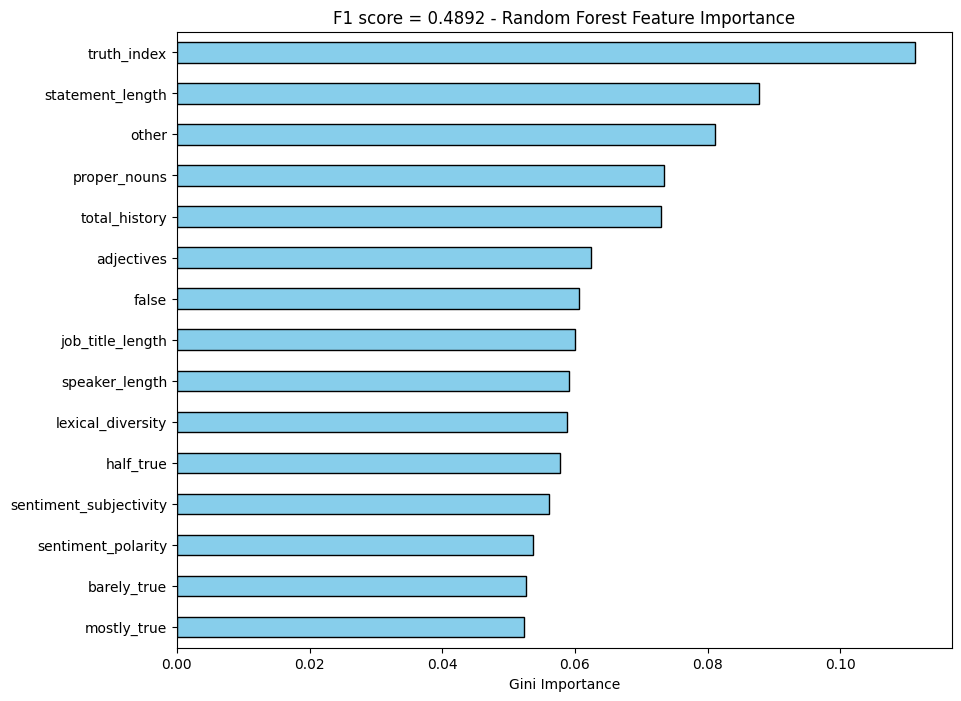

In [145]:
temp_data = data.drop(columns=['conjunctions', 'verbs', 'nouns'])
plot_forest_feature_importance_with_f1(temp_data, top_n=30)

We now should try remove mostly_true and barely_true, because they are highly correlated with truth_index and total_history.

In [146]:
temp_data = temp_data.drop(columns=['mostly_true', 'barely_true'])


Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best Parameters: {'n_estimators': 100, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': None}
F1 Score: 0.46191337111634856


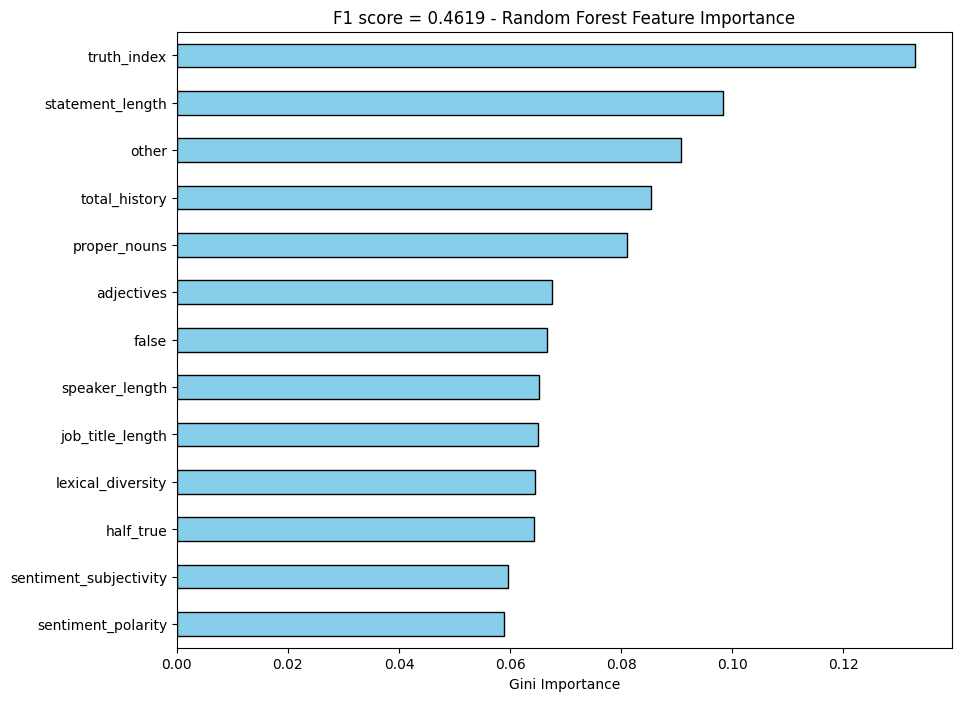

In [147]:
plot_forest_feature_importance_with_f1(temp_data, top_n=30)

We got worse result, so we shouldnt remove more from these columns. Maybe we should try the sentiment columns

In [148]:
temp_data = data.drop(columns=['conjunctions', 'verbs', 'nouns', 'sentiment_polarity', 'sentiment_subjectivity'])

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best Parameters: {'n_estimators': 100, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': None}
F1 Score: 0.5251909143591275


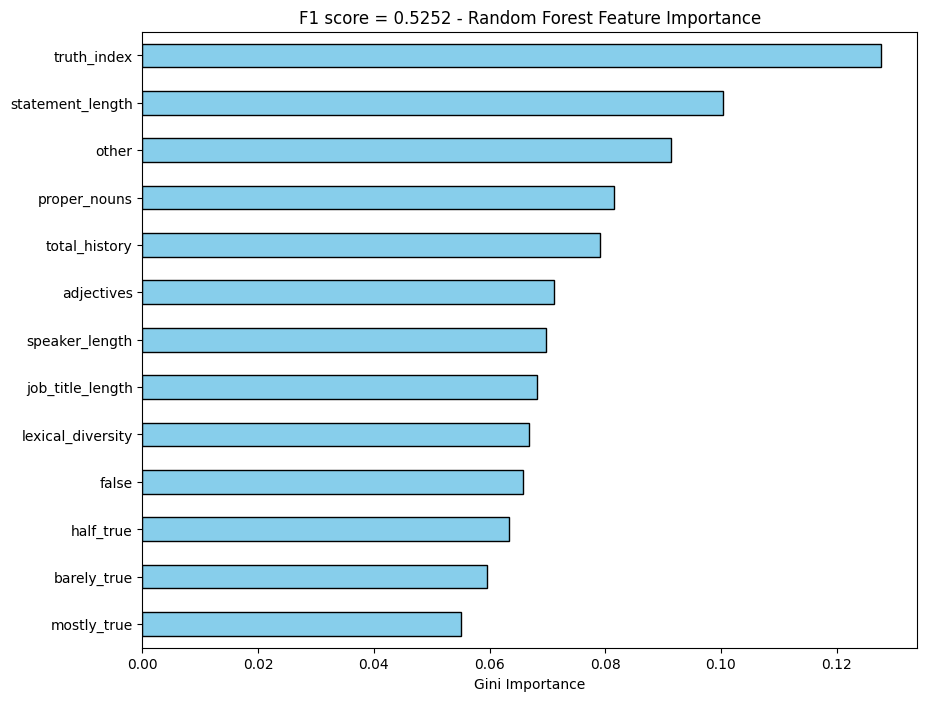

In [149]:
plot_forest_feature_importance_with_f1(temp_data, top_n=30)

We got a much higher result here, let us once again try to remove the last column.

In [150]:
temp_data = temp_data.drop(columns = ['mostly_true'])

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best Parameters: {'n_estimators': 100, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': None}
F1 Score: 0.5209050925007888


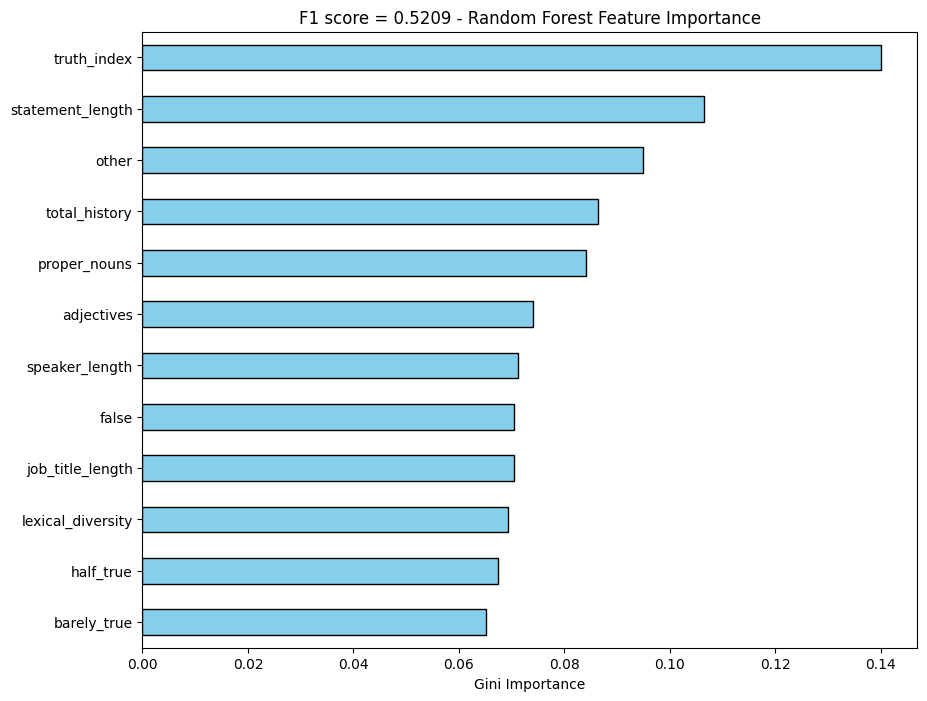

In [151]:
plot_forest_feature_importance_with_f1(temp_data, top_n=30)

Worse results, once again...

So what we have till now is:

In [152]:
data.drop(columns=['conjunctions', 'verbs', 'nouns', 'sentiment_polarity', 'sentiment_subjectivity'], inplace=True)

In [153]:
data

,label,statement,party_affiliation,barely_true,false,half_true,mostly_true,speaker_length,job_title_length,state_category,total_history,truth_index,context_group,statement_length,proper_nouns,adjectives,other,lexical_diversity
0,1,Says the Annies List political group supports ...,republican,0.0,0.0,0.0,0.0,12,20.0,texas,0.0,0.000000,campaign_ads,82,0.166667,0.083333,0.166667,1.000000
1,3,When did the decline of coal start? It started...,democrat,0.0,0.0,0.0,1.0,14,14.0,other,1.0,0.400000,live,141,0.142857,0.035714,0.321429,0.928571
2,4,"Hillary Clinton agrees with John McCain ""by vo...",democrat,70.0,71.0,160.0,162.0,12,9.0,illinois,472.0,0.566173,other,105,0.318182,0.000000,0.272727,0.954545
3,1,Health care reform legislation is likely to ma...,none,7.0,18.0,3.0,5.0,12,NaN,other,77.0,0.156410,official,78,0.076923,0.153846,0.153846,1.000000
4,3,The economic turnaround started at the end of ...,democrat,15.0,9.0,19.0,19.0,13,NaN,florida,64.0,0.529231,broadcast,54,0.000000,0.090909,0.272727,0.909091
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,republican,28.0,23.0,37.0,34.0,10,8.0,florida,129.0,0.501538,live,82,0.000000,0.071429,0.142857,1.000000
12787,2,Ive been here almost every day.,democrat,1.0,0.0,0.0,1.0,9,8.0,other,2.0,0.400000,broadcast,31,0.142857,0.000000,0.285714,1.000000
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...",other,0.0,0.0,0.0,0.0,21,48.0,other,0.0,0.000000,other,147,0.173913,0.130435,0.260870,0.956522
12789,2,Says an EPA permit languished under Strickland...,republican,8.0,8.0,10.0,18.0,11,36.0,ohio,47.0,0.525000,live,96,0.157895,0.052632,0.157895,0.947368


We will now see the categorical columns

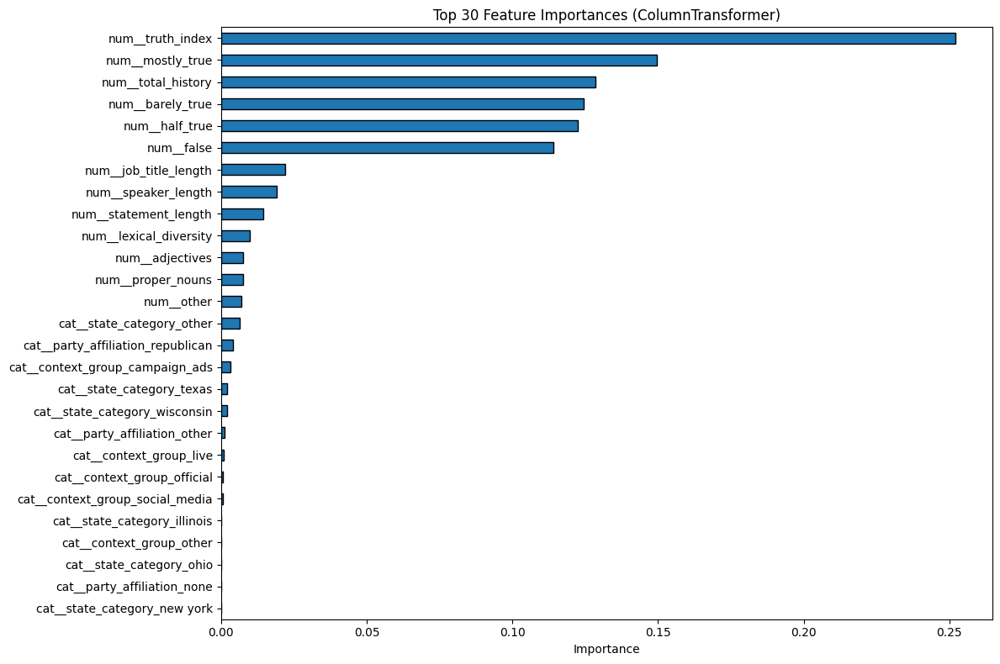

In [154]:
plot_tree_feature_importance_non_numeric_multiple_cols(data, ['state_category', 'party_affiliation', 'context_group'])

In [155]:
def plot_forest_feature_importance_with_f1(data, top_n=None):
    transformer = ColumnTransformer(
        transformers=[
            ('state_category', OneHotEncoder(handle_unknown='ignore', drop='first'), ['state_category']),
            ('party_affiliation', OneHotEncoder(handle_unknown='ignore', drop='first'), ['party_affiliation']),
            ('context_group', OneHotEncoder(handle_unknown='ignore', drop='first'), ['context_group']),
        ],
        remainder='passthrough',
    )
    temp_data = transformer.fit_transform(data.drop(columns=['label', 'statement']))
    feature_names = transformer.get_feature_names_out()
    X = pd.DataFrame(temp_data, columns=feature_names)
    y = data['label']
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    rf = best_random_forest(X_train, y_train, n_iter=5)
    y_pred = rf.predict(X_test)
    print("F1 Score:", f1_score(y_test, y_pred, average="weighted"))
    

    imp = pd.Series(rf.feature_importances_, index=X.columns).sort_values(ascending=True)
    imp_to_plot = imp if top_n is None else imp.tail(top_n)

    plt.figure(figsize=(10, 8))
    imp_to_plot.plot(kind='barh', color='skyblue', edgecolor='black')
    plt.title(f'F1 score = {f1_score(y_test, y_pred, average="weighted"):.4f} - Random Forest Feature Importance')
    plt.xlabel('Gini Importance')
    plt.show()

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best Parameters: {'n_estimators': 100, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': None}
F1 Score: 0.5411723337510936


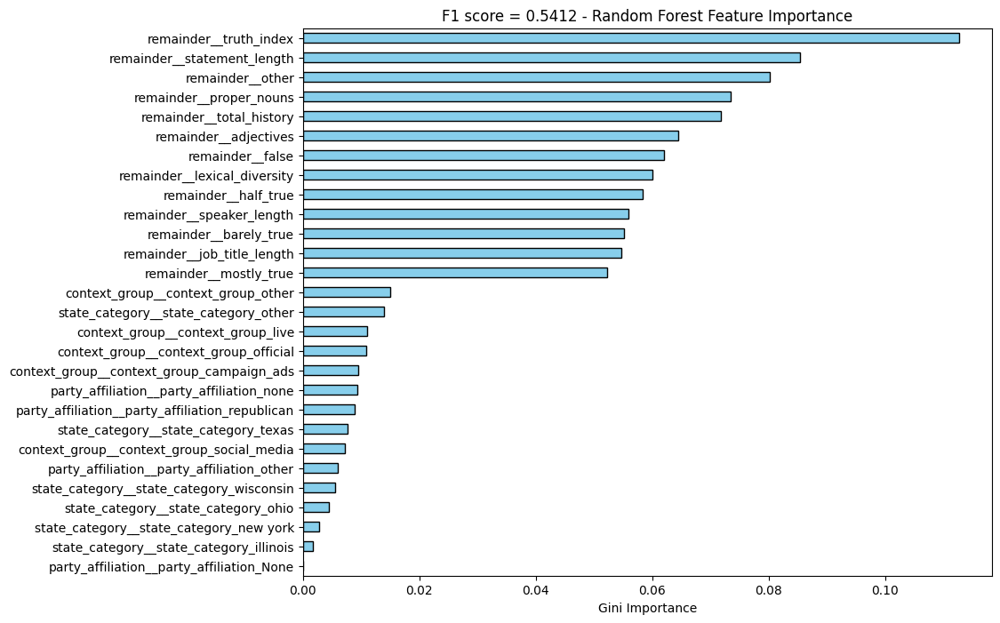

In [156]:
plot_forest_feature_importance_with_f1(data, top_n=30)

We get better results, let us see the low contributing features.

Let us see the party affiliation column

In [157]:
s = data["party_affiliation"]

data["party_affiliation"] = (
    s.fillna("other")               
     .astype(str)
     .str.strip()
     .str.lower()                     
     .replace({"none": "other", "nan": "other"})
)

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best Parameters: {'n_estimators': 100, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': None}
F1 Score: 0.5476344997560526


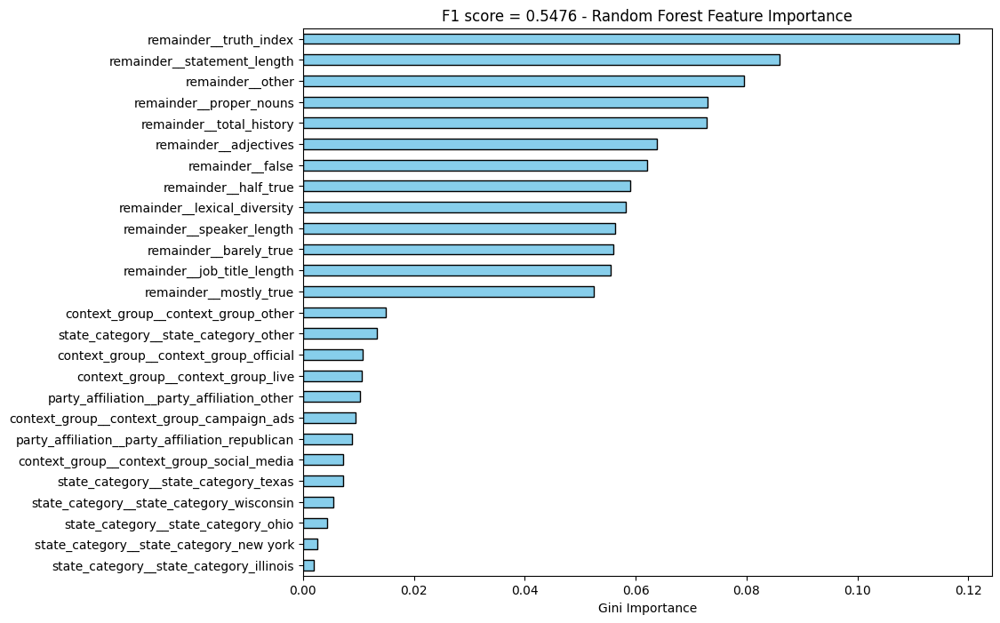

In [158]:
plot_forest_feature_importance_with_f1(data, top_n=30)

So this is how the data will remain, we can save the data as processed data 

In [159]:
data

,label,statement,party_affiliation,barely_true,false,half_true,mostly_true,speaker_length,job_title_length,state_category,total_history,truth_index,context_group,statement_length,proper_nouns,adjectives,other,lexical_diversity
0,1,Says the Annies List political group supports ...,republican,0.0,0.0,0.0,0.0,12,20.0,texas,0.0,0.000000,campaign_ads,82,0.166667,0.083333,0.166667,1.000000
1,3,When did the decline of coal start? It started...,democrat,0.0,0.0,0.0,1.0,14,14.0,other,1.0,0.400000,live,141,0.142857,0.035714,0.321429,0.928571
2,4,"Hillary Clinton agrees with John McCain ""by vo...",democrat,70.0,71.0,160.0,162.0,12,9.0,illinois,472.0,0.566173,other,105,0.318182,0.000000,0.272727,0.954545
3,1,Health care reform legislation is likely to ma...,other,7.0,18.0,3.0,5.0,12,NaN,other,77.0,0.156410,official,78,0.076923,0.153846,0.153846,1.000000
4,3,The economic turnaround started at the end of ...,democrat,15.0,9.0,19.0,19.0,13,NaN,florida,64.0,0.529231,broadcast,54,0.000000,0.090909,0.272727,0.909091
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12786,3,Says his budget provides the highest state fun...,republican,28.0,23.0,37.0,34.0,10,8.0,florida,129.0,0.501538,live,82,0.000000,0.071429,0.142857,1.000000
12787,2,Ive been here almost every day.,democrat,1.0,0.0,0.0,1.0,9,8.0,other,2.0,0.400000,broadcast,31,0.142857,0.000000,0.285714,1.000000
12788,2,"In the early 1980s, Sen. Edward Kennedy secret...",other,0.0,0.0,0.0,0.0,21,48.0,other,0.0,0.000000,other,147,0.173913,0.130435,0.260870,0.956522
12789,2,Says an EPA permit languished under Strickland...,republican,8.0,8.0,10.0,18.0,11,36.0,ohio,47.0,0.525000,live,96,0.157895,0.052632,0.157895,0.947368


In [160]:
# out_path = r"d:\ML\Fake News Detection\data\liar_processed.csv"
# data.to_csv(out_path, index=False)

In [ ]:
# da = DataAudit(data.drop(columns = ['statement']), name = 'preprocessed_data_audit.xlsx')
# da.create_data_audit()

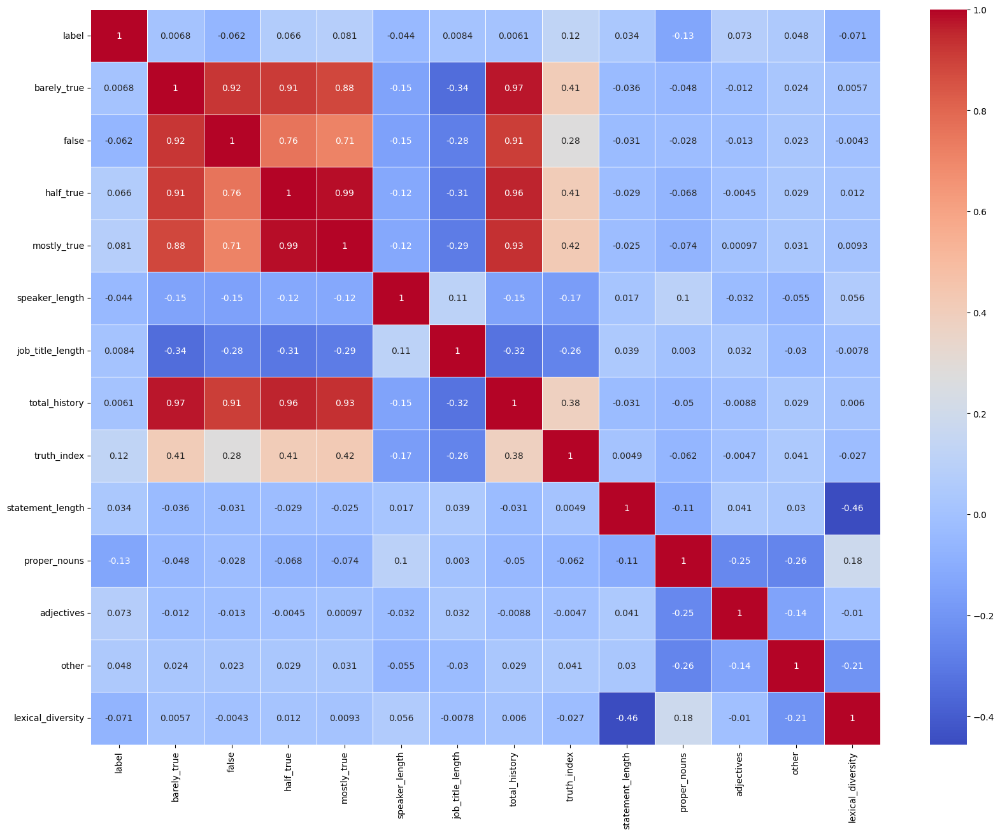

In [163]:
plt.figure(figsize=(20, 15))
sns.heatmap(data[data.select_dtypes(include=['float64', 'int64']).columns].corr(), annot=True, cmap="coolwarm", linewidths=0.5)
plt.show()

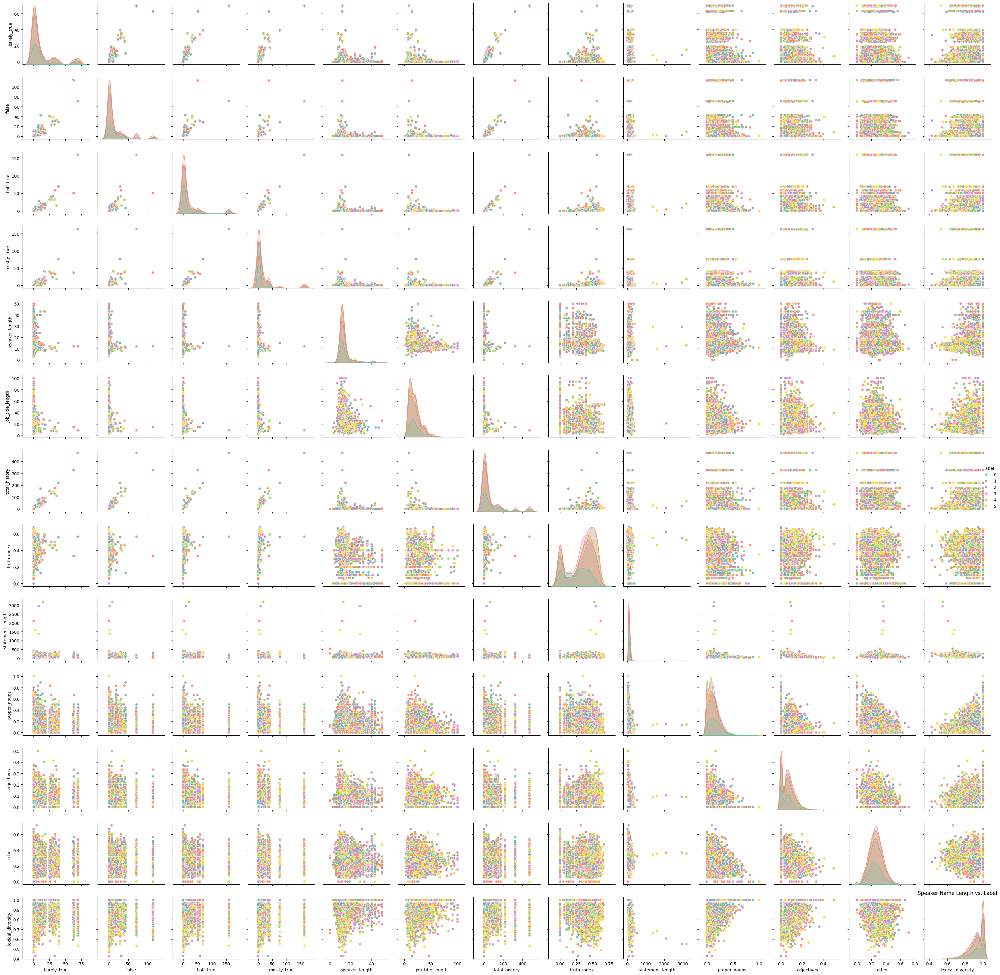

In [166]:
numeric_columns = data.select_dtypes(include=np.number).columns.tolist()
sns.pairplot(data[numeric_columns], hue='label', palette='Set2')
plt.title("Speaker Name Length vs. Label")
plt.xlabel("Speaker Name Length")
plt.ylabel("Label")
plt.tight_layout()